## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-outdoor' 
TRANSFORM = 'gabor'
CHANNEL = 'blue'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
blue_gabor_outdoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/outdoor/gabor/blue'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 65536000,
 1: 65536000,
 2: 65536000,
 3: 65536000,
 4: 65536000,
 5: 65536000,
 6: 65536000,
 7: 65536000,
 8: 65536000,
 9: 65536000,
 10: 65536000,
 11: 65536000,
 12: 65536000,
 13: 65536000,
 14: 65536000,
 15: 65536000,
 16: 65536000,
 17: 65536000,
 18: 65536000,
 19: 65536000,
 20: 65536000,
 21: 65536000,
 22: 65536000,
 23: 65536000,
 24: 65536000,
 25: 65536000,
 26: 65536000,
 27: 65536000,
 28: 65536000,
 29: 65536000,
 30: 65536000,
 31: 65536000,
 32: 65536000,
 33: 65536000,
 34: 65536000,
 35: 65536000,
 36: 65536000,
 37: 65536000,
 38: 65536000,
 39: 65536000,
 40: 65536000,
 41: 65536000}

Running 12760 CDFs


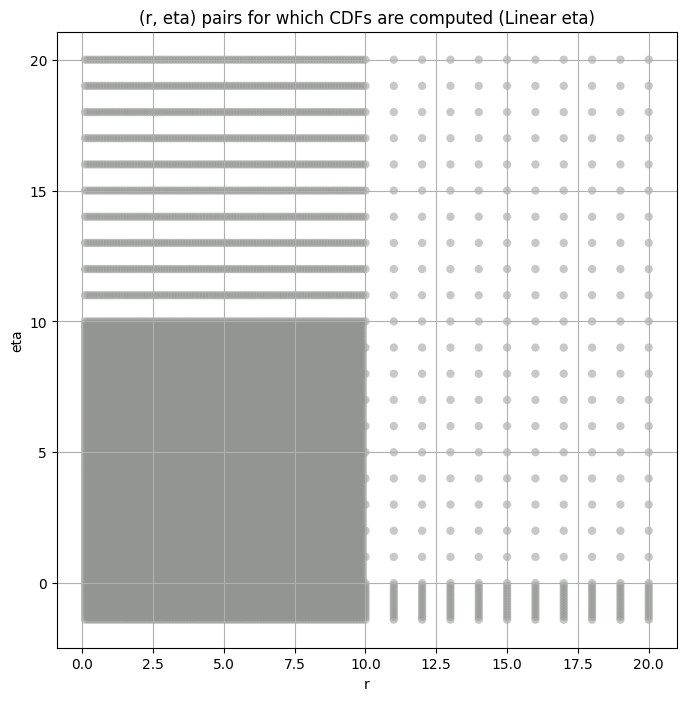

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,53297.16400,41834.84000,64967.58000,4.950205,3.020211,9.423482,65536000.0,"(2.0, 0.5, 0.044)"
1,19036.11300,14767.14500,24366.29900,6.551415,3.960084,13.359611,65536000.0,"(2.0, 0.5, 0.065)"
2,7753.15700,6039.07570,9856.43900,7.599971,4.060136,17.624750,65536000.0,"(2.0, 0.5, 0.096)"
3,3045.21600,2303.25980,3915.39140,8.890267,4.886585,21.868956,65536000.0,"(2.0, 0.5, 0.141)"
4,1302.08530,960.97577,1655.82240,9.619346,5.580533,23.162615,65536000.0,"(2.0, 0.5, 0.208)"
5,512.79870,374.28460,667.93590,11.261219,6.061162,26.931730,65536000.0,"(2.0, 0.5, 0.306)"
6,354.43408,261.12814,466.77124,10.453091,5.964695,24.643680,65536000.0,"(2.0, 0.5, 0.45)"
7,72789.00000,58219.42000,91857.51000,6.210428,3.580646,12.645504,65536000.0,"(2.0, 1.0, 0.044)"
8,27265.47300,20917.25000,34807.19000,7.633041,4.059375,18.132977,65536000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,53297.16400,53297.164062,51503.152344,50279.046875,48264.152344
1,19036.11300,19036.113281,18292.962891,17780.693359,16937.876953
2,7753.15700,7753.157227,7408.330078,7181.881836,6812.319824
3,3045.21600,3045.216064,2895.647705,2795.673584,2633.981934
4,1302.08530,1302.085327,1234.152344,1189.896240,1119.972168
5,512.79870,512.798706,484.280914,465.032410,433.826721
6,354.43408,354.434082,335.314606,322.725647,302.265656
7,72789.00000,72789.000000,69878.250000,67856.890625,64563.570312
8,27265.47300,27265.472656,26009.058594,25158.789062,23816.746094


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.007344759838923867 53297.164


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.00930407434191989 51503.152


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.009707085654965641 50279.047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.01015472505242071 48264.152
Number of samples: 100000, Without approximation : 65536000.0


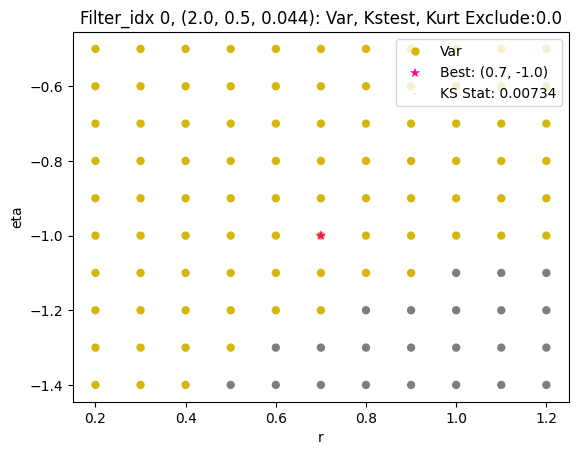

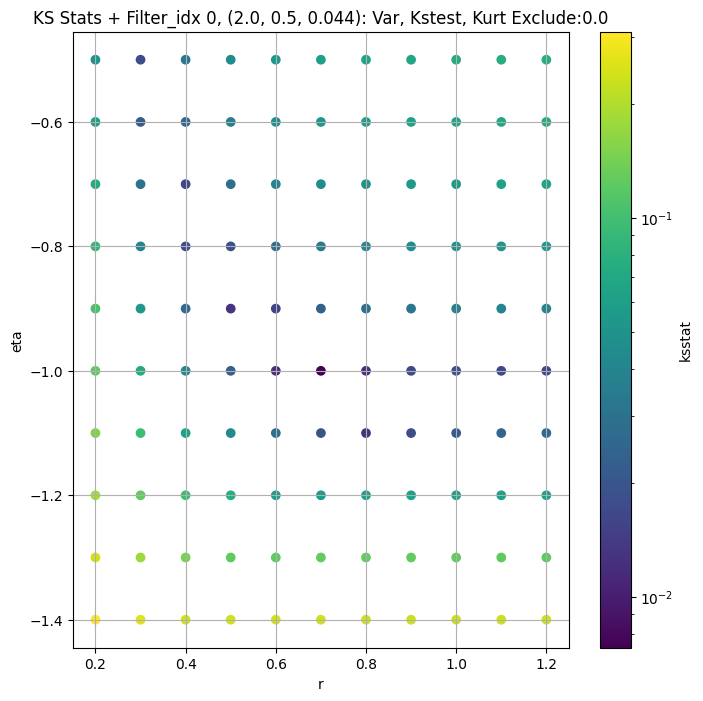

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.004738537305728374 19036.113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.005186819120484187 18292.963


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.005430881166126916 17780.693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.00684112487774835 16937.877
Number of samples: 100000, Without approximation : 65536000.0


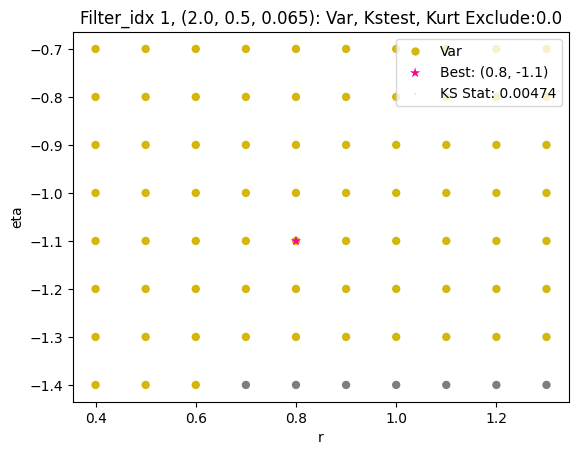

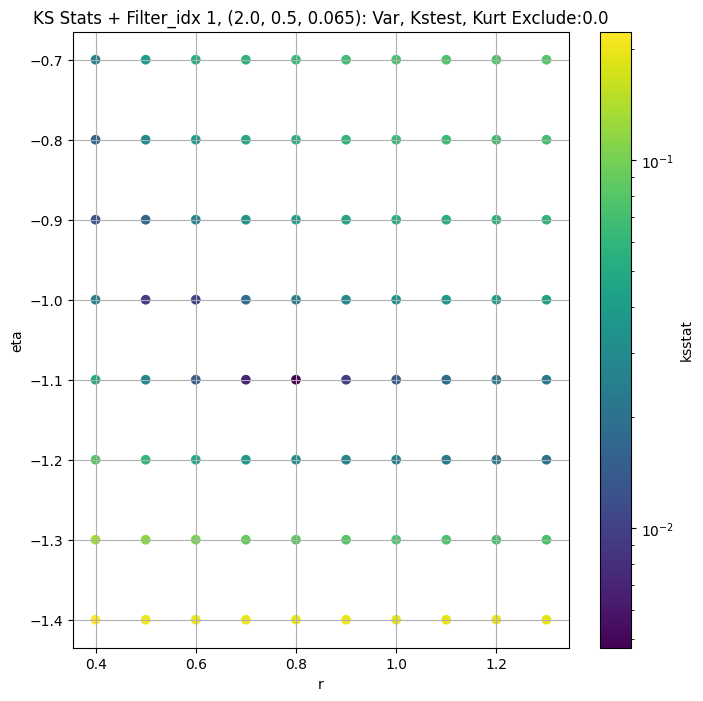

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.006518603661601841 7753.157


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.005936143924538839 7408.33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.006305547166516878 7181.882


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.005867865987462979 6812.32
Number of samples: 100000, Without approximation : 65536000.0


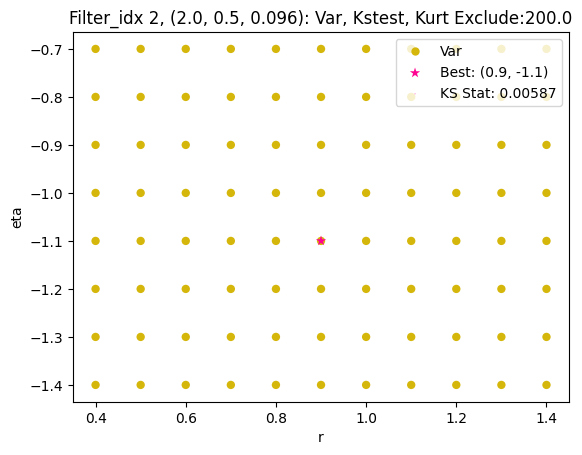

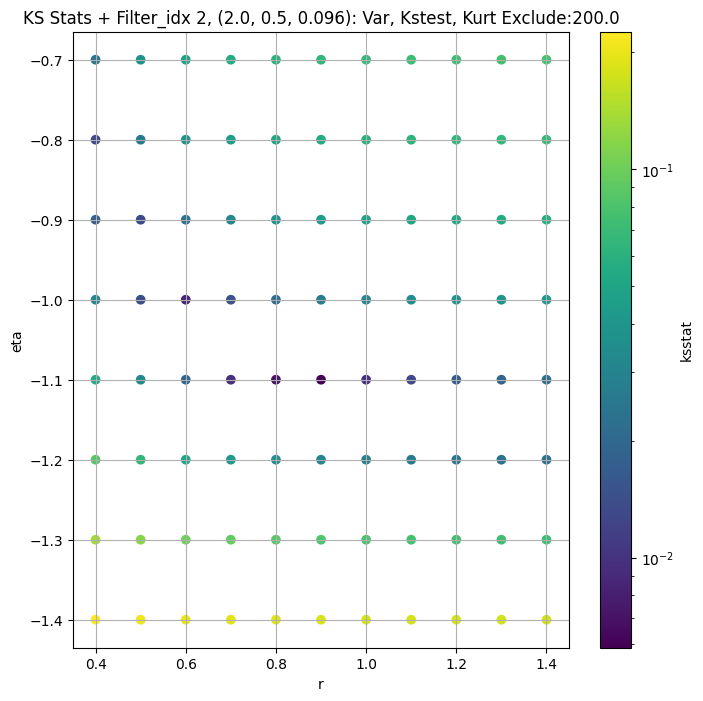

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.005628712878655684 3045.216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.004143303114852004 2895.6477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.004842811111792231 2795.6736


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.006096718680427493 2633.982
Number of samples: 100000, Without approximation : 65536000.0


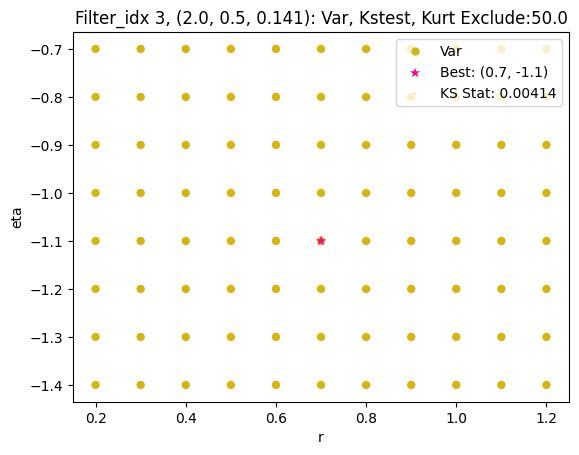

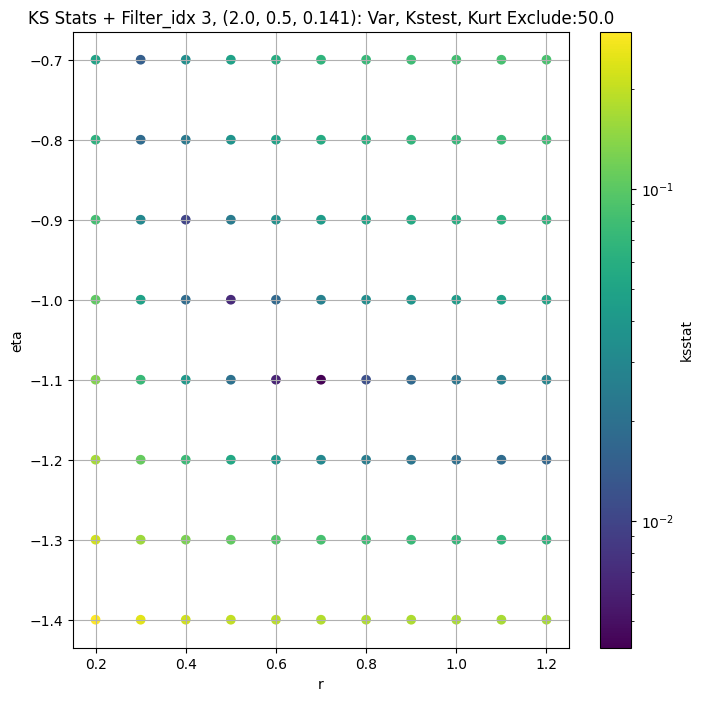

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.004263212920224579 1302.0853


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.004262757093185632 1234.1523


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.005541114093596929 1189.8962


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.0060788428940925995 1119.9722
Number of samples: 100000, Without approximation : 65536000.0


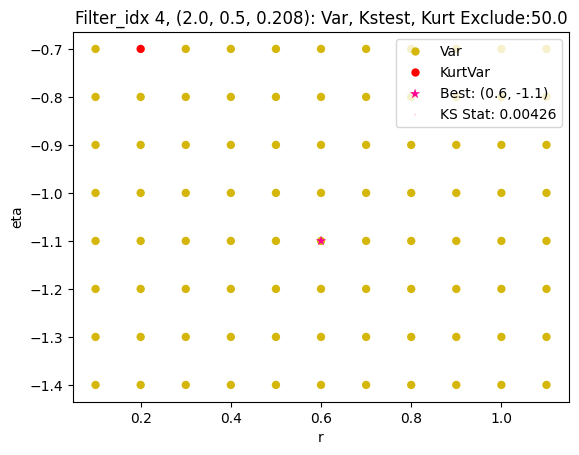

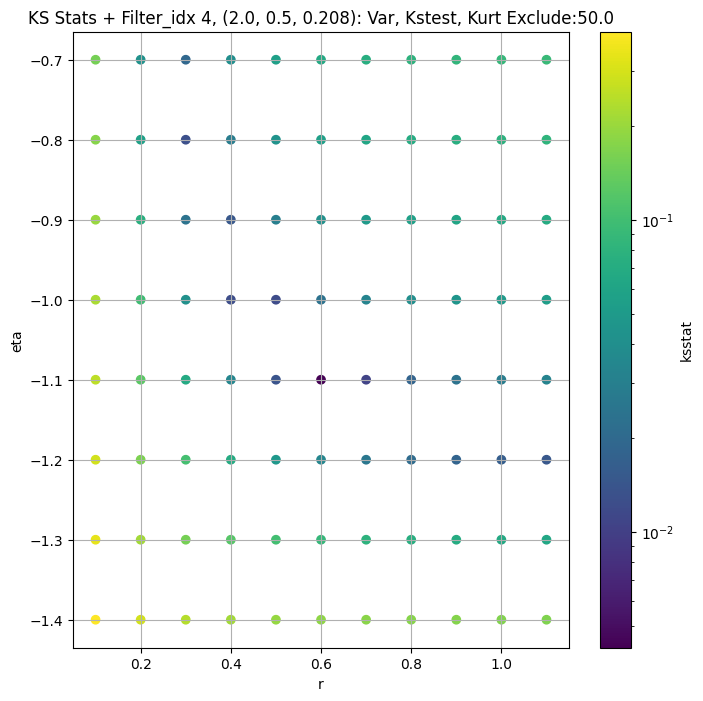

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.00948478558893473 512.7987


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.009484053810278614 484.2809


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.009483522276752865 465.0324


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.009482586526399994 433.82672
Number of samples: 100000, Without approximation : 65536000.0


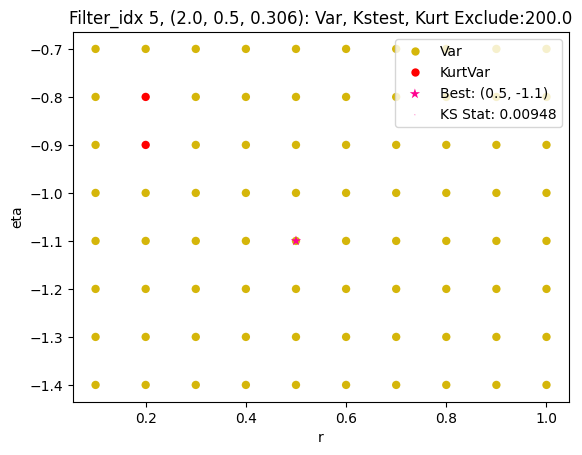

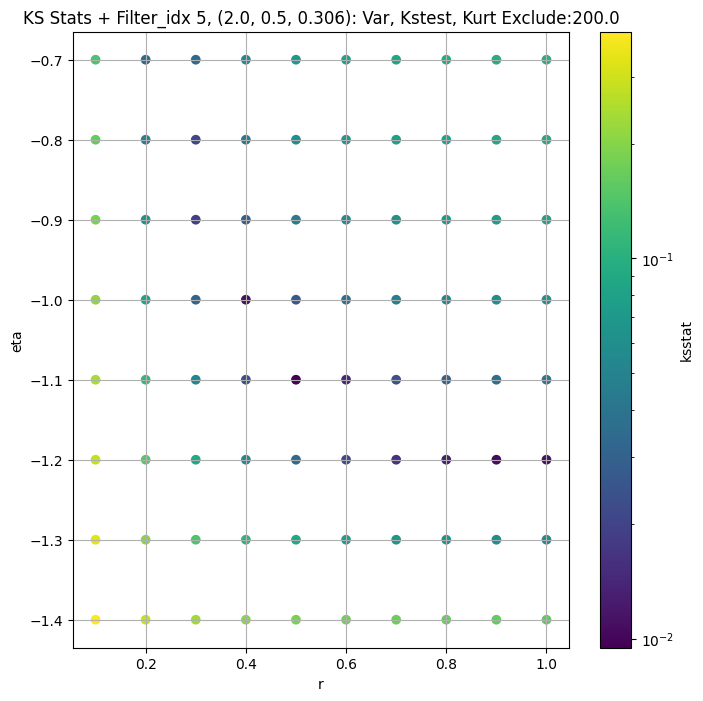

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.010529254222263806 354.43408


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.010434157226108964 335.3146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.010333717780473872 322.72565


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.010362418236602222 302.26566
Number of samples: 100000, Without approximation : 65536000.0


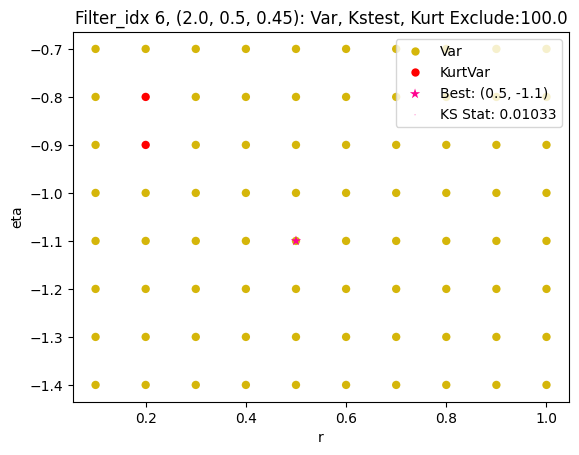

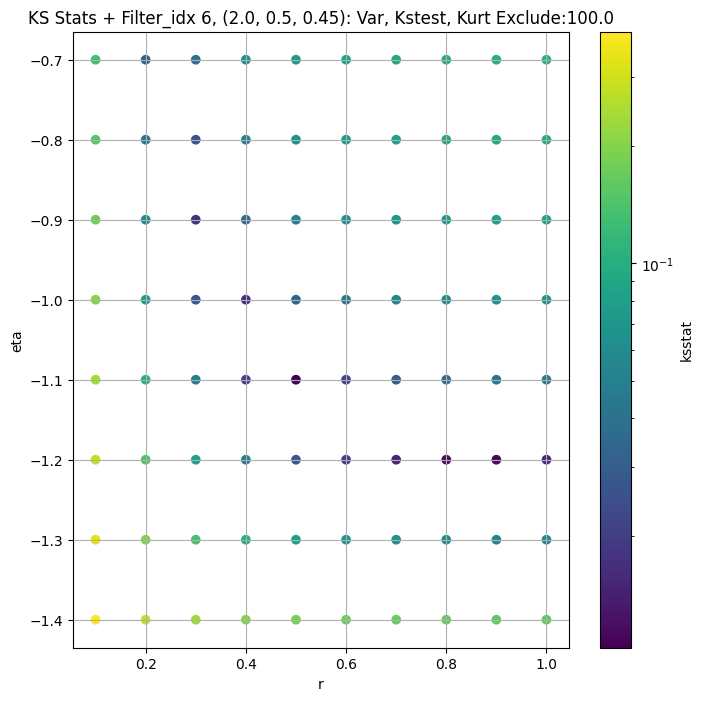

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.0035228371355450205 72789.0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.005307413771045551 69878.25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.005307413771045551 67856.89


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.006614324925389645 64563.57
Number of samples: 100000, Without approximation : 65536000.0


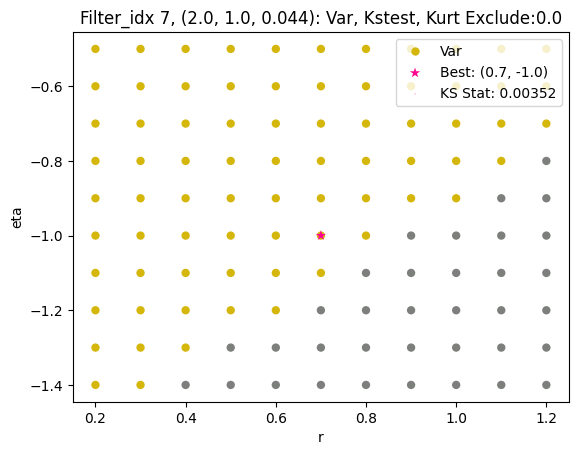

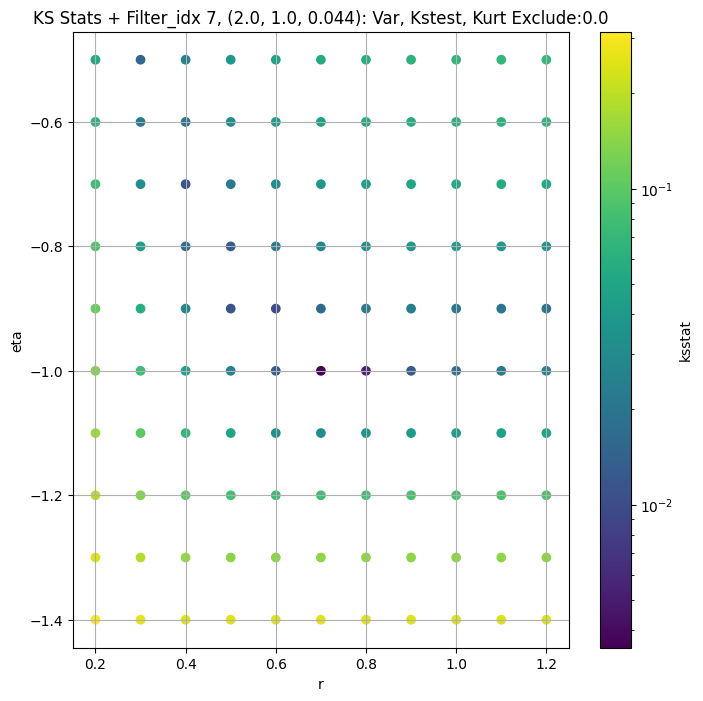

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.003025072529397377 27265.473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.004731970878857683 26009.059


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.004177246621741914 25158.79


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.006002038562817225 23816.746
Number of samples: 100000, Without approximation : 65536000.0


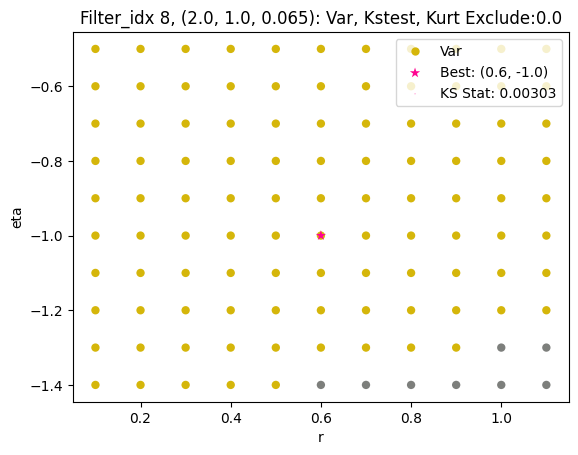

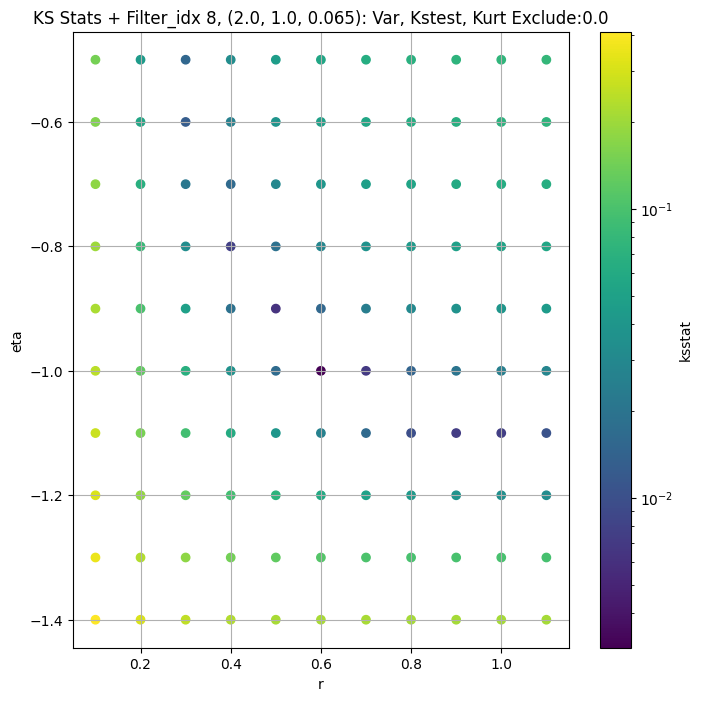

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.004696390869683653 10545.252


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.006215150189597507 9992.585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.006252814443511556 9632.747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.005779612258942746 9071.613
Number of samples: 100000, Without approximation : 65536000.0


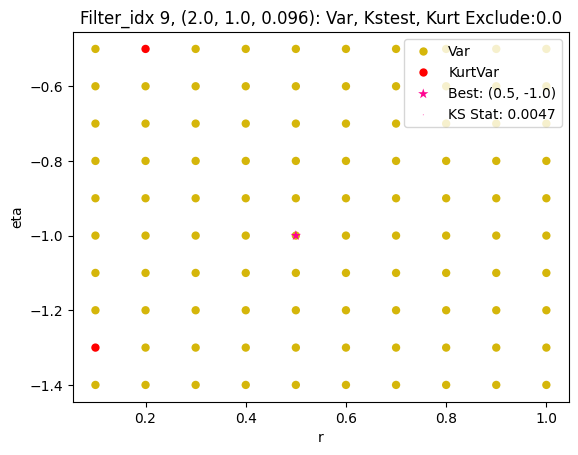

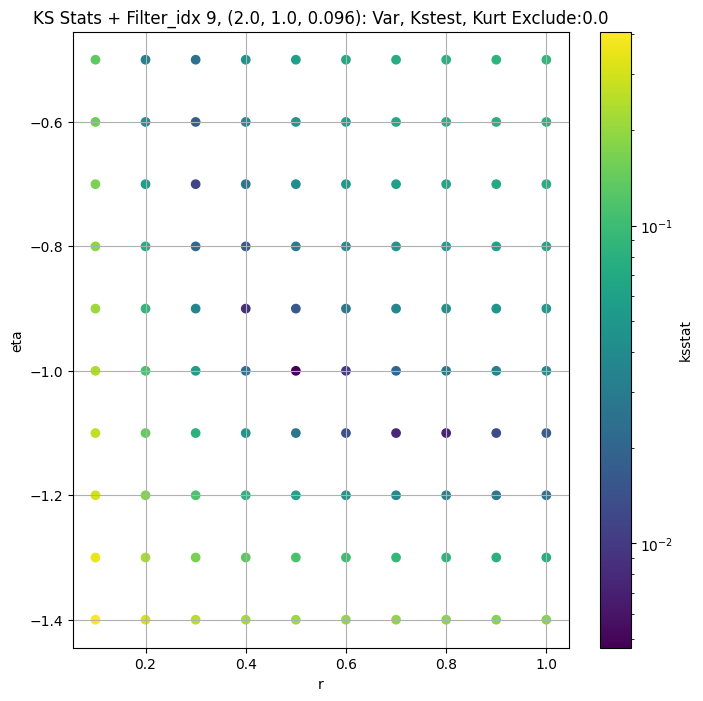

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.004344826445266126 4141.932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.004567410632844868 3892.17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.0057323159636063215 3734.4016


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.005622287653703428 3497.937
Number of samples: 100000, Without approximation : 65536000.0


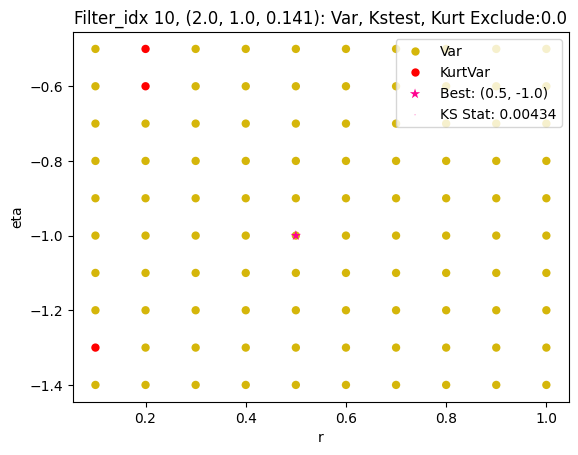

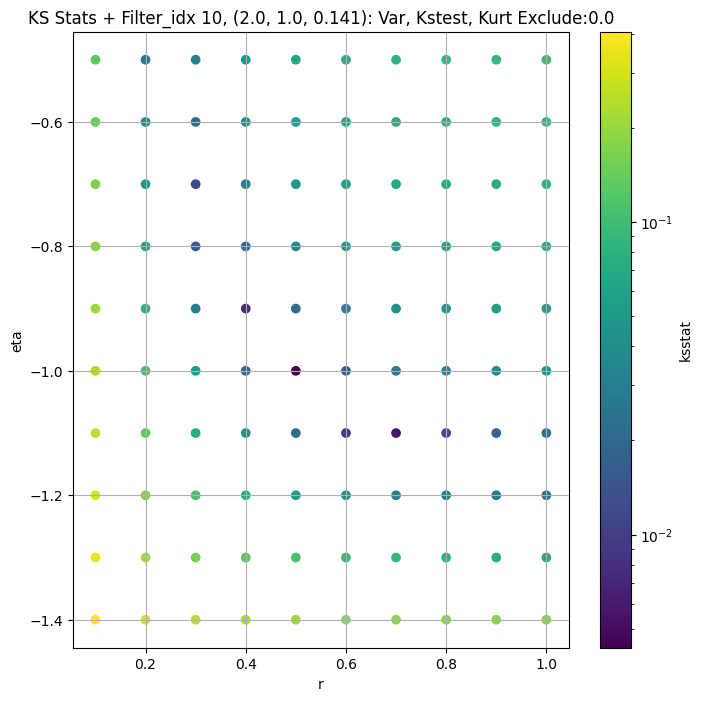

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.004362277148367788 1701.6533


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.003897846347283851 1589.7109


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.004453447314437531 1520.6812


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.004693356164996554 1416.4443
Number of samples: 100000, Without approximation : 65536000.0


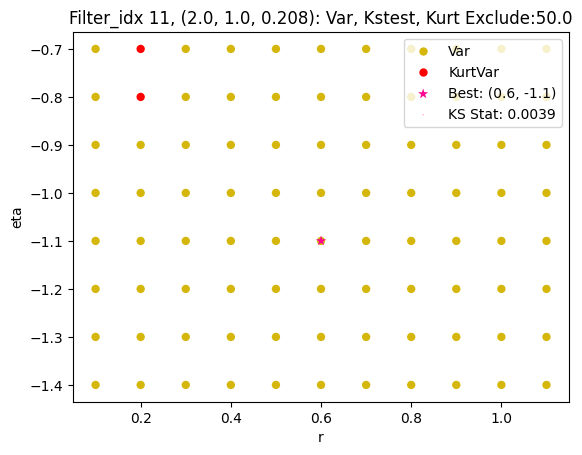

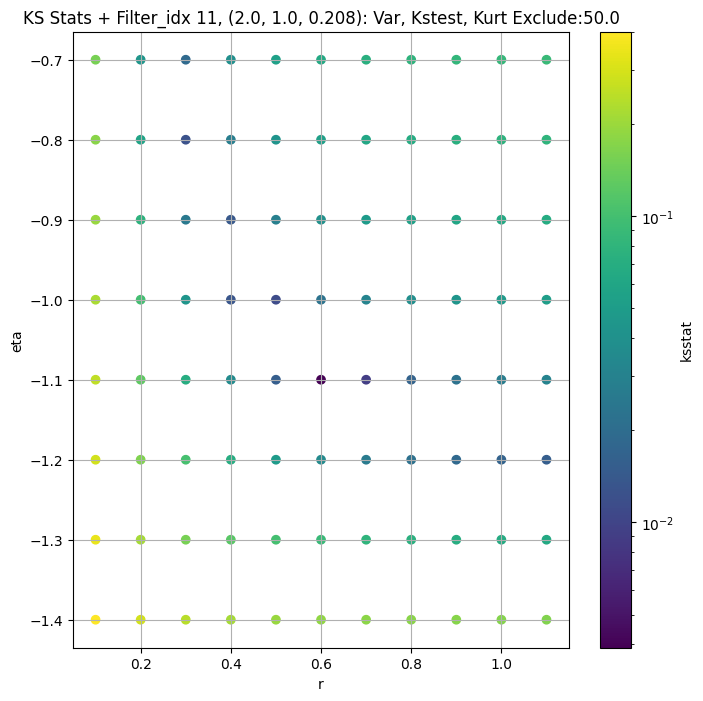

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.00601794918609766 724.9698


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.006178131439474266 675.34686


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.0061278522070126185 644.30115


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.00602180783183115 598.37897
Number of samples: 100000, Without approximation : 65536000.0


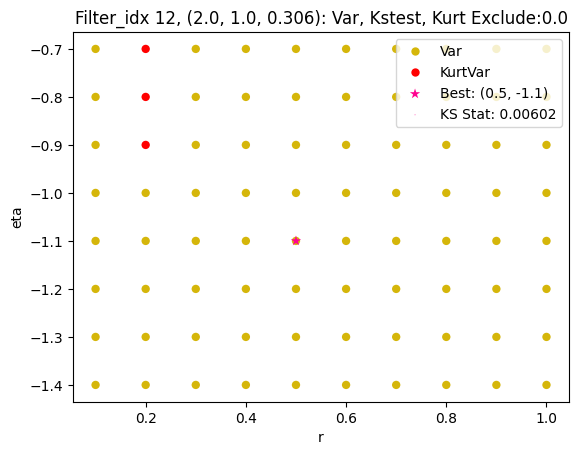

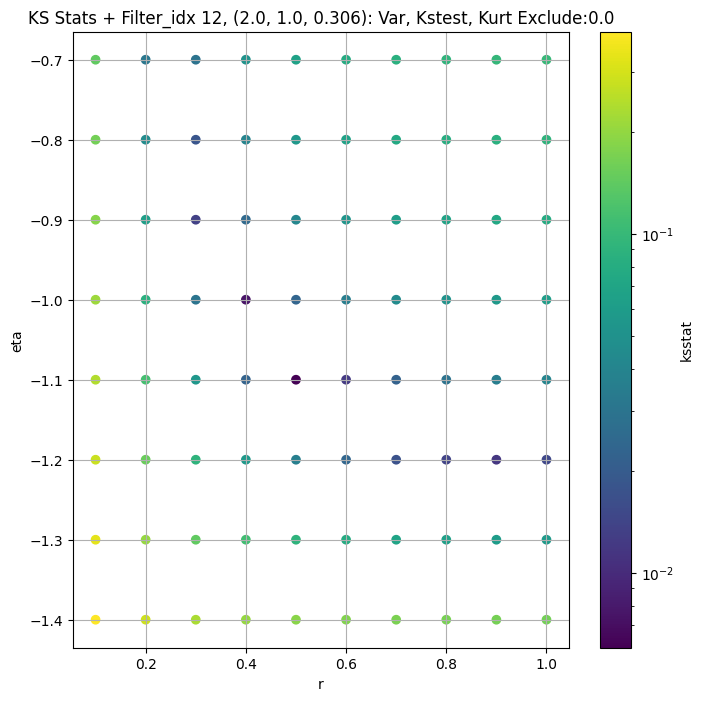

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.010584873803786532 381.20267


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.010560021496471561 352.61655


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.01055824341694267 335.35764


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.010555379668015952 310.11078
Number of samples: 100000, Without approximation : 65536000.0


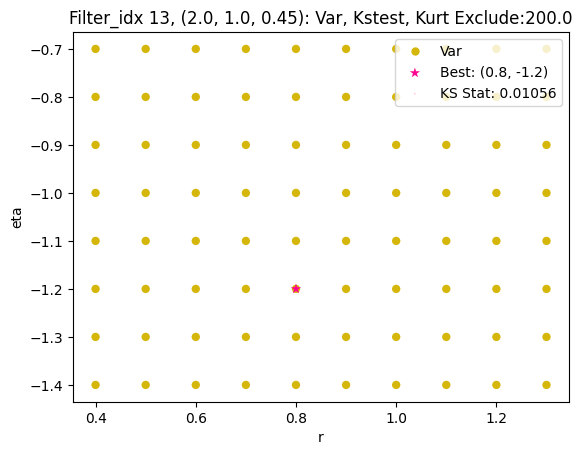

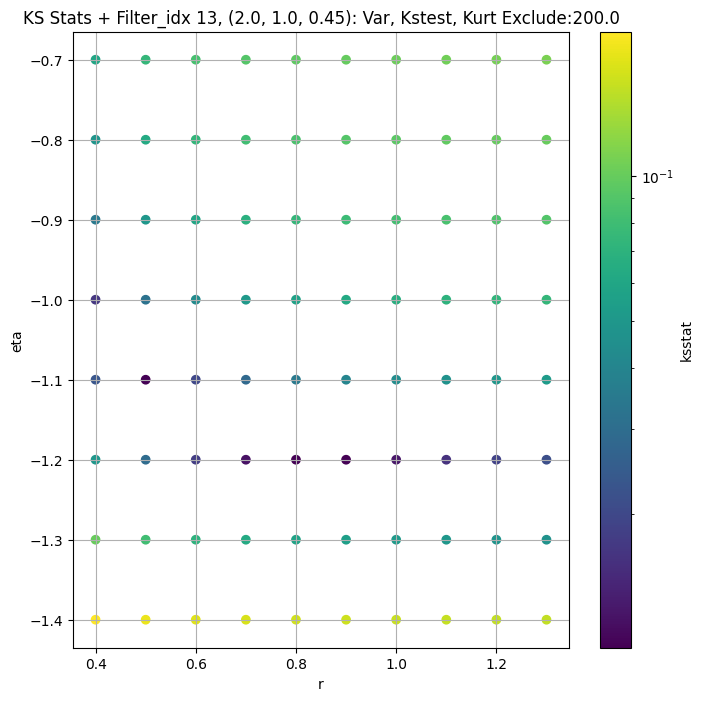

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.005205312297568855 50029.69


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.007114476168023881 47956.043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.006344077141741775 46603.46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.00835255607763654 44417.94
Number of samples: 100000, Without approximation : 65536000.0


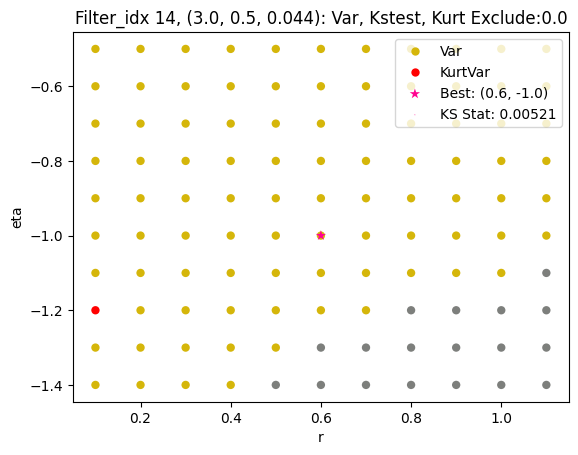

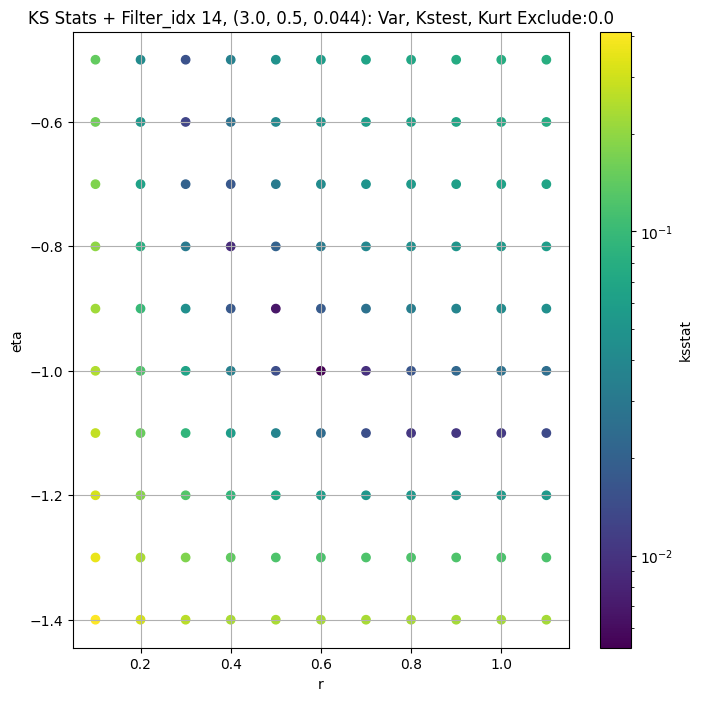

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.004477814815617043 18344.752


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.00634353114106645 17439.754


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.007698588254935211 16858.844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.007453626120114132 15939.426
Number of samples: 100000, Without approximation : 65536000.0


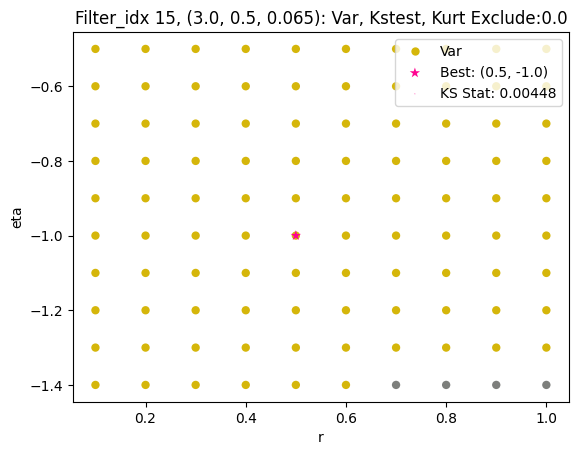

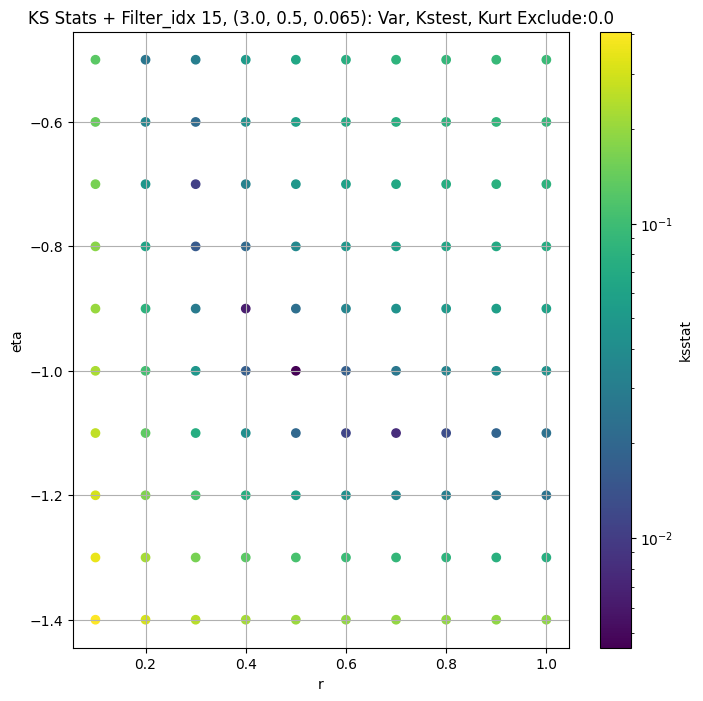

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.008764190927890048 7200.649


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.008785868707024691 6783.951


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.007012803368635856 6530.061


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.007607388054992614 6136.208
Number of samples: 100000, Without approximation : 65536000.0


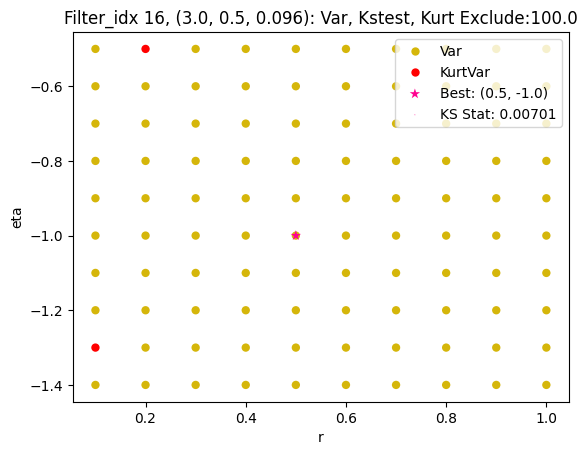

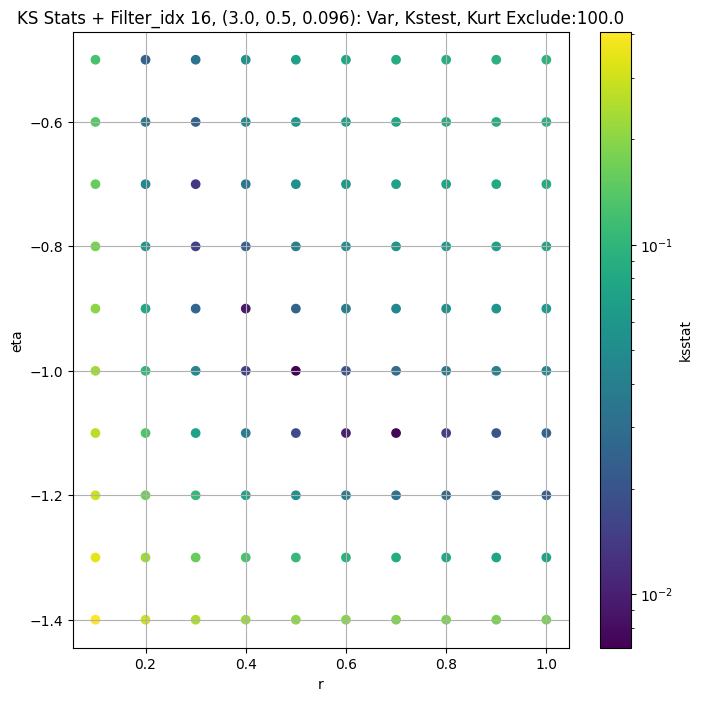

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.004539471742443402 2915.957


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.006315778901622049 2734.8962


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.006912462451612478 2622.3186


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.008003548635498237 2448.6824
Number of samples: 100000, Without approximation : 65536000.0


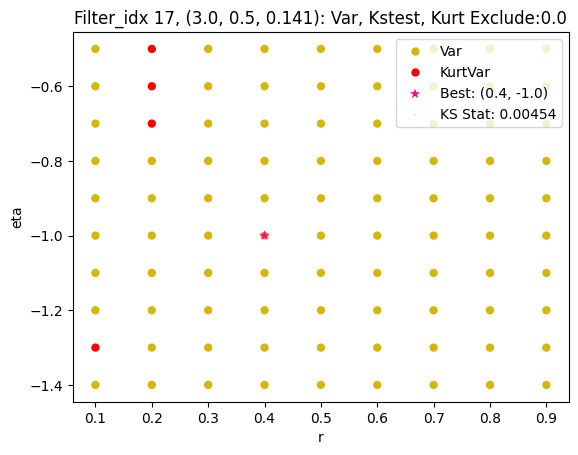

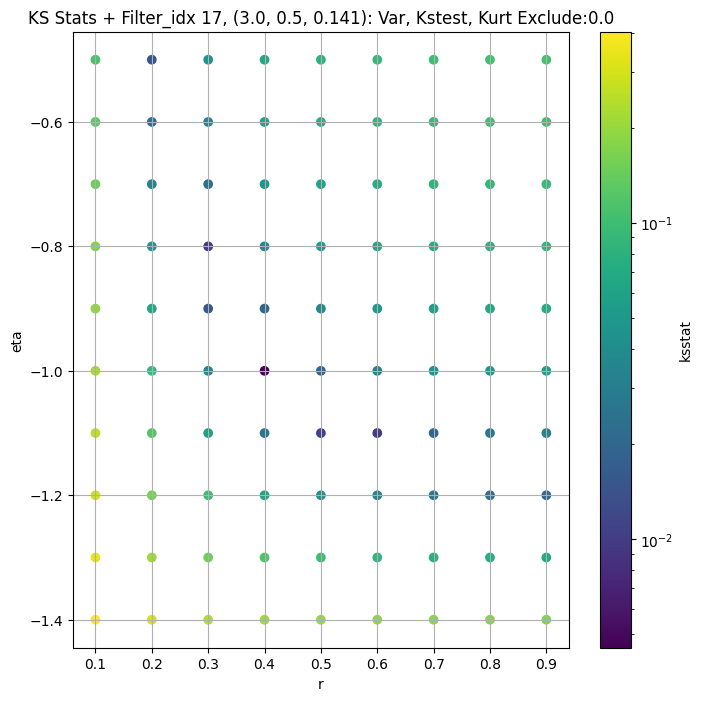

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.005995253311744442 1236.5056


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.004758222454322114 1150.9287


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.005564614074318075 1099.7139


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.0079882156947082 1023.01855
Number of samples: 100000, Without approximation : 65536000.0


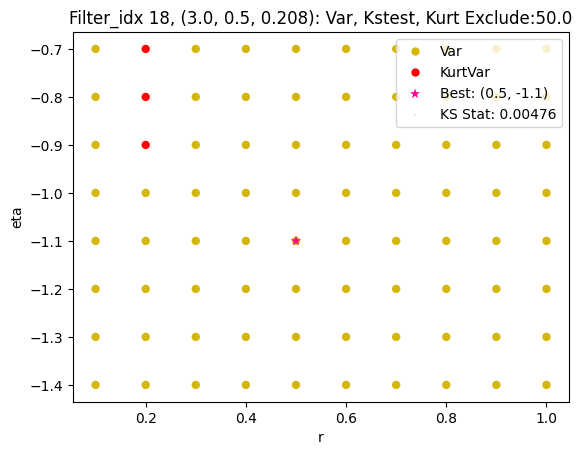

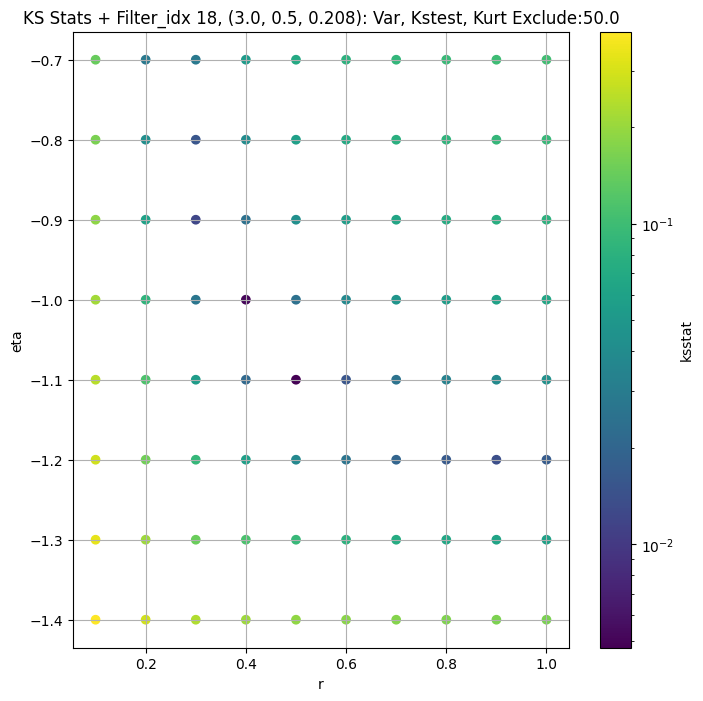

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.007081011873647042 557.11536


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.009933365800150695 516.952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.007566118966152557 492.71567


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.0068614107929790835 456.11185
Number of samples: 100000, Without approximation : 65536000.0


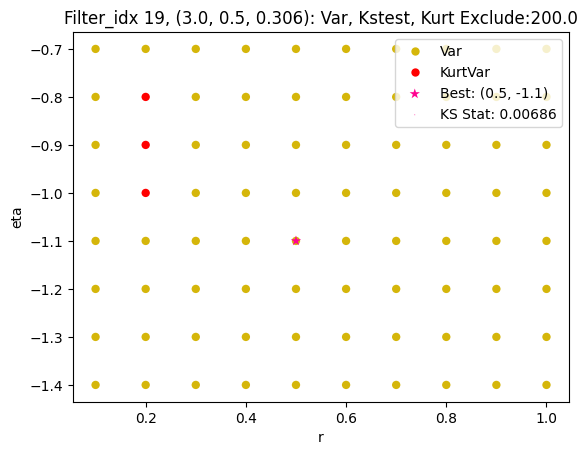

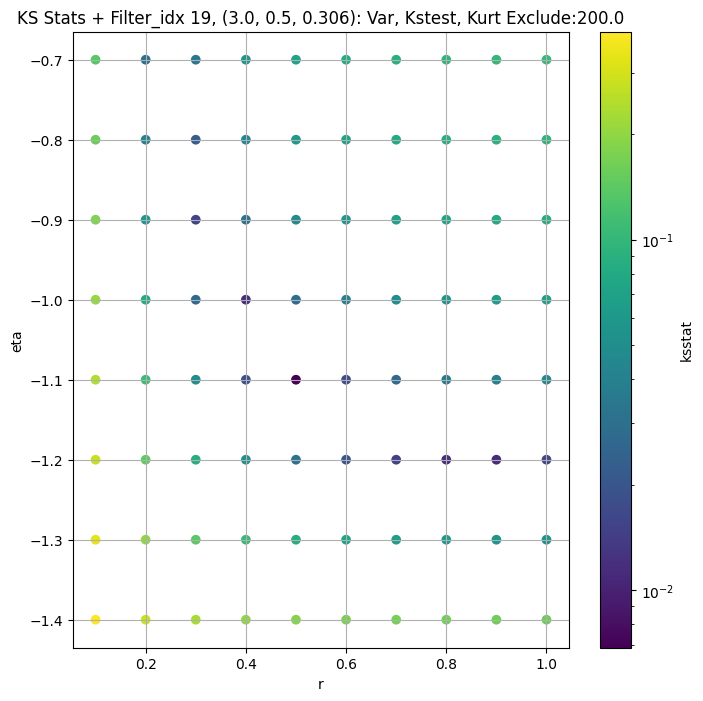

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.013746875686633575 285.51083


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.013357084469305391 265.28513


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.011072380507732904 252.58626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.010245159245215907 232.56932
Number of samples: 100000, Without approximation : 65536000.0


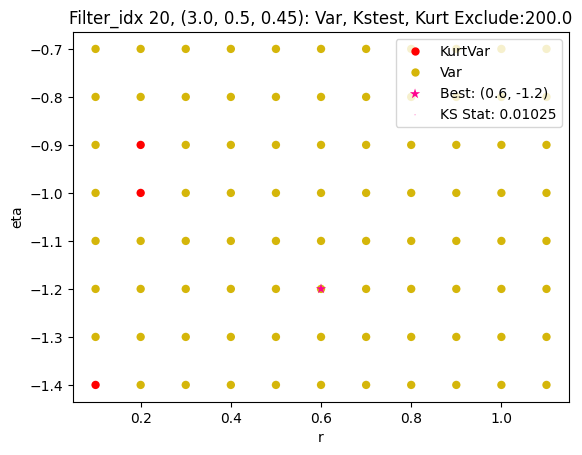

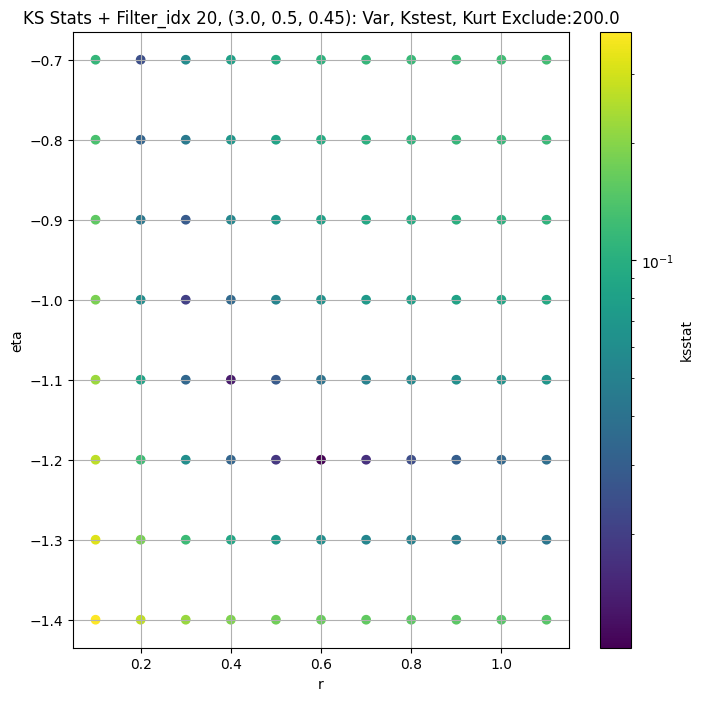

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.007884934893801598 58546.016


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.0048163672714338635 55326.824


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.005303063271367273 53174.37


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.007881349181587338 49815.594
Number of samples: 100000, Without approximation : 65536000.0


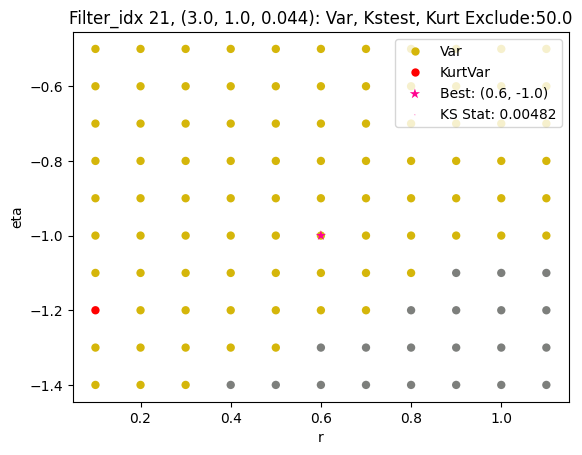

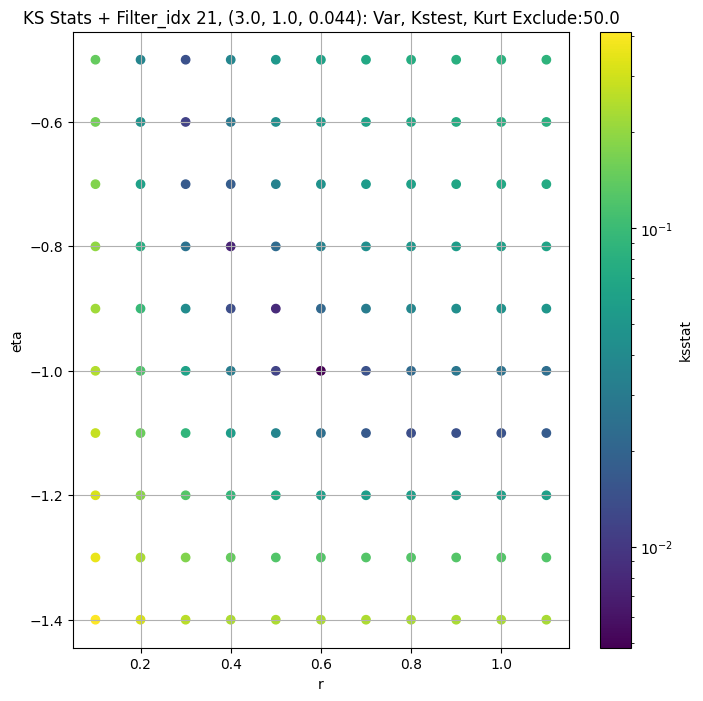

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.007994764488246722 21690.967


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.004578632304936492 20198.355


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.004415792476211711 19252.834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.007813070067282046 17815.23
Number of samples: 100000, Without approximation : 65536000.0


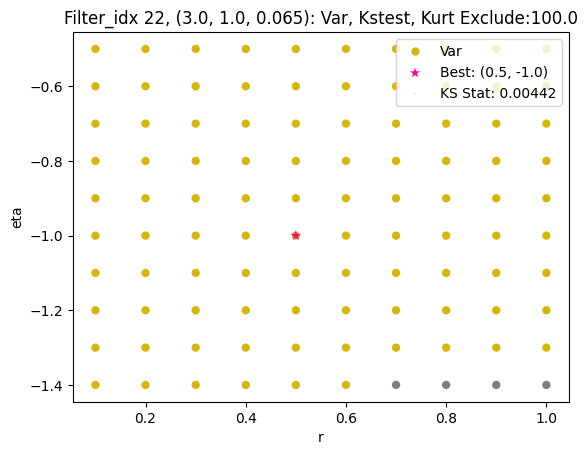

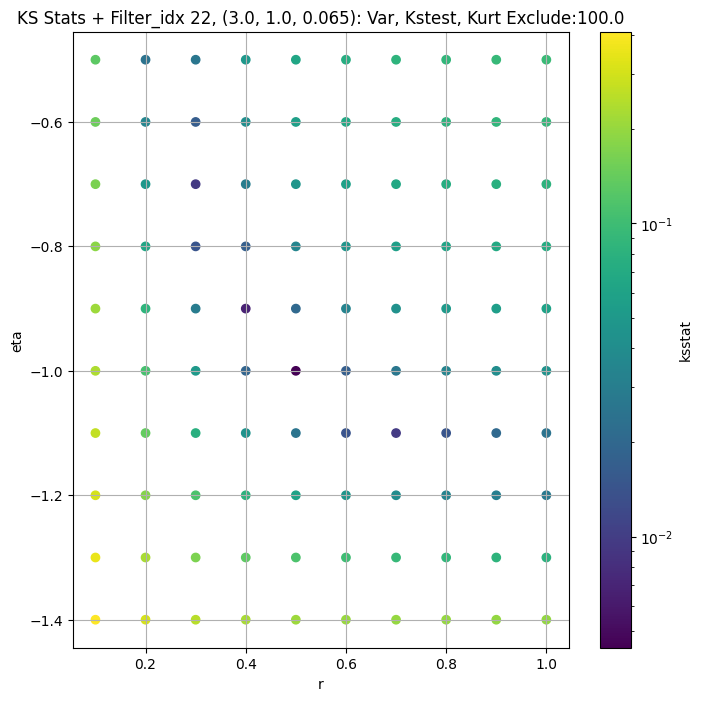

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.006339269504478773 8192.324


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.0065998503607604675 7541.439


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.009134738345857096 7144.232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.00585576041082958 6555.883
Number of samples: 100000, Without approximation : 65536000.0


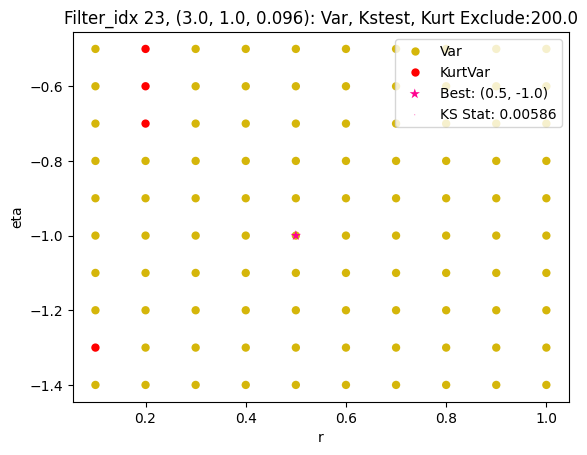

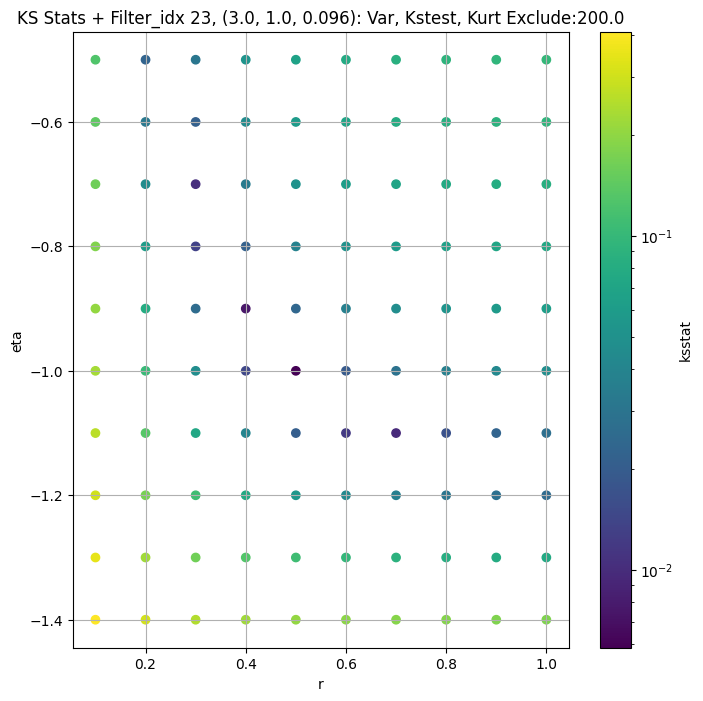

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.00592773815792913 3318.3335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.005259018240899249 3028.9053


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.006599751534849985 2854.6025


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.00971537202366013 2607.5583
Number of samples: 100000, Without approximation : 65536000.0


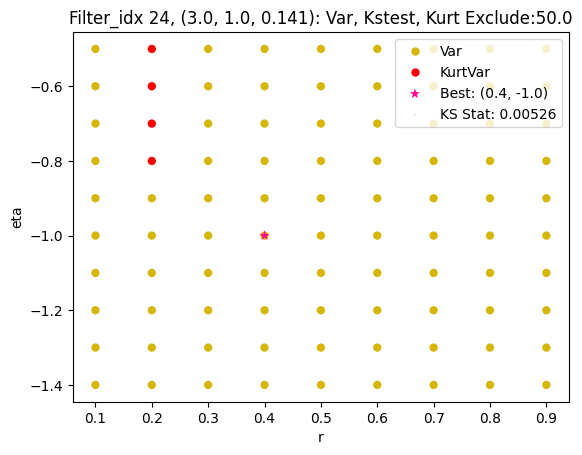

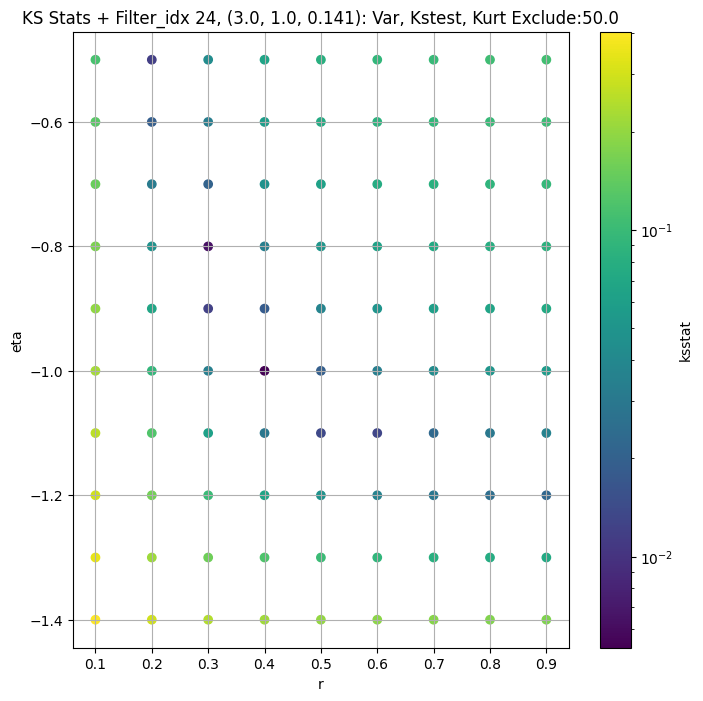

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.00421046939424724 1405.9277


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.002539220528028796 1275.7452


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.004903514617770249 1200.7983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.005461786709260119 1094.3124
Number of samples: 100000, Without approximation : 65536000.0


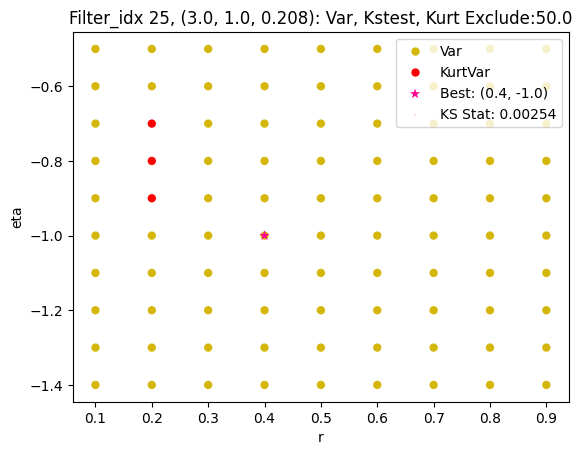

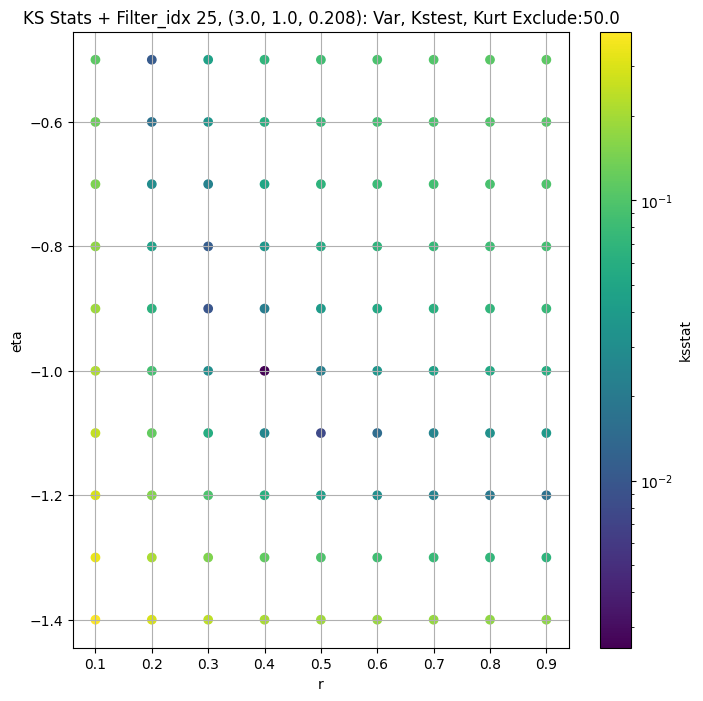

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.010254036496695984 638.012


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.006617507435416448 567.20984


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.0032732355415951916 530.8728


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.006340548736131213 481.7412
Number of samples: 100000, Without approximation : 65536000.0


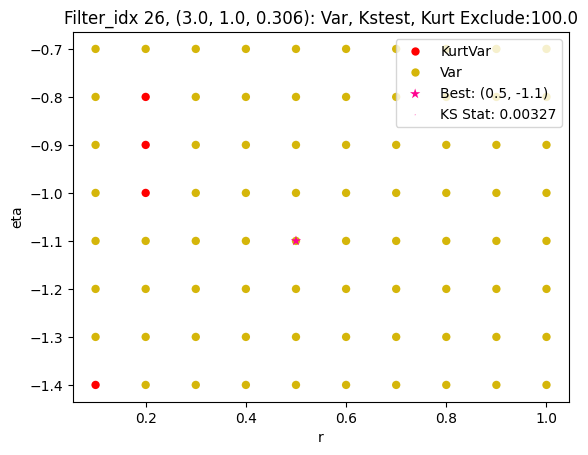

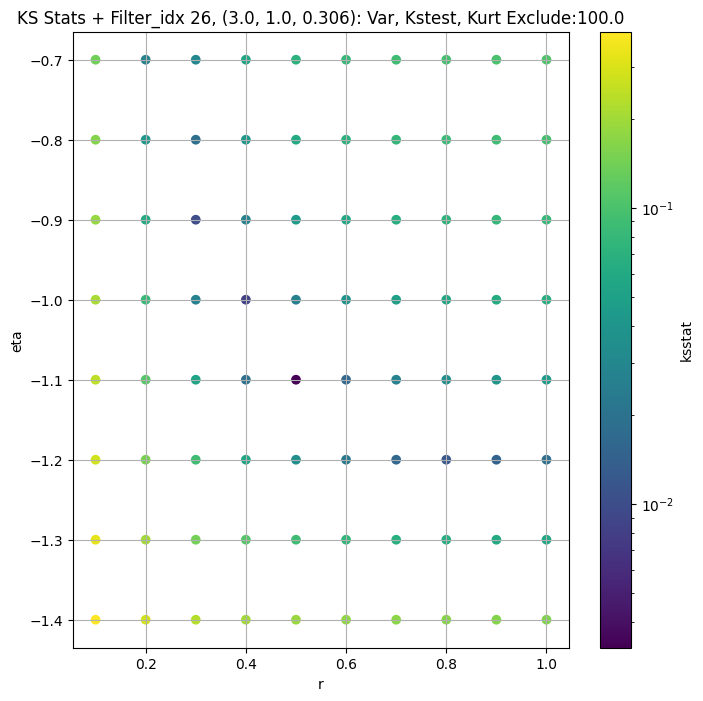

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.011491617354600026 299.3036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.012982518256166697 269.10272


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.012272759684647139 252.40562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.009450793589064088 229.49397
Number of samples: 100000, Without approximation : 65536000.0


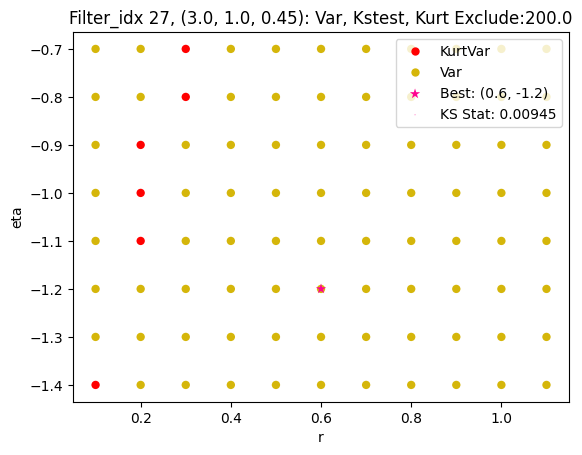

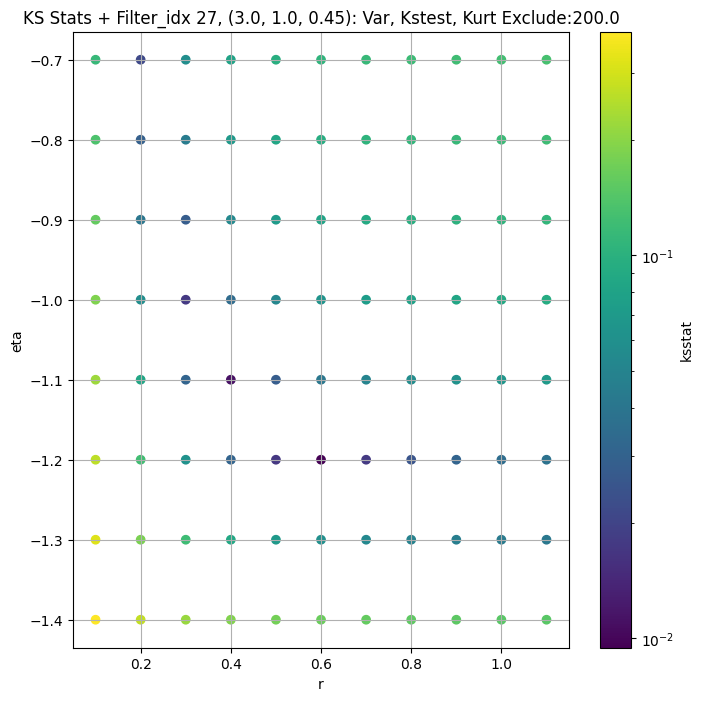

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0034777555920898484 46680.42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.006143116035033369 44397.484


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.005199191393913893 43024.754


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.006939171667089794 40829.246
Number of samples: 100000, Without approximation : 65536000.0


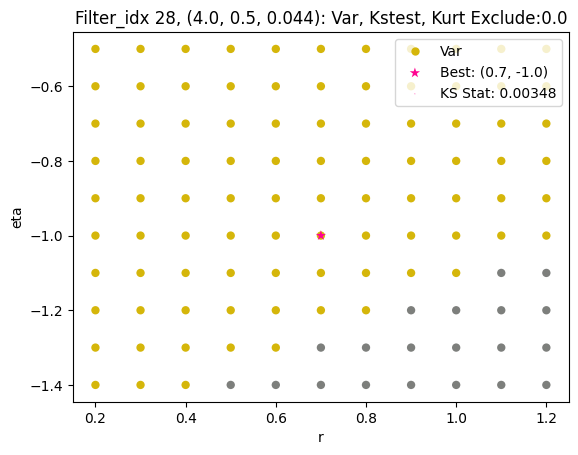

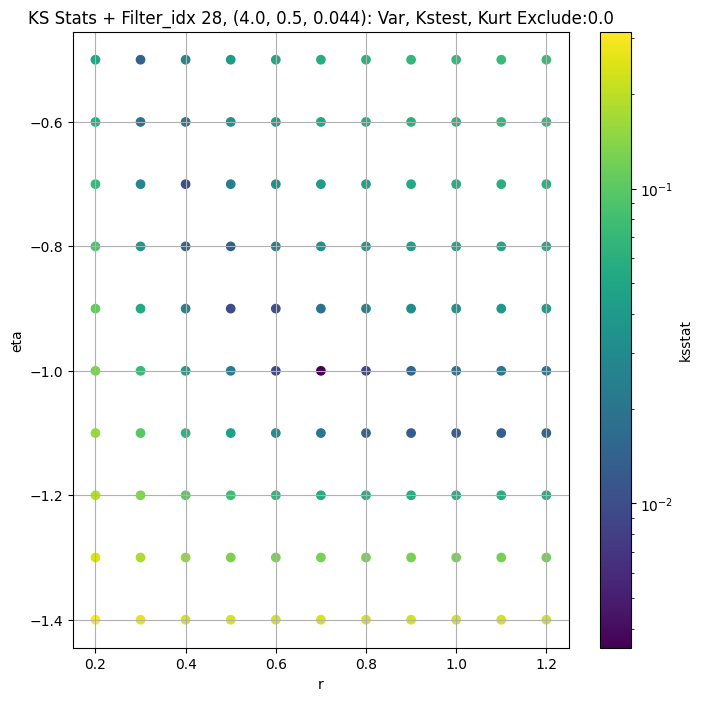

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.007574860350632484 17822.12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.005096830234709193 16810.812


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.006771418590619915 16211.0205


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.006819426995920308 15280.26
Number of samples: 100000, Without approximation : 65536000.0


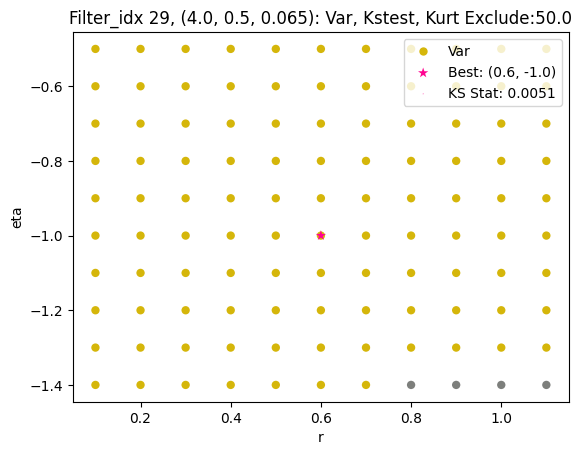

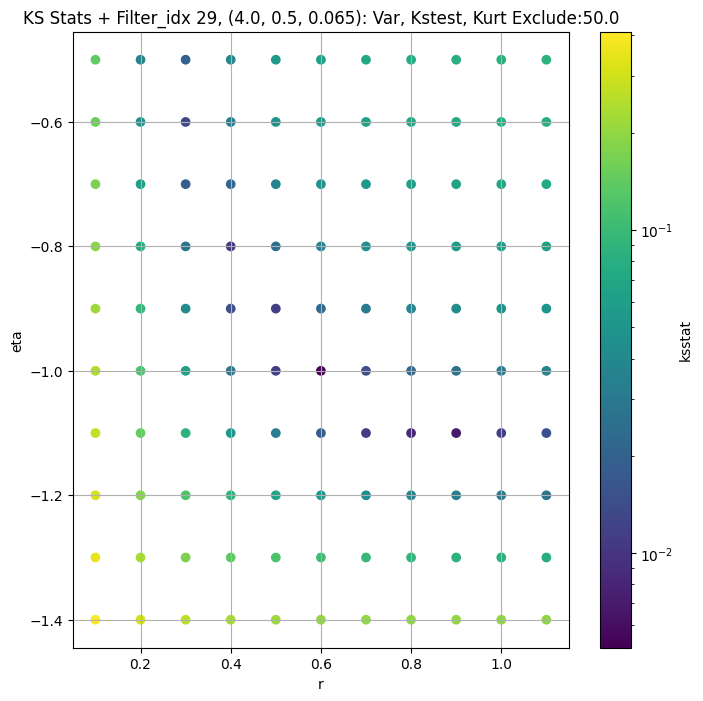

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.0034202601786834097 6923.0356


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.006978708494578129 6458.9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.00815783286101962 6204.9346


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.0073066274991671065 5818.8984
Number of samples: 100000, Without approximation : 65536000.0


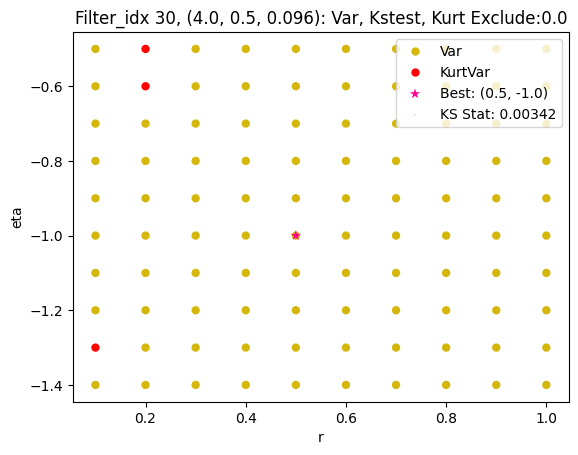

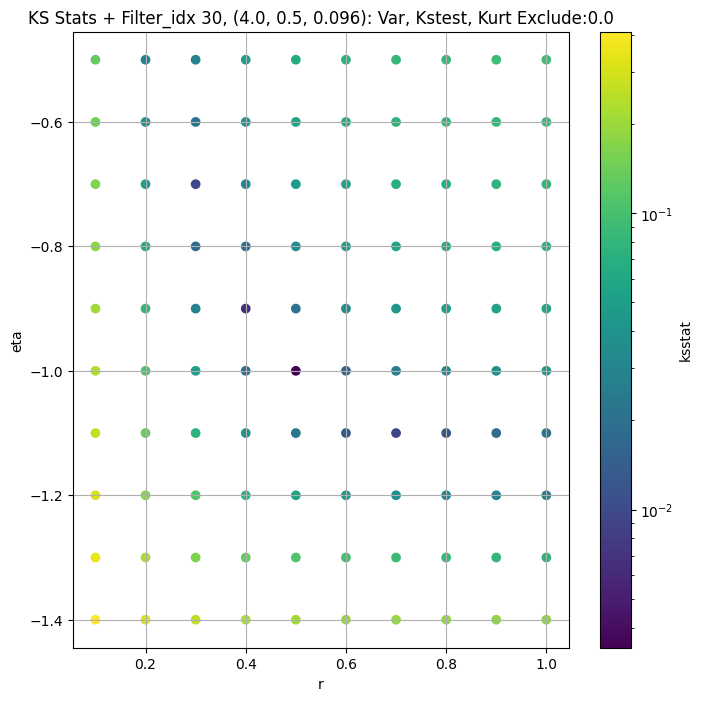

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.006619412045793083 2739.1924


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.006954280800496648 2536.174


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.007557119303962523 2424.1978


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.00781880090282494 2255.9995
Number of samples: 100000, Without approximation : 65536000.0


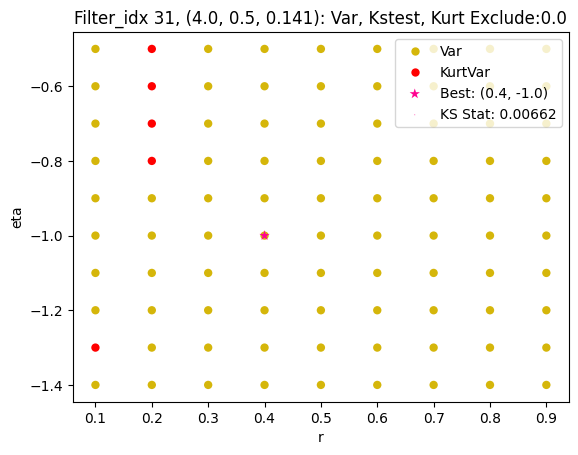

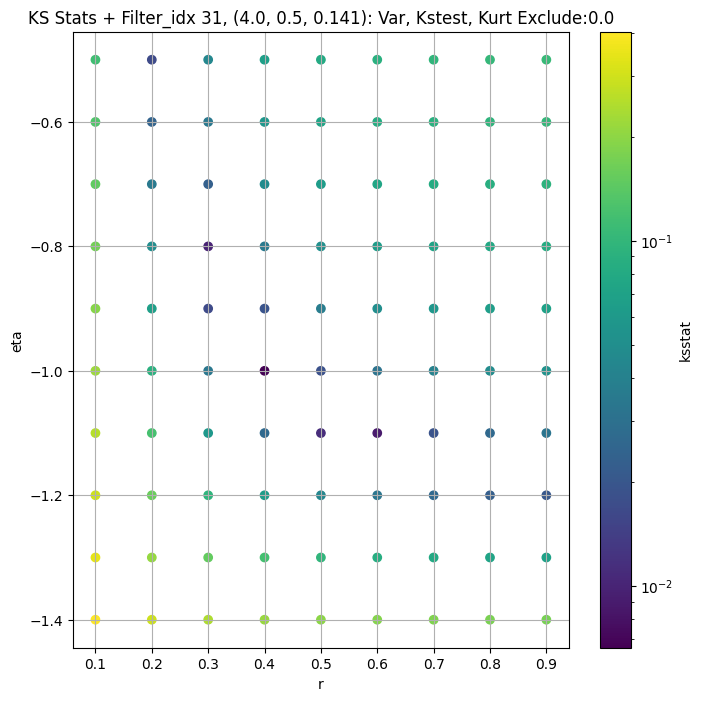

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.004009795020283979 1188.8745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.0062143359382552665 1090.5007


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.00703300664301898 1038.9686


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.006514763422778569 964.6039
Number of samples: 100000, Without approximation : 65536000.0


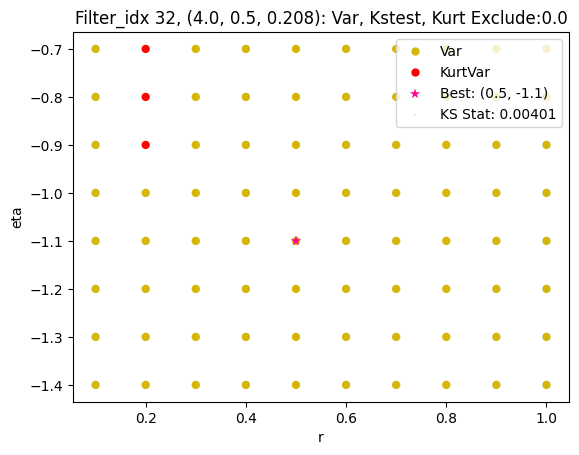

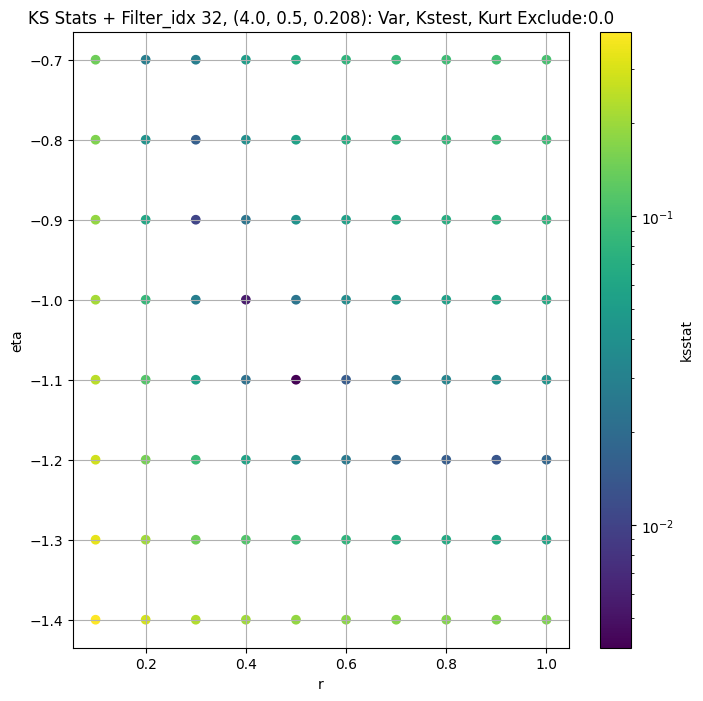

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.008589839126115245 551.6042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.008727149411306478 508.33432


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.006617167683595104 483.90717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.00837624220857578 447.7275
Number of samples: 100000, Without approximation : 65536000.0


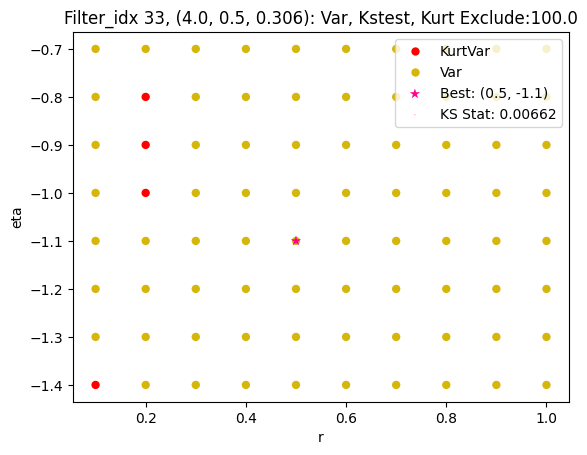

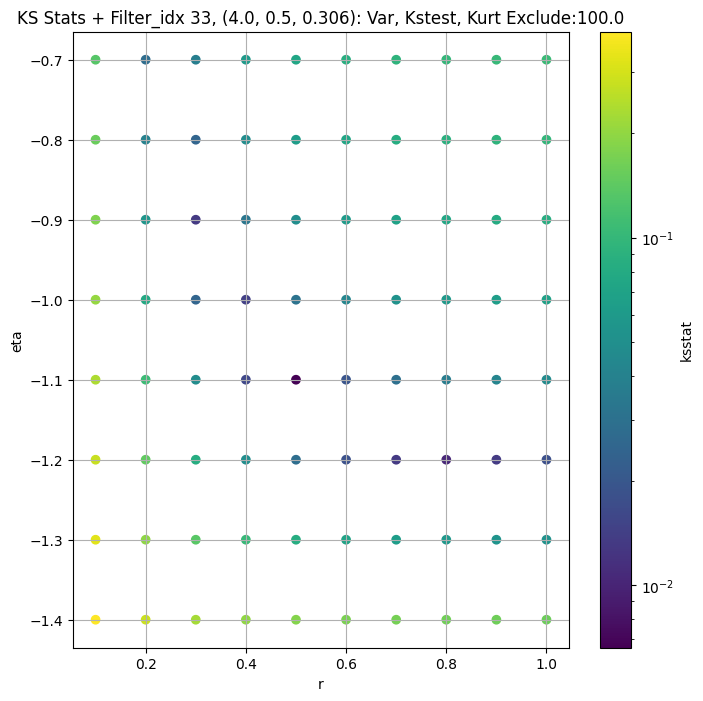

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.016217142704731846 264.026


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.012393647926124962 241.8016


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.011023412866880578 229.43106


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.012796950331398937 211.37164
Number of samples: 100000, Without approximation : 65536000.0


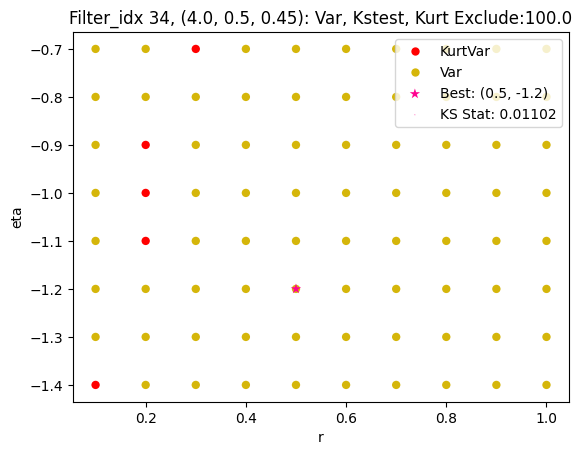

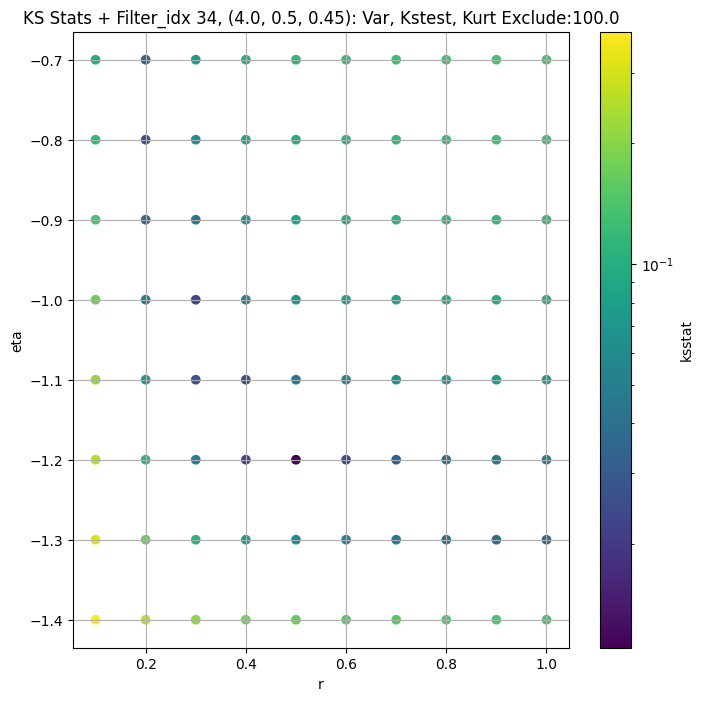

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.005319565475737198 53505.465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.003233884144834498 50316.19


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.002863258115123668 48141.42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0040052689989221735 44791.555
Number of samples: 100000, Without approximation : 65536000.0


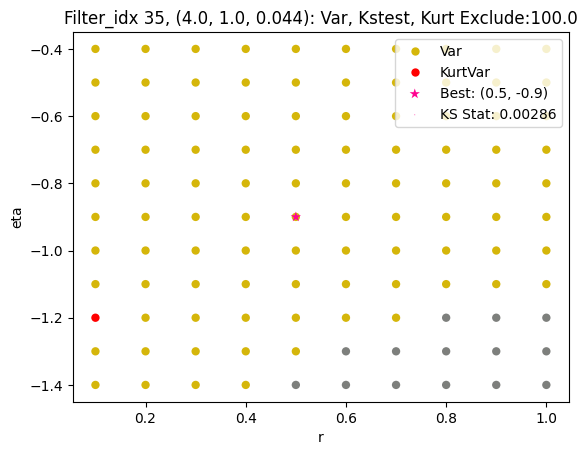

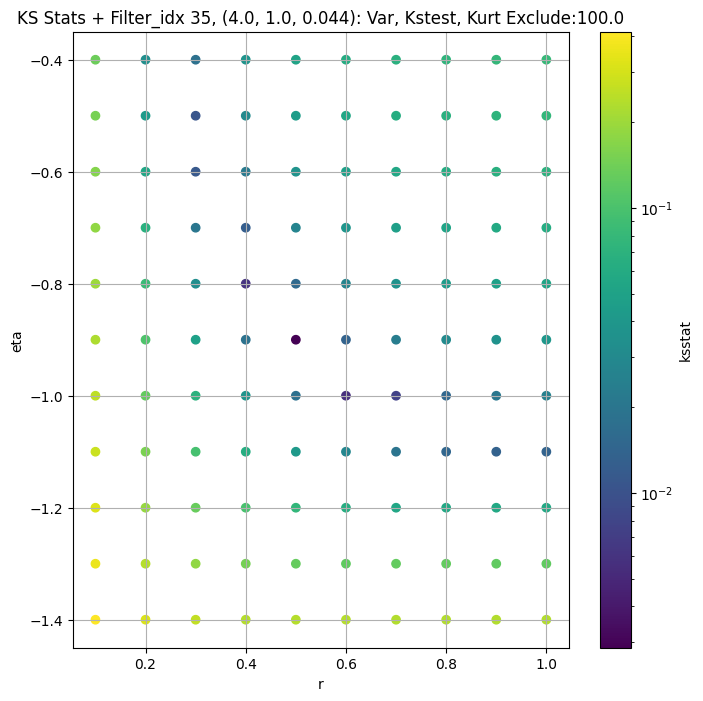

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.00554317796213466 20815.871


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0021868986776552024 19174.14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.004160160043936795 18206.64


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.006877847371729251 16755.87
Number of samples: 100000, Without approximation : 65536000.0


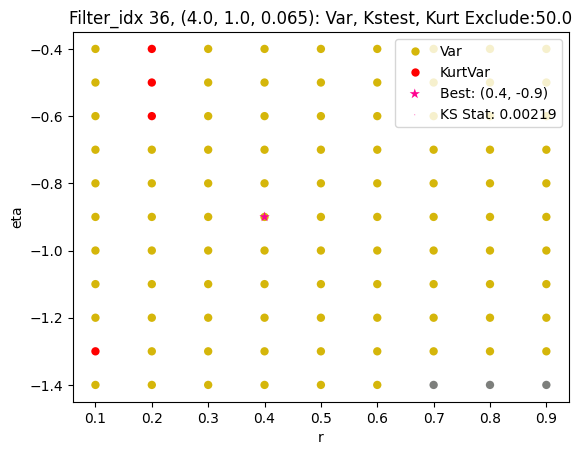

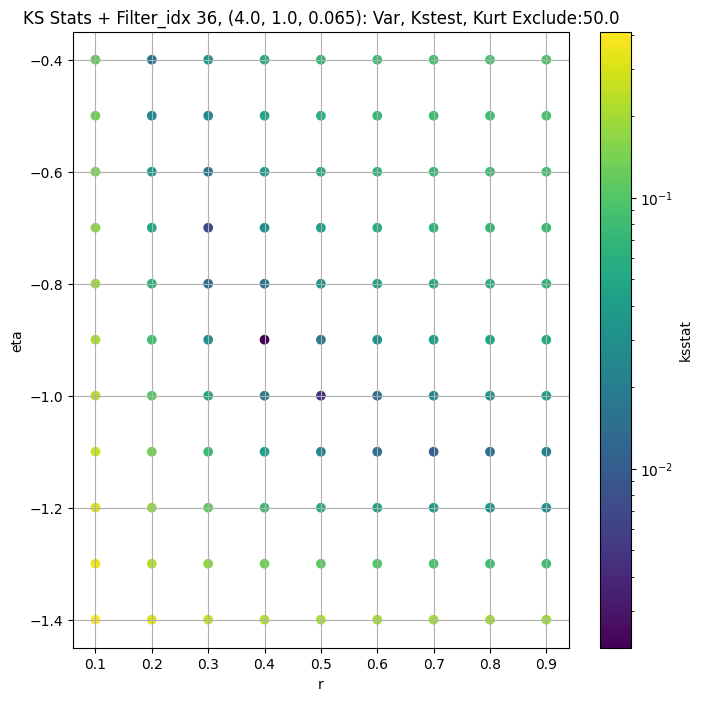

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.006488060819475727 7727.7344


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.005310879221753814 7007.64


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.008666670465087734 6610.973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.004691921244391516 6037.1816
Number of samples: 100000, Without approximation : 65536000.0


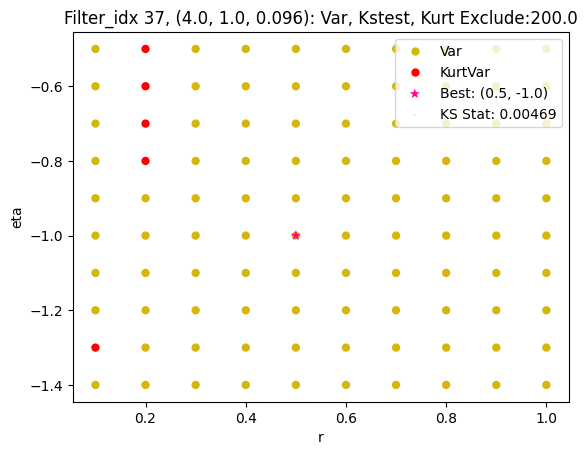

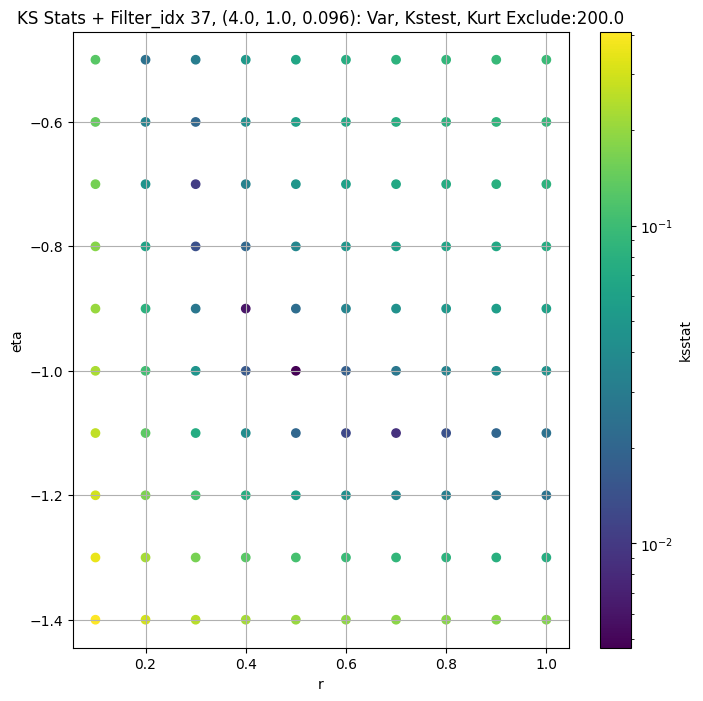

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.0031775569290358185 3115.8599


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.003027106551321823 2786.4385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.0037707110448801373 2611.614


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.007498282792894773 2366.9373
Number of samples: 100000, Without approximation : 65536000.0


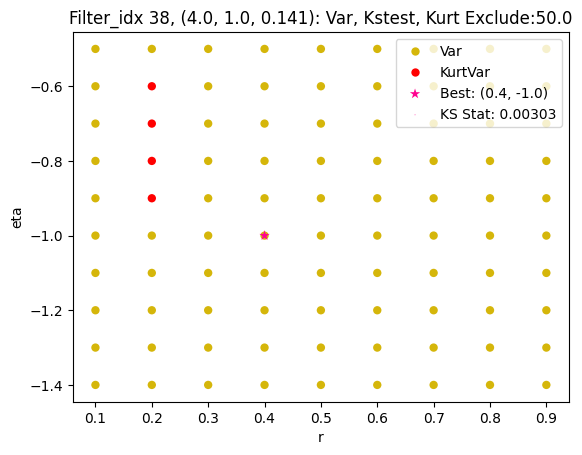

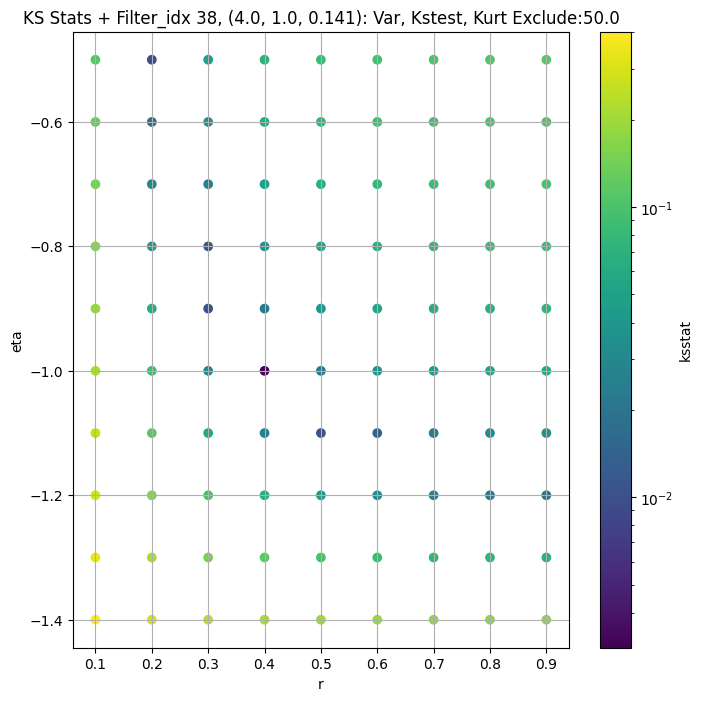

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.003439786871897721 1252.1841


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.0046032720627985635 1114.9027


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.002687581619757129 1043.1613


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.0065256349668031954 943.1573
Number of samples: 100000, Without approximation : 65536000.0


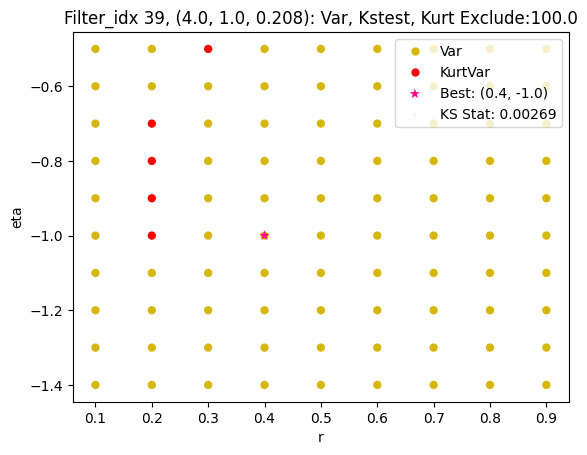

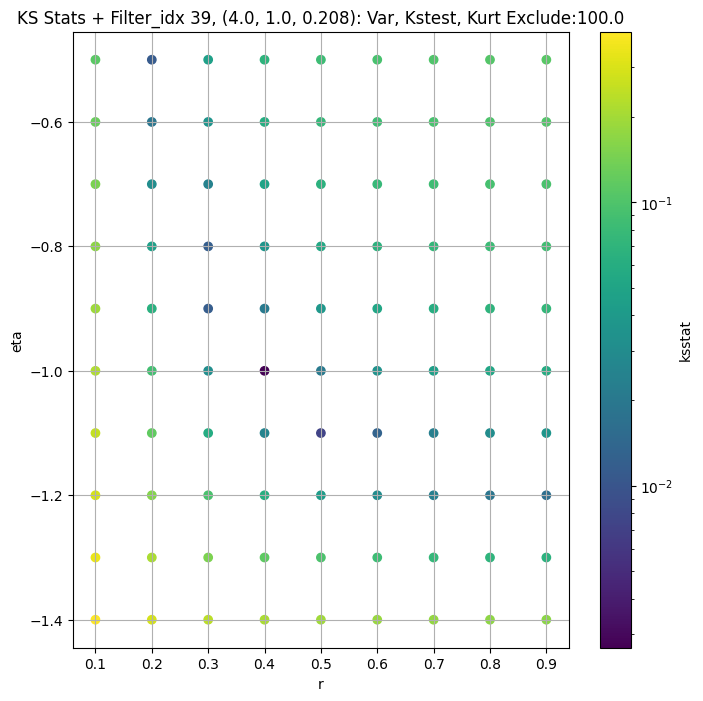

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.004157335018729724 610.8796


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.004421022528144081 540.08014


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.008352742297279114 503.80942


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.009158116246670511 454.05872
Number of samples: 100000, Without approximation : 65536000.0


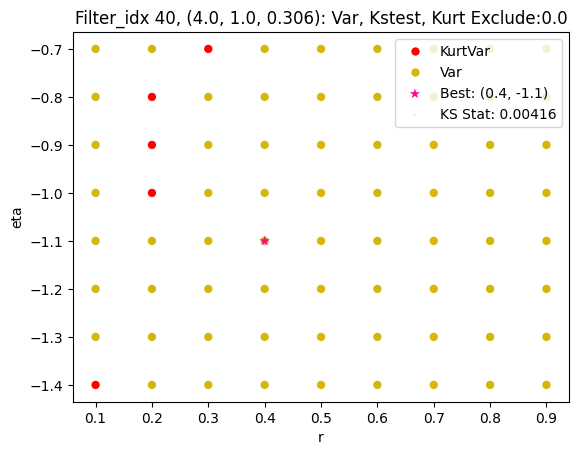

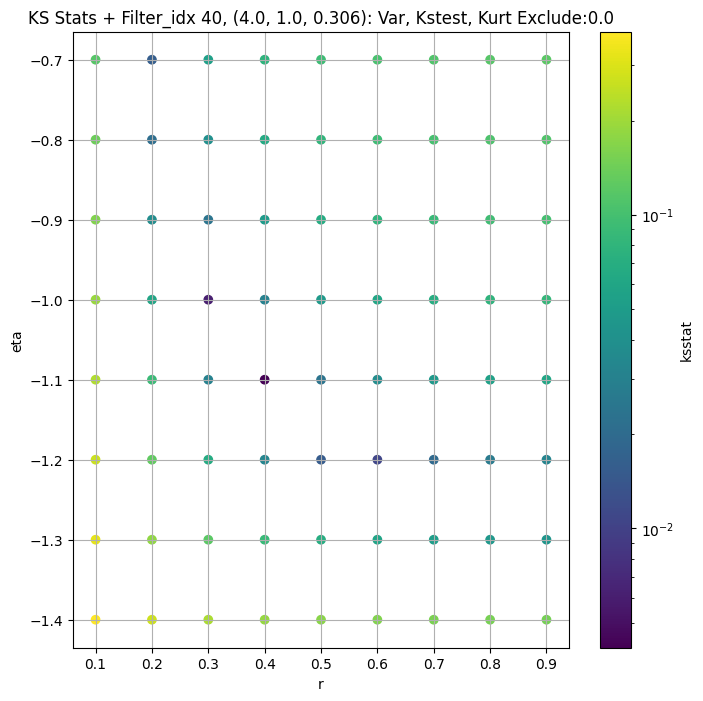

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.010242613004574408 292.8568


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.01511677230925379 258.91797


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.011705403643196721 240.50372


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.011264456520004185 215.92096
Number of samples: 100000, Without approximation : 65536000.0


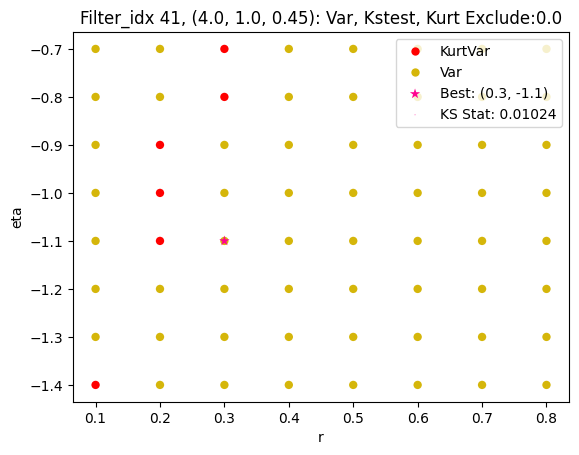

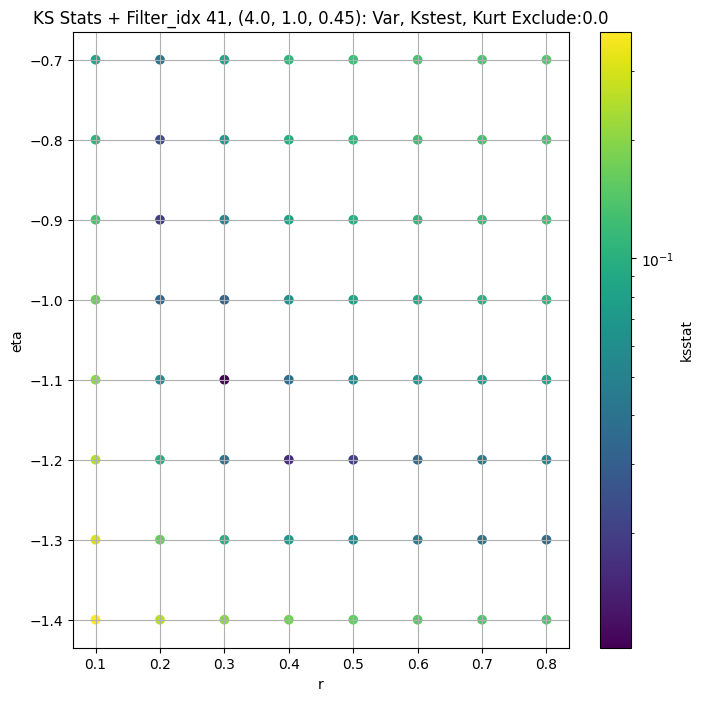

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53297.16400,41834.84000,64967.58000,4.950205,3.020211,9.423482,65536000.0,"(2.0, 0.5, 0.044)",0.007345,0.7,-1.0,63612.949124,0.0,53297.16400,0.000168
1,"(2.0, 0.5, 0.065)",19036.11300,14767.14500,24366.29900,6.551415,3.960084,13.359611,65536000.0,"(2.0, 0.5, 0.065)",0.004739,0.8,-1.1,36712.009581,0.0,19036.11300,0.000168
2,"(2.0, 0.5, 0.096)",7753.15700,6039.07570,9856.43900,7.599971,4.060136,17.624750,65536000.0,"(2.0, 0.5, 0.096)",0.005868,0.9,-1.1,15266.423705,200.0,6812.32000,0.000168
3,"(2.0, 0.5, 0.141)",3045.21600,2303.25980,3915.39140,8.890267,4.886585,21.868956,65536000.0,"(2.0, 0.5, 0.141)",0.004143,0.7,-1.1,4513.101591,50.0,2895.64770,0.000168
4,"(2.0, 0.5, 0.208)",1302.08530,960.97577,1655.82240,9.619346,5.580533,23.162615,65536000.0,"(2.0, 0.5, 0.208)",0.004263,0.6,-1.1,1403.605408,50.0,1234.15230,0.000168
5,"(2.0, 0.5, 0.306)",512.79870,374.28460,667.93590,11.261219,6.061162,26.931730,65536000.0,"(2.0, 0.5, 0.306)",0.009483,0.5,-1.1,301.268556,200.0,433.82672,0.000168
6,"(2.0, 0.5, 0.45)",354.43408,261.12814,466.77124,10.453091,5.964695,24.643680,65536000.0,"(2.0, 0.5, 0.45)",0.010334,0.5,-1.1,224.115033,100.0,322.72565,0.000168
7,"(2.0, 1.0, 0.044)",72789.00000,58219.42000,91857.51000,6.210428,3.580646,12.645504,65536000.0,"(2.0, 1.0, 0.044)",0.003523,0.7,-1.0,86877.473413,0.0,72789.00000,0.000168
8,"(2.0, 1.0, 0.065)",27265.47300,20917.25000,34807.19000,7.633041,4.059375,18.132977,65536000.0,"(2.0, 1.0, 0.065)",0.003025,0.6,-1.0,23152.017476,0.0,27265.47300,0.000168


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.007232095281034523, var: 50279.046875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.006798639475075419, var: 50863.92578125


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.007238577641735605, var: 51503.15234375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.006803108495706867, var: 52244.34765625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.006079837648586897, var: 53297.1640625
Number of samples: 100000, Without approximation : 65536000.0


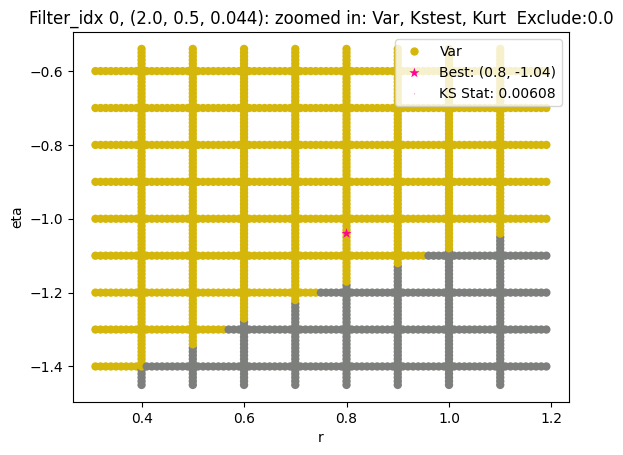

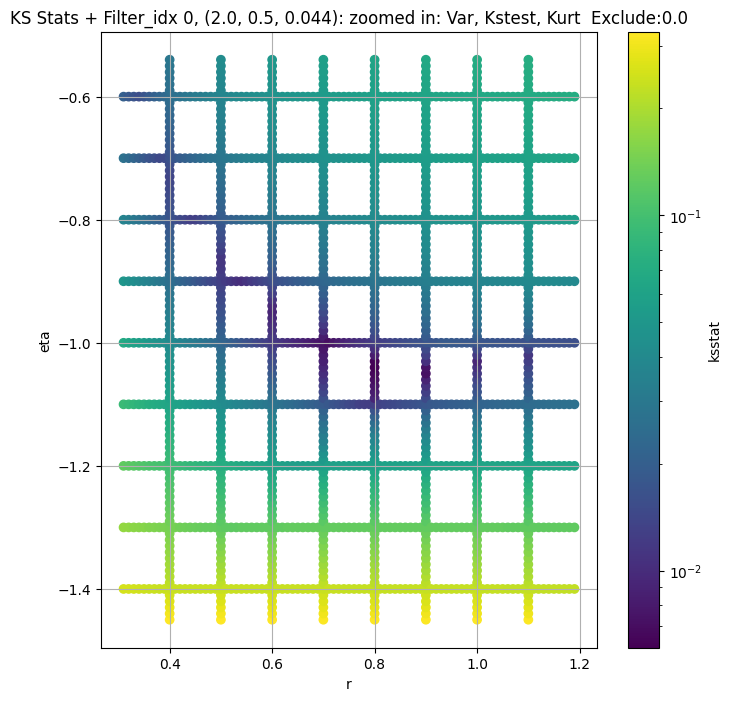

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.0049545895777992205, var: 17780.693359375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.004677384482017266, var: 18024.826171875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.004486690558524353, var: 18292.962890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.00451302376453766, var: 18597.962890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.004114517019986885, var: 19036.11328125
Number of samples: 100000, Without approximation : 65536000.0


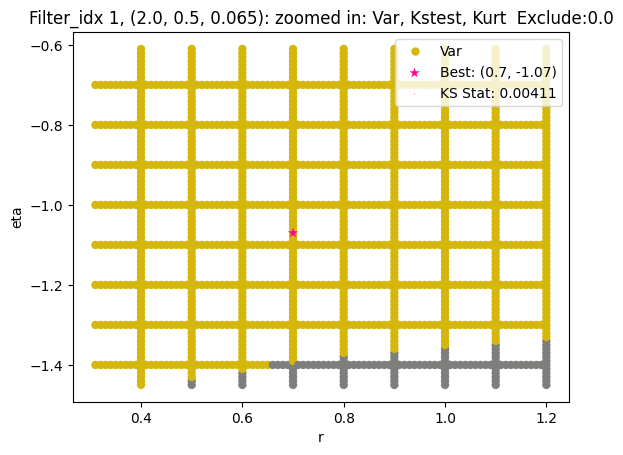

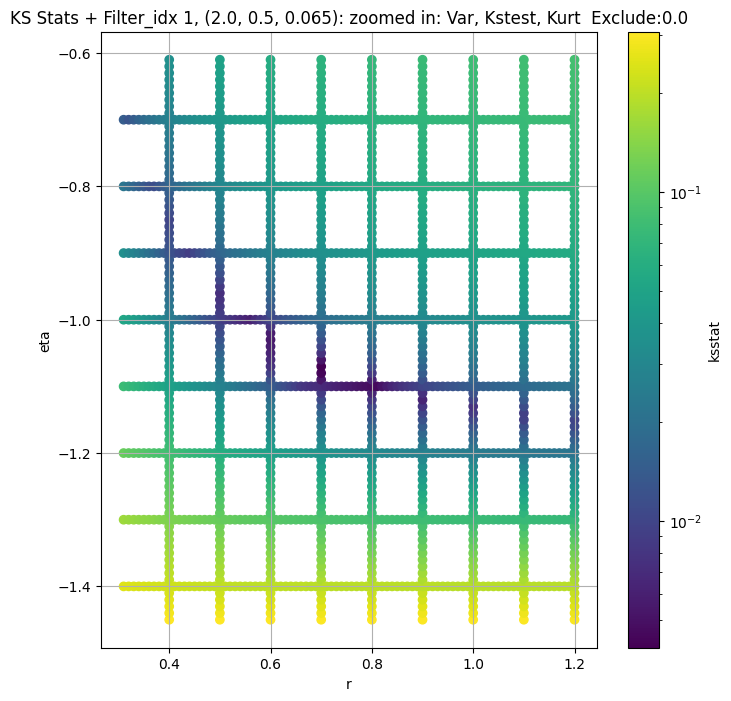

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.0068335873895492005, var: 6504.12255859375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.006665623055050807, var: 6576.98876953125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.006255692143610325, var: 6652.49072265625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.006124467979856774, var: 6730.72412109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.005797426008862516, var: 6812.31982421875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.005464158451392254, var: 6897.7099609375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.005501211358449054, var: 6987.408203125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.005145146417364702, var: 7081.77783203125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.00488205204715686, var: 7181.8818359375
Number of samples: 100000, Without approximation : 65536000.0


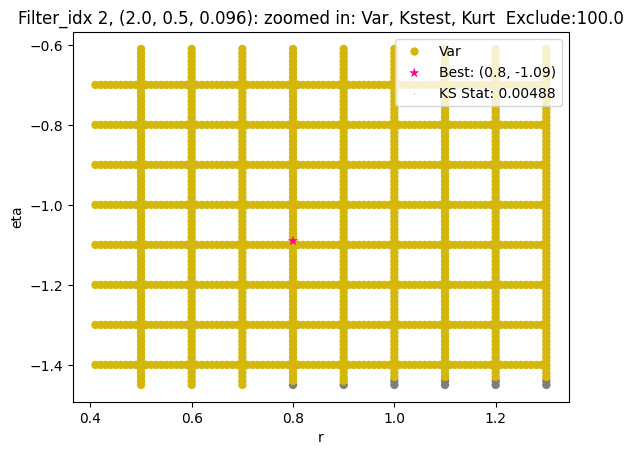

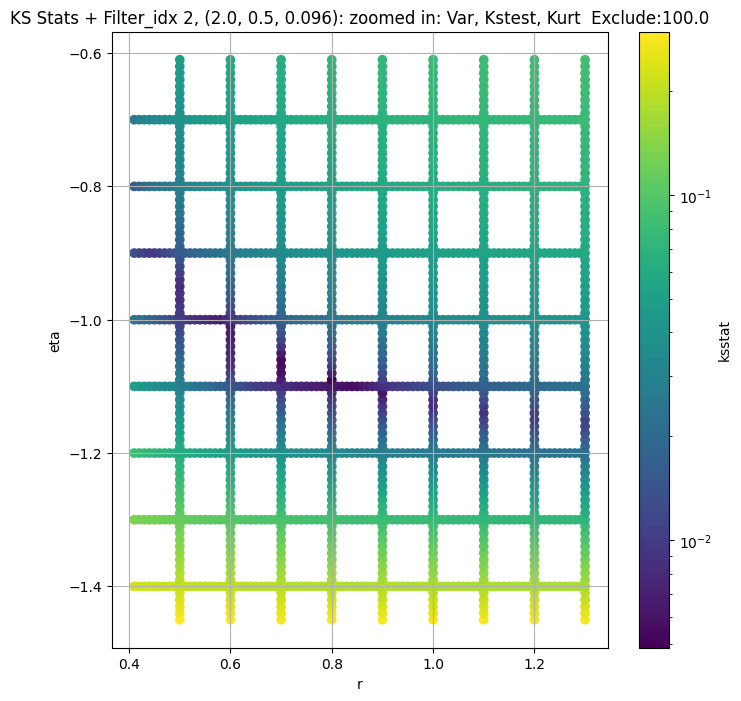

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + 100 = 150, ksstat: 0.005104996190807731, var: 2709.946044921875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + 75 = 125, ksstat: 0.004855500969427107, var: 2751.4267578125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + 50 = 100, ksstat: 0.004518062529540012, var: 2795.673583984375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + 25 = 75, ksstat: 0.004021170208828473, var: 2843.397216796875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + 0 = 50, ksstat: 0.003634894207655795, var: 2895.647705078125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + -25 = 25, ksstat: 0.0036116240655497955, var: 2956.12158203125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 3, 50.0 + -50 = 0, ksstat: 0.0031215683298183583, var: 3045.216064453125
Number of samples: 100000, Without approximation : 65536000.0


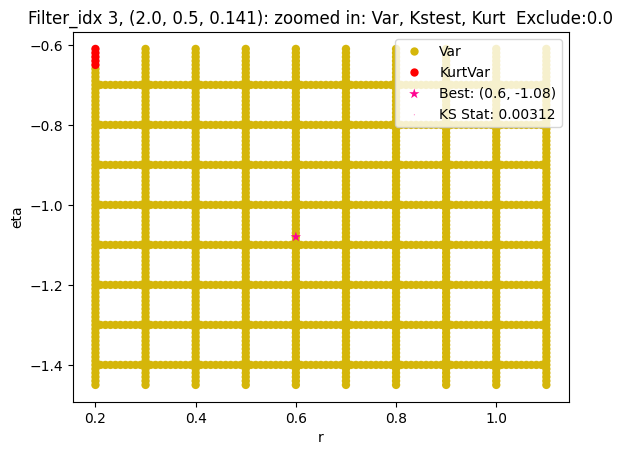

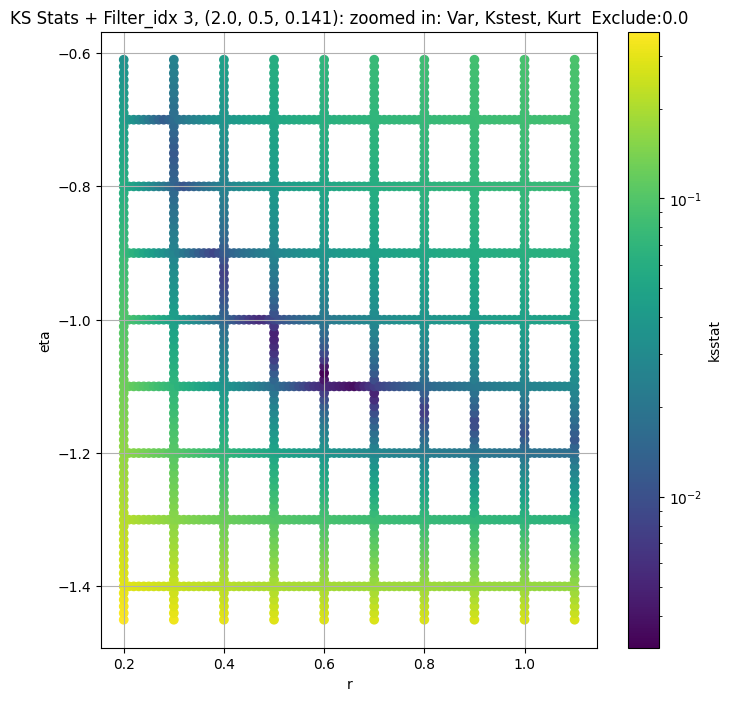

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 100 = 150, ksstat: 0.005228081755805025, var: 1152.8736572265625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 75 = 125, ksstat: 0.004818895630460007, var: 1170.7503662109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 50 = 100, ksstat: 0.004303439831132128, var: 1189.896240234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 25 = 75, ksstat: 0.004258813350423718, var: 1210.8150634765625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 0 = 50, ksstat: 0.004258091090198812, var: 1234.15234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + -25 = 25, ksstat: 0.0042568562382303, var: 1261.303955078125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + -50 = 0, ksstat: 0.004256804673579029, var: 1302.0853271484375
Number of samples: 100000, Without approximation : 65536000.0


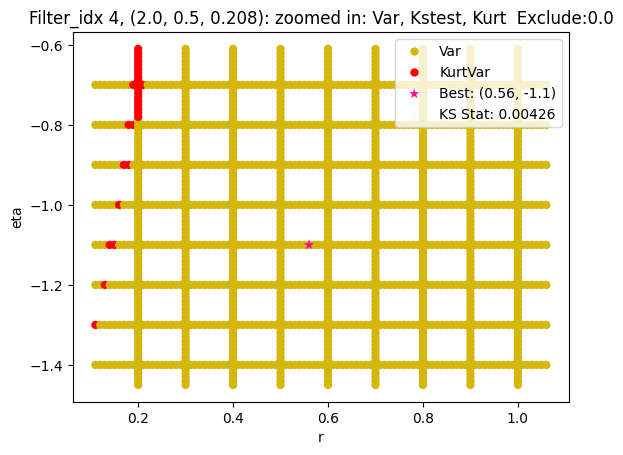

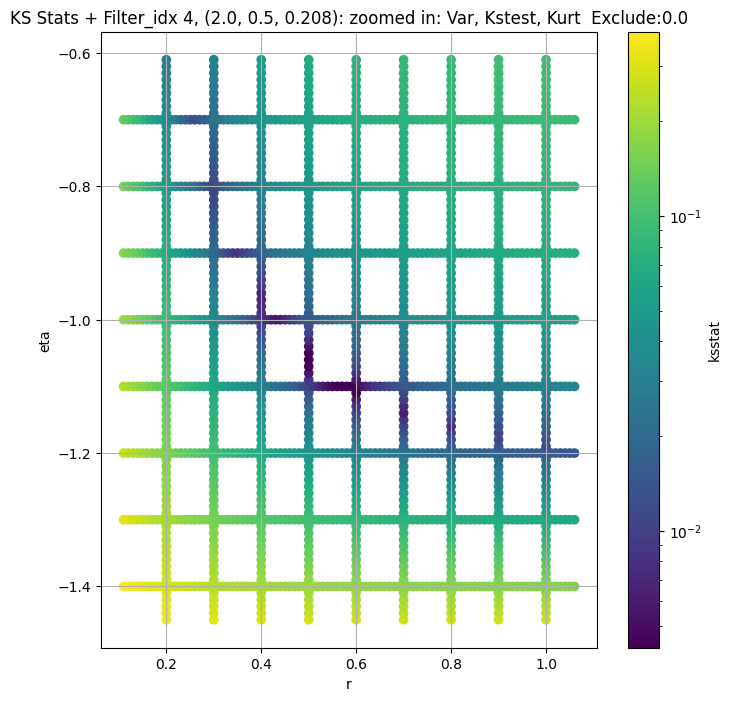

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + 100 = 300, ksstat: 0.009471898324290295, var: 408.667236328125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + 75 = 275, ksstat: 0.009472168631883715, var: 414.52801513671875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + 50 = 250, ksstat: 0.009470898485002377, var: 420.65423583984375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + 25 = 225, ksstat: 0.009466153457965754, var: 427.0775146484375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + 0 = 200, ksstat: 0.009472377267756293, var: 433.82672119140625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + -25 = 175, ksstat: 0.009472681848791853, var: 440.93719482421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + -50 = 150, ksstat: 0.009471080026627887, var: 448.46282958984375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + -75 = 125, ksstat: 0.009471422788190131, var: 456.4674987792969


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 5, 200.0 + -100 = 100, ksstat: 0.00947177969396118, var: 465.03240966796875
Number of samples: 100000, Without approximation : 65536000.0


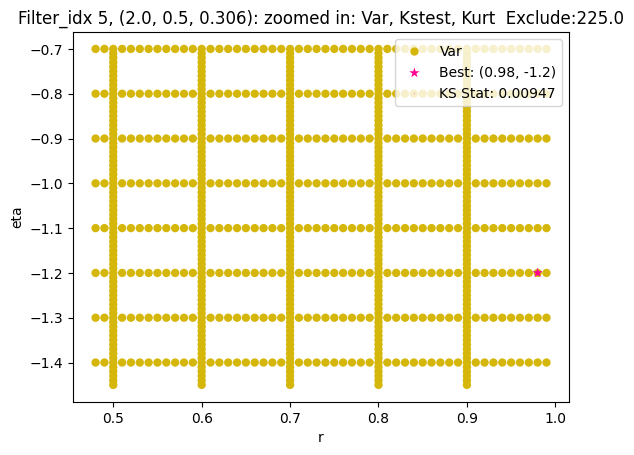

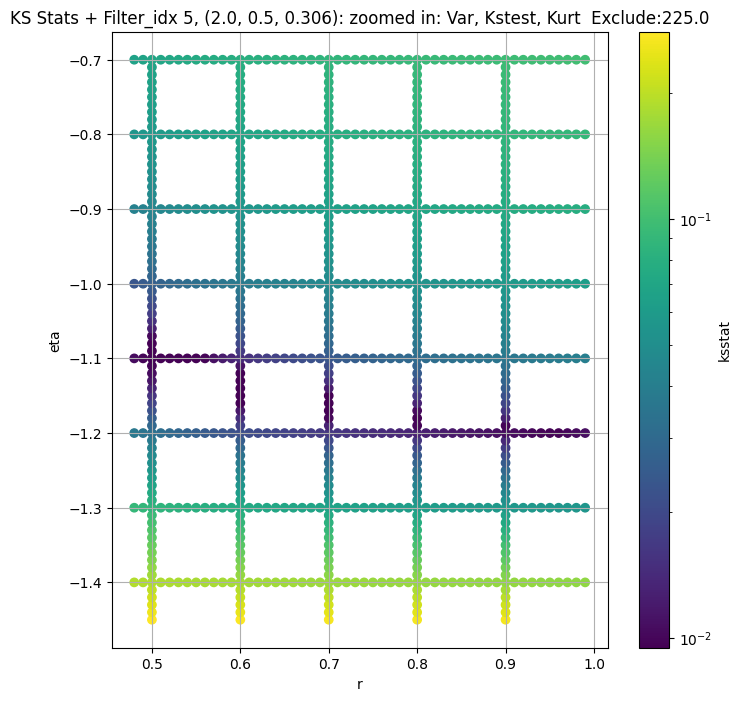

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + 100 = 200, ksstat: 0.010303420775032768, var: 302.2656555175781


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + 75 = 175, ksstat: 0.010303776920564611, var: 306.9414978027344


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + 50 = 150, ksstat: 0.010303307858115007, var: 311.8799133300781


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + 25 = 125, ksstat: 0.010303399046819539, var: 317.12005615234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + 0 = 100, ksstat: 0.010303501364045675, var: 322.72564697265625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + -25 = 75, ksstat: 0.01030329322020651, var: 328.7511901855469


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + -50 = 50, ksstat: 0.010303419799568836, var: 335.3146057128906


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + -75 = 25, ksstat: 0.010303249984476792, var: 343.0259094238281


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 100.0 + -100 = 0, ksstat: 0.01030326856820818, var: 354.43408203125
Number of samples: 100000, Without approximation : 65536000.0


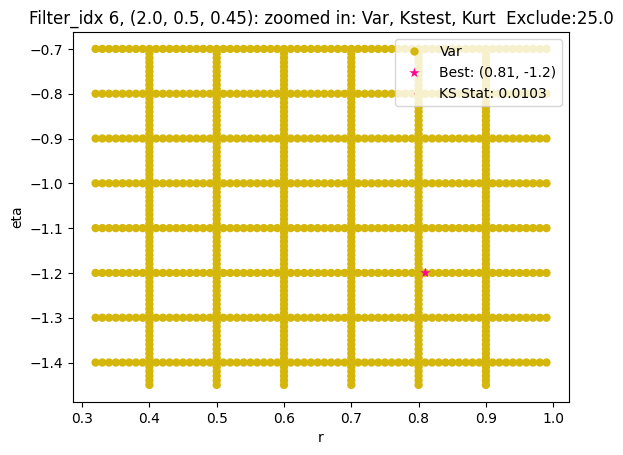

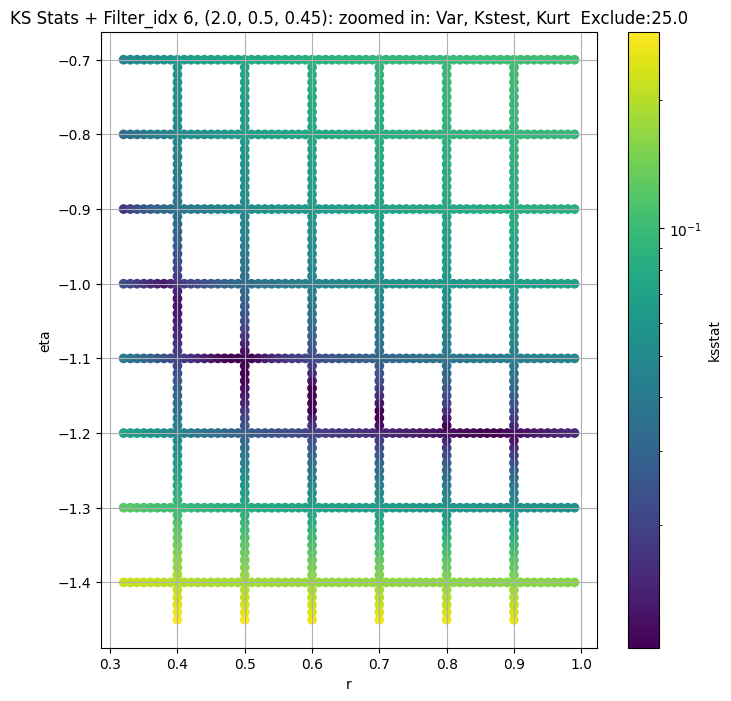

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.004598076168249032, var: 67856.890625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.0040784231271301374, var: 68823.9609375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.0035691972588233548, var: 69878.25


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.003087490931968695, var: 71066.3984375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.0024427221359299353, var: 72789.0
Number of samples: 100000, Without approximation : 65536000.0


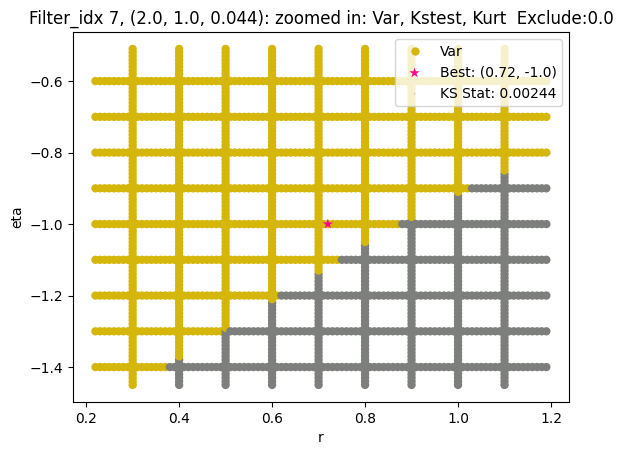

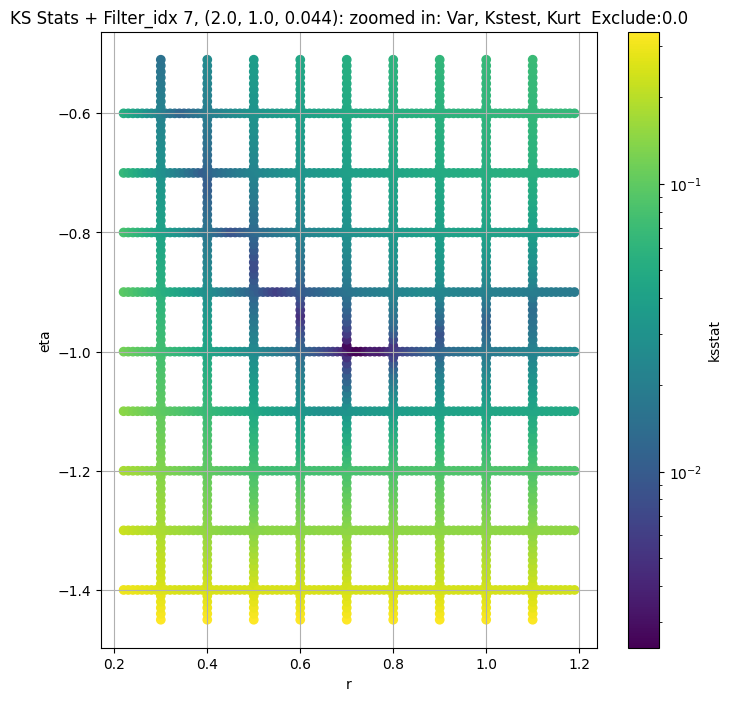

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 100 = 100, ksstat: 0.0037836118098321103, var: 25158.7890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 75 = 75, ksstat: 0.00329736135883707, var: 25561.63671875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 50 = 50, ksstat: 0.0031138900619266385, var: 26009.05859375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 25 = 25, ksstat: 0.0025621689081493093, var: 26522.845703125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 0 = 0, ksstat: 0.0020933568084184305, var: 27265.47265625
Number of samples: 100000, Without approximation : 65536000.0


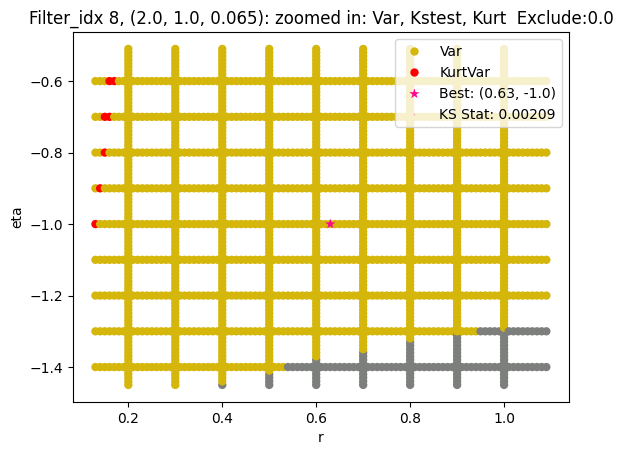

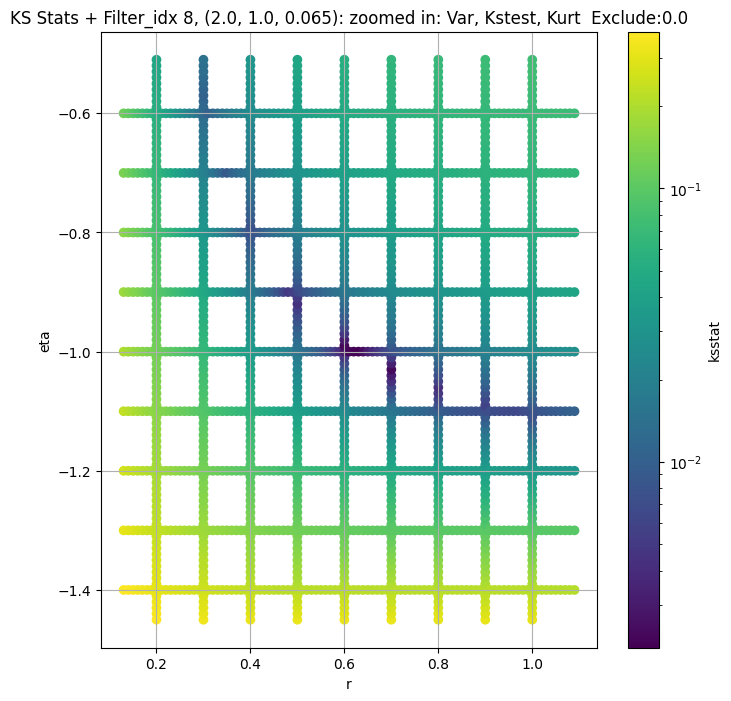

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 0.0 + 100 = 100, ksstat: 0.0037816850475668184, var: 9632.7470703125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 0.0 + 75 = 75, ksstat: 0.0032693696409510607, var: 9803.3759765625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 0.0 + 50 = 50, ksstat: 0.0033390151774100874, var: 9992.5849609375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 0.0 + 25 = 25, ksstat: 0.0026530458748963426, var: 10211.4560546875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 0.0 + 0 = 0, ksstat: 0.002641232991283715, var: 10545.251953125
Number of samples: 100000, Without approximation : 65536000.0


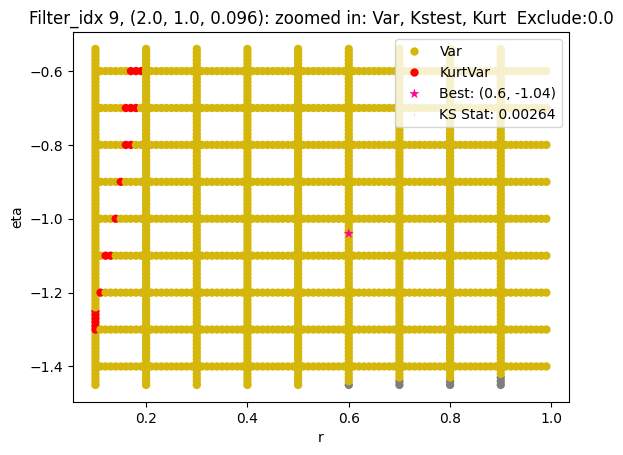

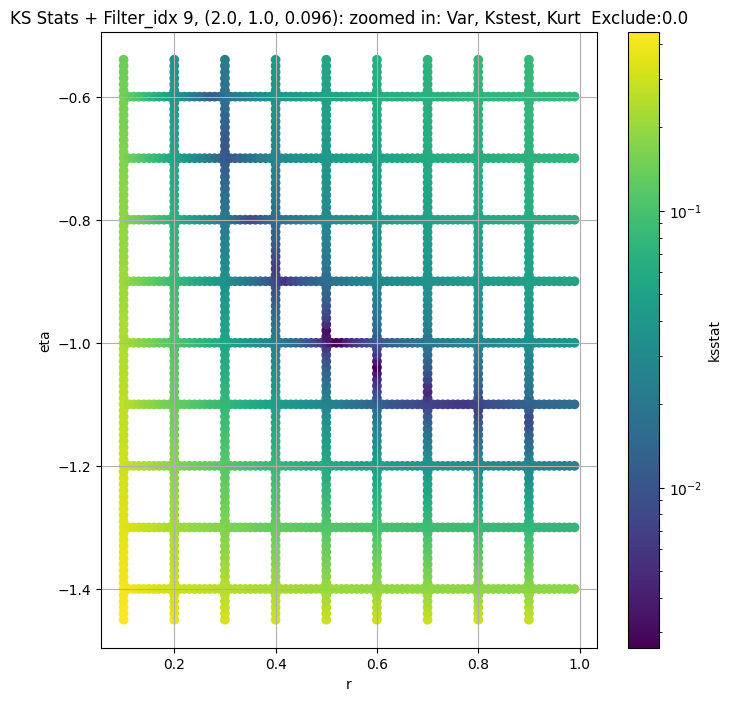

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.003691630364930046, var: 3734.401611328125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.003139028940736588, var: 3808.19873046875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.0025747967944717565, var: 3892.169921875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.003229160949688281, var: 3991.378173828125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0023343287152373104, var: 4141.93212890625
Number of samples: 100000, Without approximation : 65536000.0


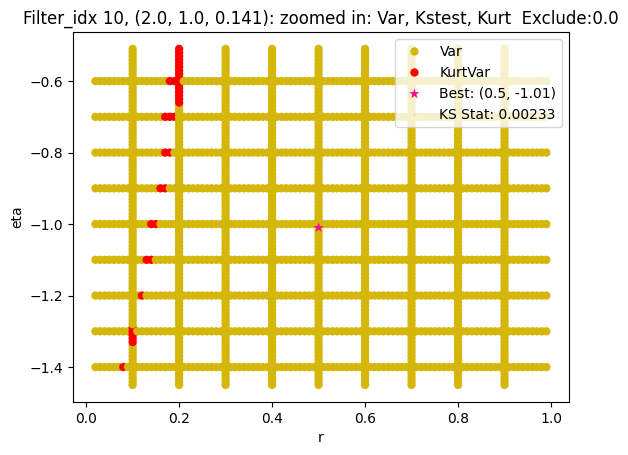

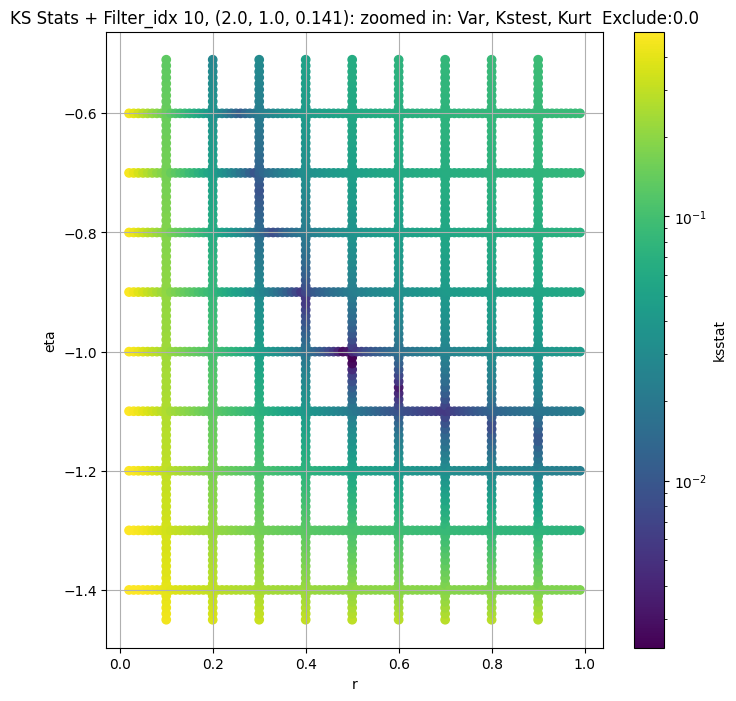

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.0038182967026020344, var: 1464.8602294921875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.003408193987366581, var: 1491.6563720703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.0030653676754199832, var: 1520.68115234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.002810633382530181, var: 1552.842529296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.002795815867137841, var: 1589.7109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.0027974612884444916, var: 1633.966064453125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.002796790576369723, var: 1701.6533203125
Number of samples: 100000, Without approximation : 65536000.0


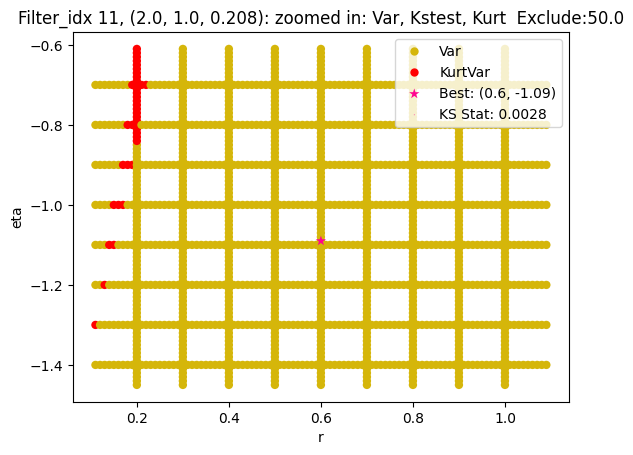

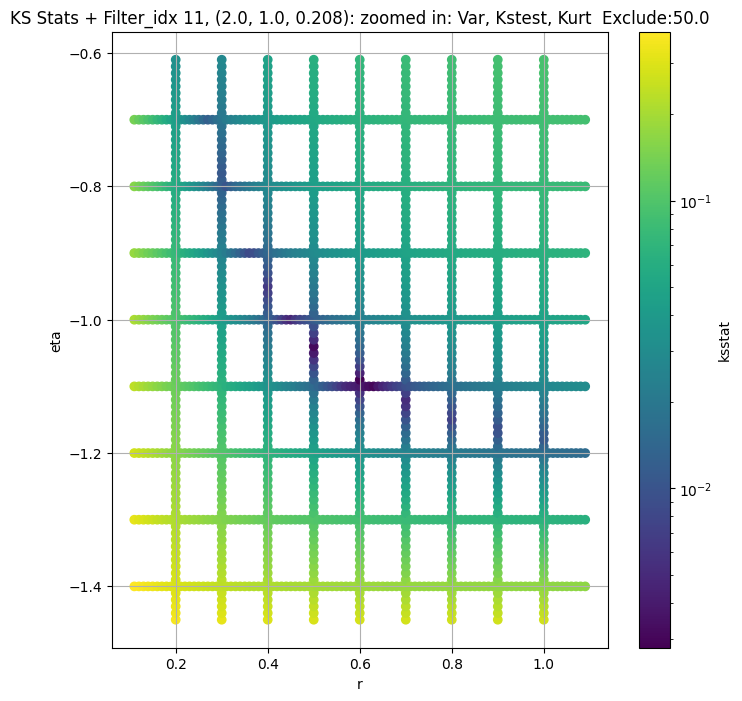

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.00600968081067943, var: 644.3011474609375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.006009469083898655, var: 658.775390625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.006009262345196442, var: 675.3468627929688


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.006009558532717119, var: 695.0596923828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.006008452349157645, var: 724.9697875976562
Number of samples: 100000, Without approximation : 65536000.0


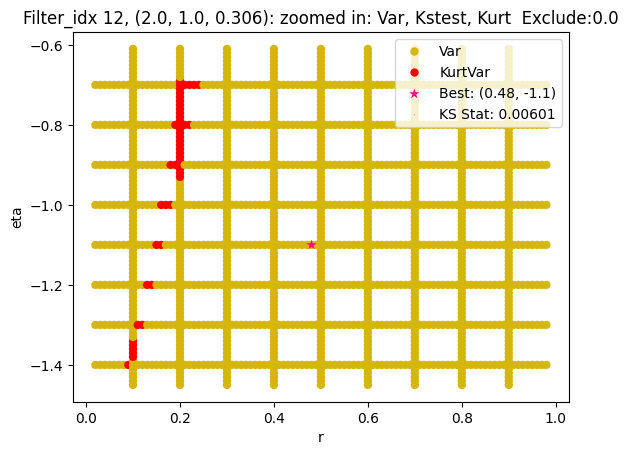

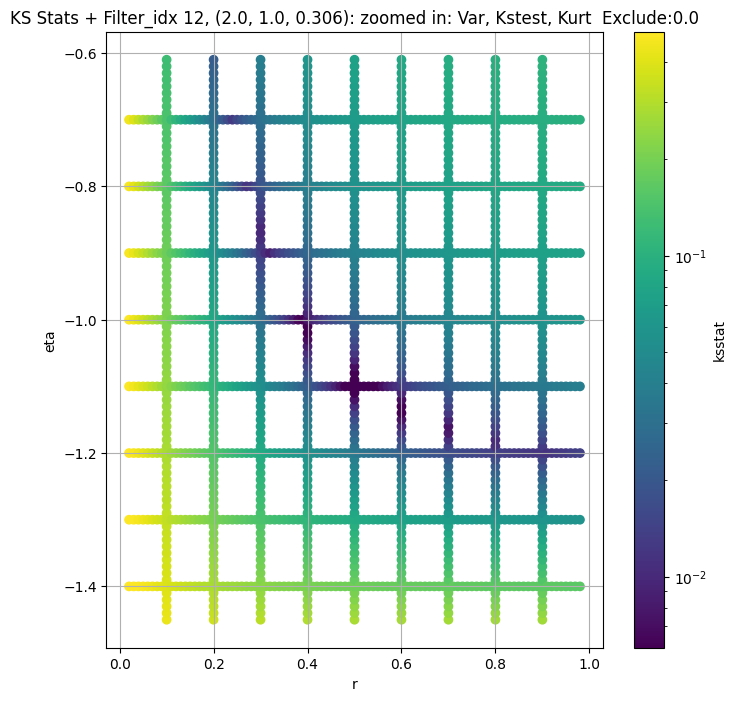

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.010551598934573858, var: 290.32891845703125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.010551535781609944, var: 294.9107360839844


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.010551470178402855, var: 299.7159423828125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.01055140355917239, var: 304.7720031738281


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.010551337631699242, var: 310.11077880859375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.010551274312299352, var: 315.7684631347656


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.010551218048416355, var: 321.8050537109375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.010551170843907665, var: 328.2653503417969


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.010552008840978344, var: 335.3576354980469
Number of samples: 100000, Without approximation : 65536000.0


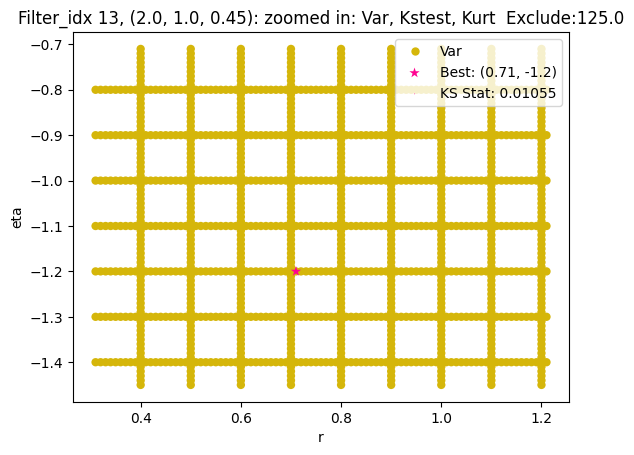

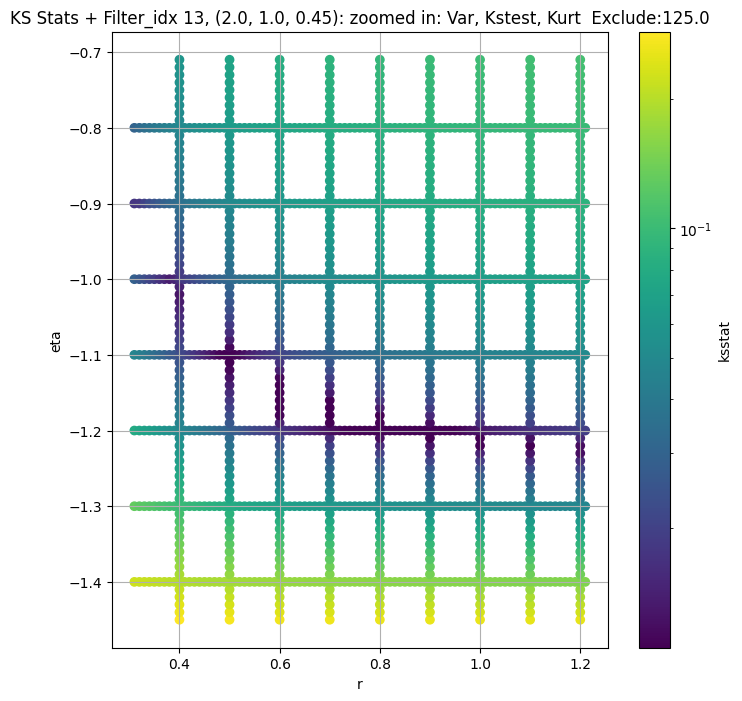

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.005119020343323066, var: 46603.4609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.0050968562962003805, var: 47246.5078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.004617679464628252, var: 47956.04296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.0047202682978556565, var: 48777.94921875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.003835507975839314, var: 50029.69140625
Number of samples: 100000, Without approximation : 65536000.0


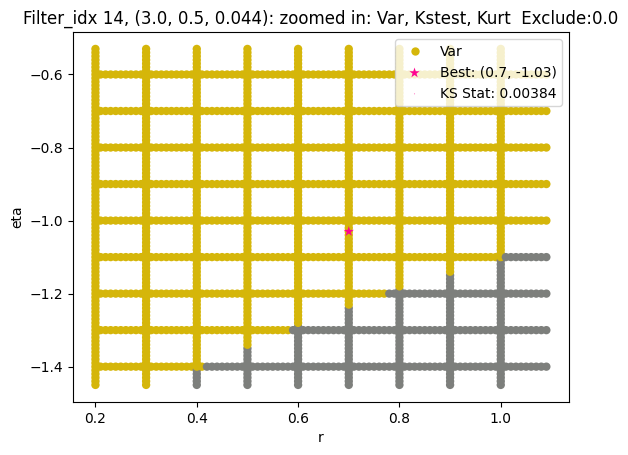

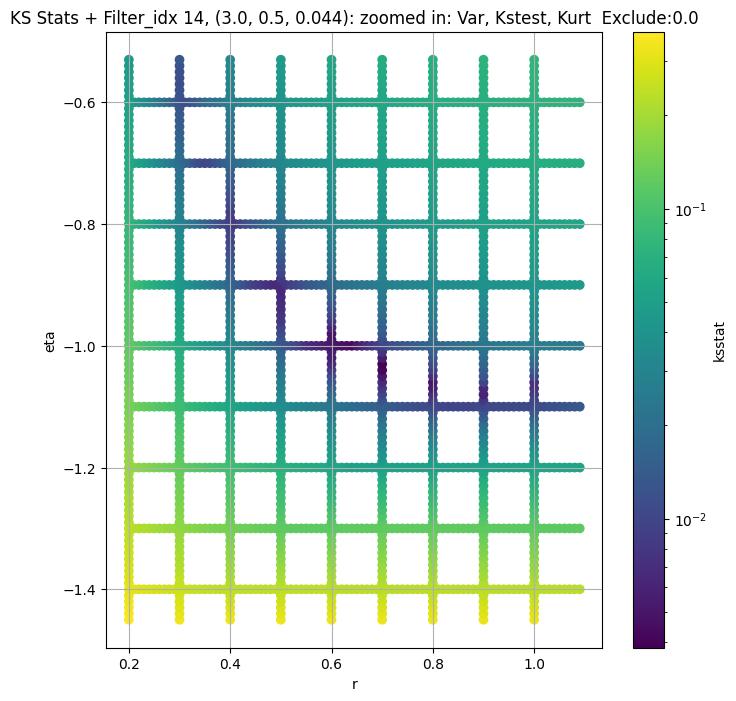

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.005982436569654248, var: 16858.84375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.0054248209017196125, var: 17133.716796875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.004925931152080065, var: 17439.75390625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.004931875254650164, var: 17792.681640625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.004477814815617043, var: 18344.751953125
Number of samples: 100000, Without approximation : 65536000.0


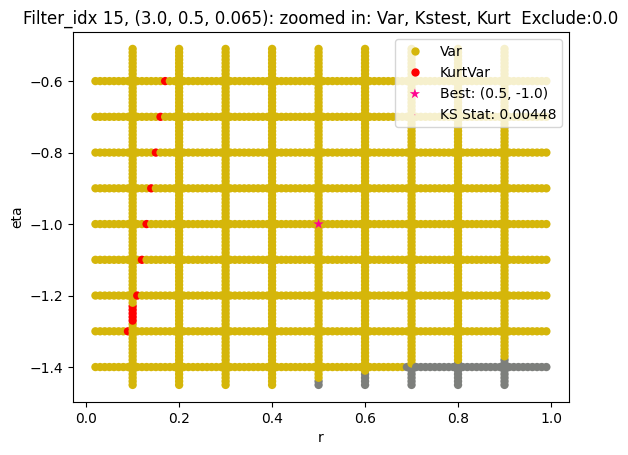

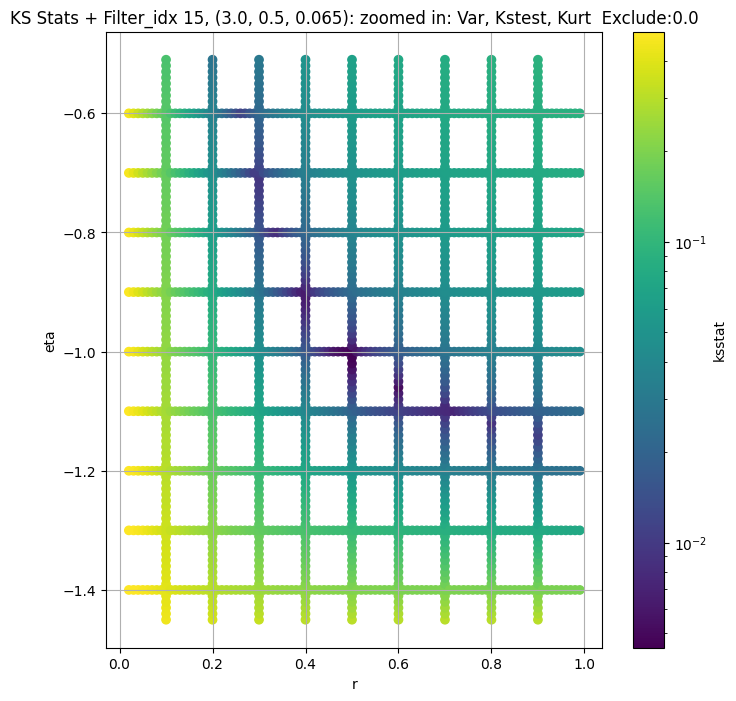

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + 100 = 200, ksstat: 0.006082924104674092, var: 6136.2080078125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + 75 = 175, ksstat: 0.006071986686082068, var: 6225.298828125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + 50 = 150, ksstat: 0.005593158435223788, var: 6319.88623046875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + 25 = 125, ksstat: 0.005461120802684127, var: 6421.029296875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + 0 = 100, ksstat: 0.00544979082216962, var: 6530.06103515625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + -25 = 75, ksstat: 0.00523438517394581, var: 6649.744140625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + -50 = 50, ksstat: 0.0045732872122981605, var: 6783.951171875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + -75 = 25, ksstat: 0.0039336406163996696, var: 6942.37060546875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 100.0 + -100 = 0, ksstat: 0.00365121643168842, var: 7200.64892578125
Number of samples: 100000, Without approximation : 65536000.0


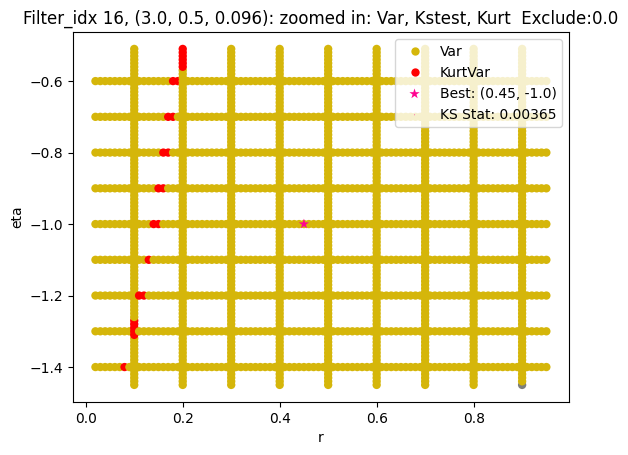

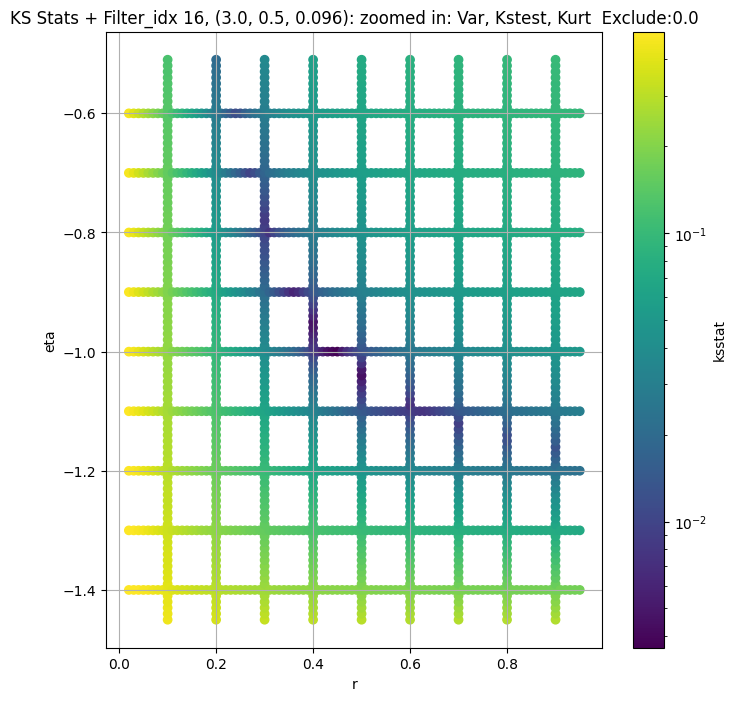

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.00497384112848176, var: 2622.318603515625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.004472493649387094, var: 2675.261962890625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.004149011683933224, var: 2734.896240234375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.004255808111108483, var: 2805.09912109375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.0035222557134531873, var: 2915.95703125
Number of samples: 100000, Without approximation : 65536000.0


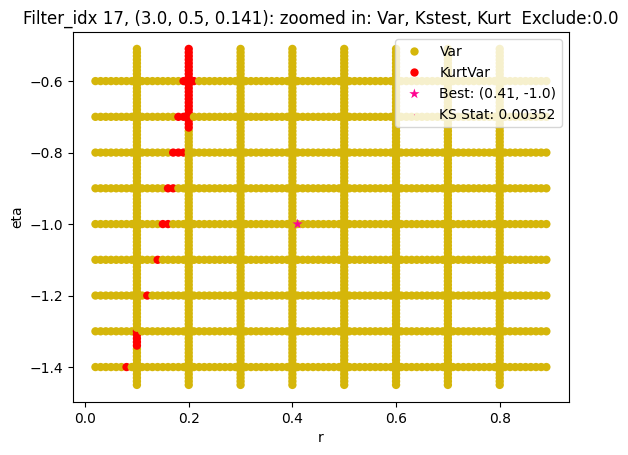

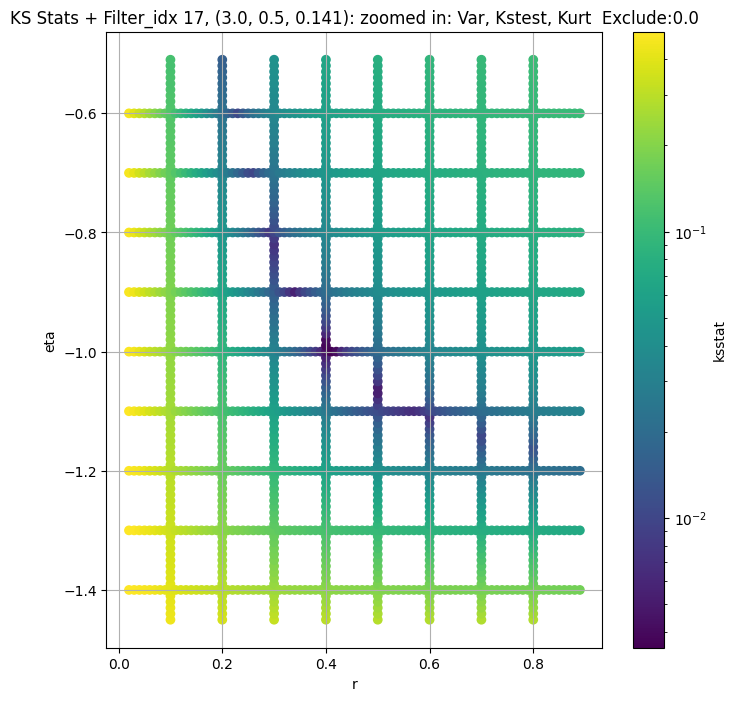

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.005326618083488242, var: 1058.375244140625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.0049519909830015515, var: 1078.1297607421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.004549831532713822, var: 1099.7138671875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.004110571765471985, var: 1123.64111328125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.004046957395161421, var: 1150.9287109375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.004279687603454541, var: 1183.184814453125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.0033459280831713845, var: 1236.505615234375
Number of samples: 100000, Without approximation : 65536000.0


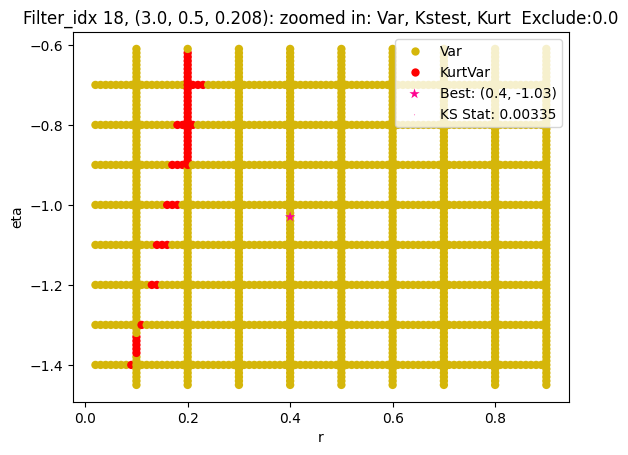

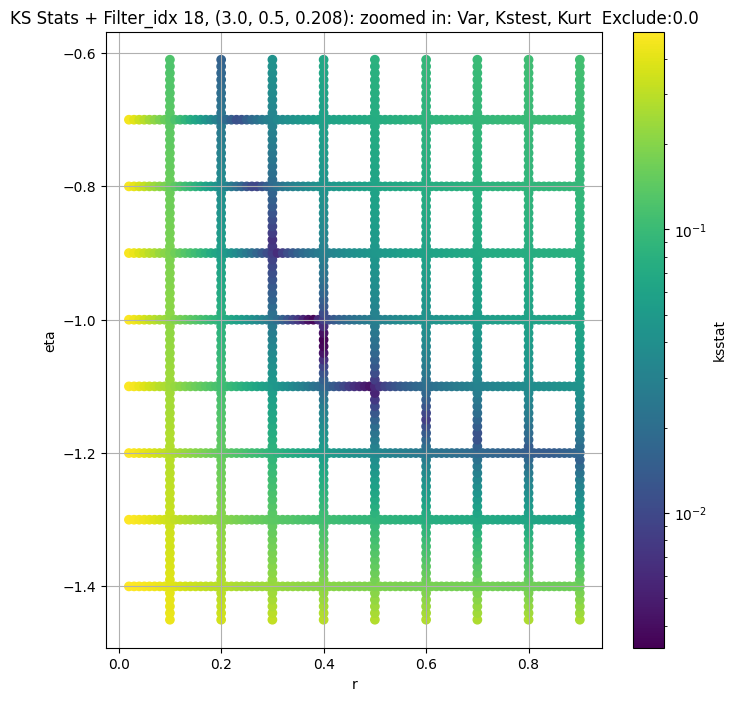

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + 100 = 300, ksstat: 0.006422419390195028, var: 427.0111389160156


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + 75 = 275, ksstat: 0.006660000689989058, var: 433.7763977050781


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + 50 = 250, ksstat: 0.006298532062135563, var: 440.8609313964844


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + 25 = 225, ksstat: 0.005838841292967089, var: 448.29412841796875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + 0 = 200, ksstat: 0.005457665063513195, var: 456.1118469238281


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + -25 = 175, ksstat: 0.004965914377056065, var: 464.3730773925781


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + -50 = 150, ksstat: 0.004948546044656887, var: 473.11639404296875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + -75 = 125, ksstat: 0.005040484155534486, var: 482.4964294433594


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 19, 200.0 + -100 = 100, ksstat: 0.0046453091795309875, var: 492.7156677246094
Number of samples: 100000, Without approximation : 65536000.0


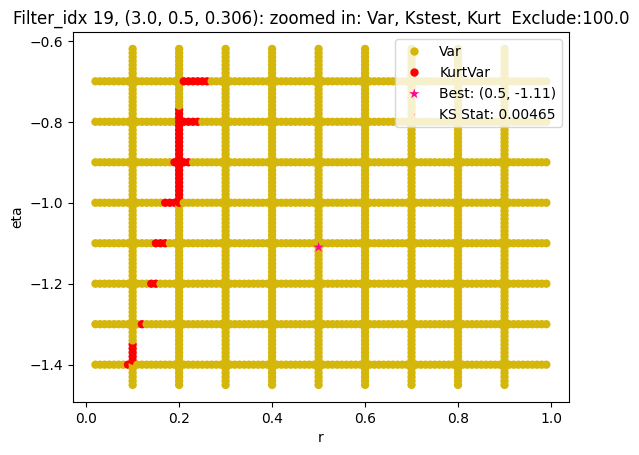

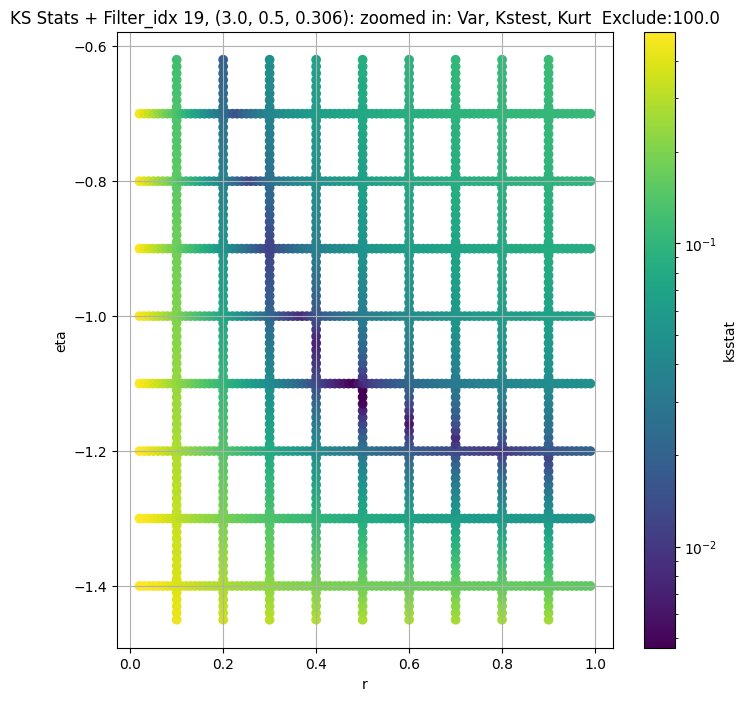

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + 100 = 300, ksstat: 0.009049090968648685, var: 216.78048706054688


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + 75 = 275, ksstat: 0.008804921881123251, var: 220.4365997314453


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + 50 = 250, ksstat: 0.009215108086923496, var: 224.27342224121094


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + 25 = 225, ksstat: 0.009417930364972849, var: 228.30909729003906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + 0 = 200, ksstat: 0.009305562262313216, var: 232.56932067871094


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + -25 = 175, ksstat: 0.00929026801443189, var: 237.0789337158203


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + -50 = 150, ksstat: 0.008437636332973453, var: 241.8773193359375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + -75 = 125, ksstat: 0.007906332922692383, var: 247.02880859375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 20, 200.0 + -100 = 100, ksstat: 0.008897971286812412, var: 252.5862579345703
Number of samples: 100000, Without approximation : 65536000.0


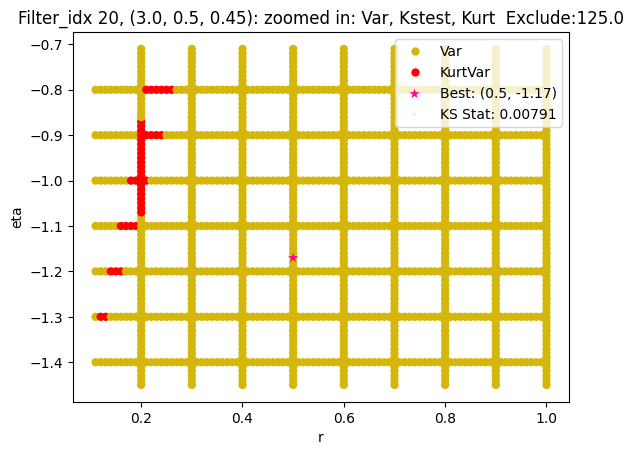

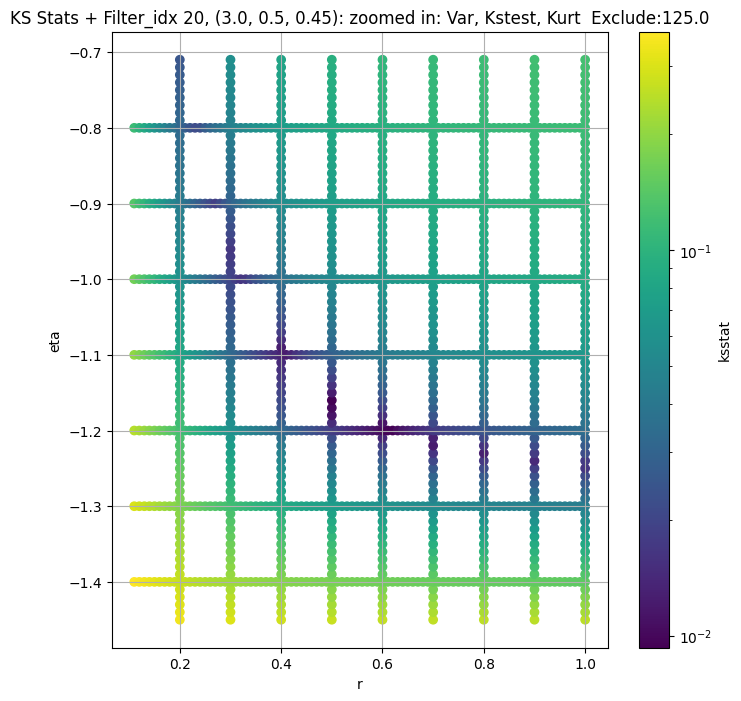

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.00537378236912972, var: 51374.4921875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.005143085281341331, var: 52239.71484375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.0045876802666463545, var: 53174.37109375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.004347505464390444, var: 54197.1875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.004431905664703195, var: 55326.82421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.004498028609193905, var: 56622.17578125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.003677483436716922, var: 58546.015625
Number of samples: 100000, Without approximation : 65536000.0


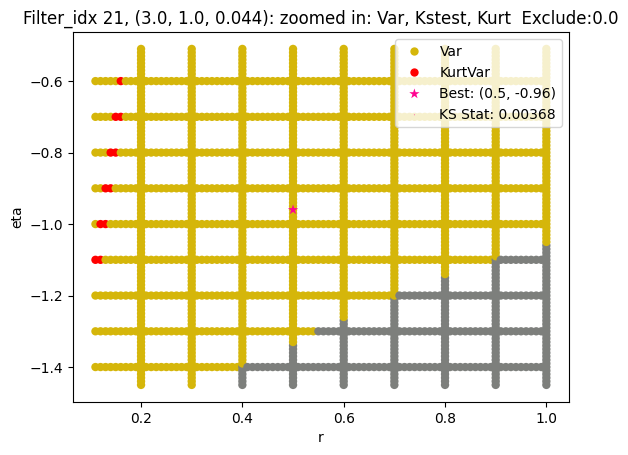

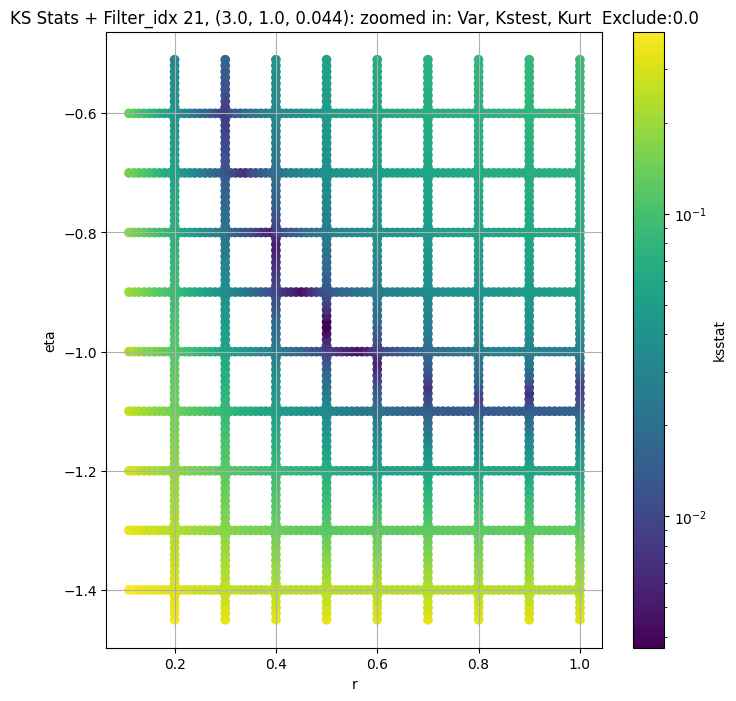

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + 100 = 200, ksstat: 0.005519639730803383, var: 17815.23046875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + 75 = 175, ksstat: 0.005522168568541153, var: 18135.17578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + 50 = 150, ksstat: 0.005144875816633587, var: 18478.32421875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + 25 = 125, ksstat: 0.004923557669555878, var: 18848.564453125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + 0 = 100, ksstat: 0.004415792476211711, var: 19252.833984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + -25 = 75, ksstat: 0.004178272623173163, var: 19698.96875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + -50 = 50, ksstat: 0.004387074128052559, var: 20198.35546875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + -75 = 25, ksstat: 0.003948036696091381, var: 20787.2578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 100.0 + -100 = 0, ksstat: 0.0027618621790107545, var: 21690.966796875
Number of samples: 100000, Without approximation : 65536000.0


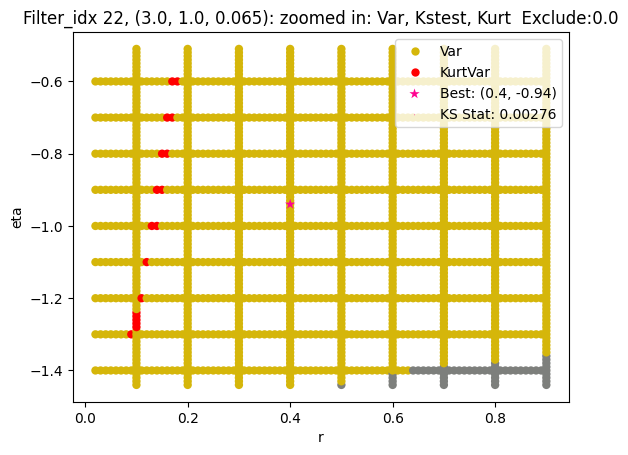

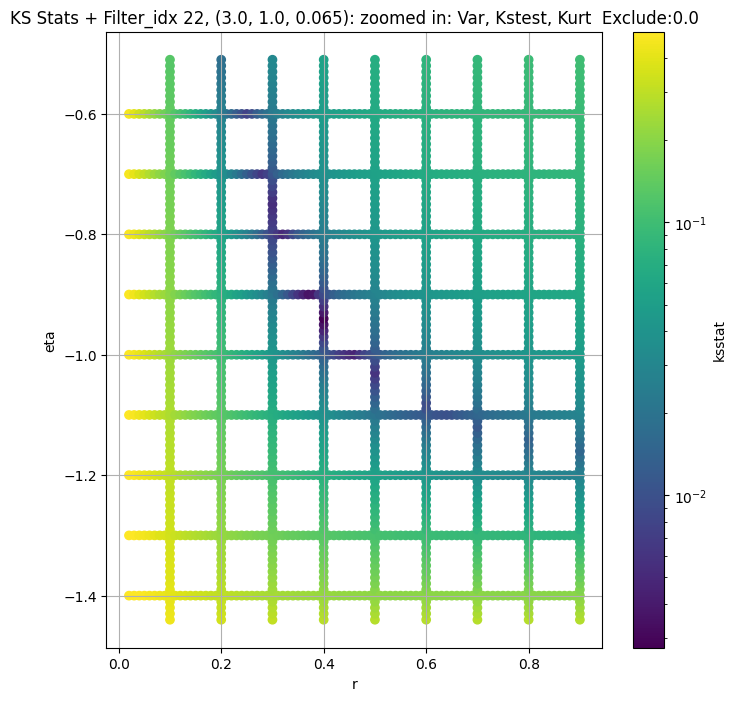

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + 100 = 300, ksstat: 0.006984491560852457, var: 6117.91796875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + 75 = 275, ksstat: 0.00647817434946607, var: 6217.669921875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + 50 = 250, ksstat: 0.0060669093152325715, var: 6323.40087890625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + 25 = 225, ksstat: 0.006262845252062665, var: 6435.818359375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + 0 = 200, ksstat: 0.00585576041082958, var: 6555.8828125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + -25 = 175, ksstat: 0.00533619410225869, var: 6685.00927734375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + -50 = 150, ksstat: 0.004787620066383787, var: 6824.6748046875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + -75 = 125, ksstat: 0.004652316948242169, var: 6976.93017578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 23, 200.0 + -100 = 100, ksstat: 0.00438829955038289, var: 7144.23193359375
Number of samples: 100000, Without approximation : 65536000.0


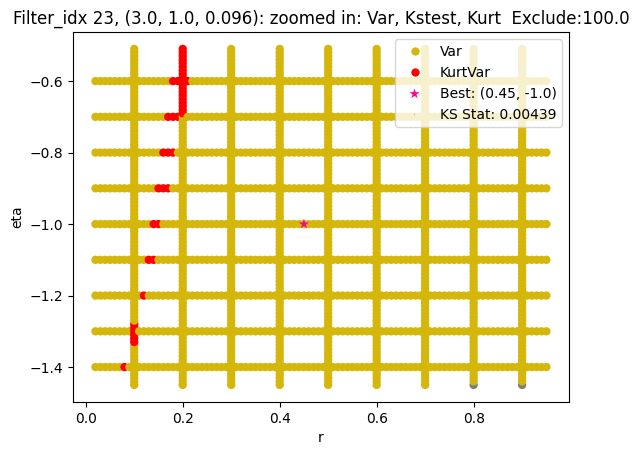

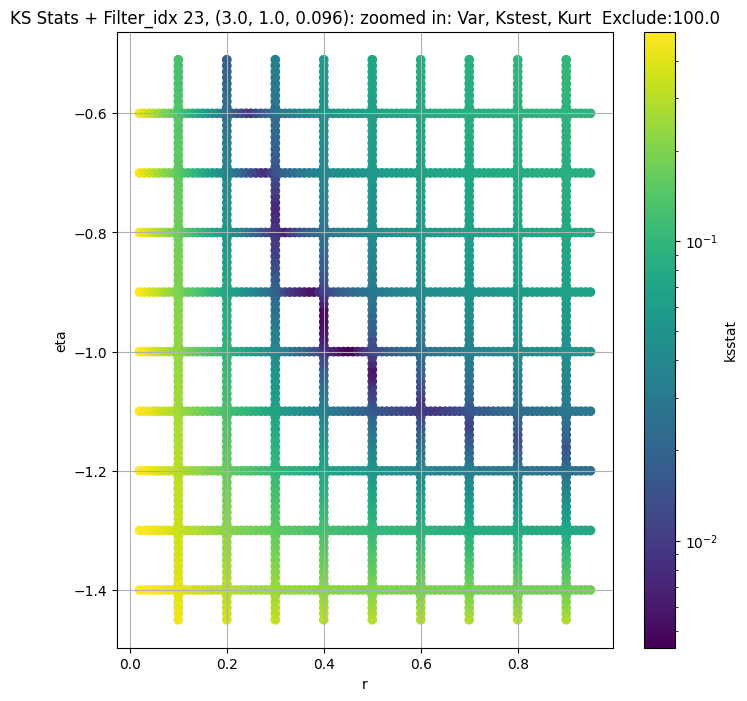

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + 100 = 150, ksstat: 0.004819435258361482, var: 2719.248046875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + 75 = 125, ksstat: 0.004545007874092878, var: 2783.196044921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + 50 = 100, ksstat: 0.004037490909627572, var: 2854.6025390625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + 25 = 75, ksstat: 0.0036738003669175567, var: 2935.55859375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + 0 = 50, ksstat: 0.0035574926988671818, var: 3028.9052734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + -25 = 25, ksstat: 0.0037346302159432243, var: 3140.9755859375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 24, 50.0 + -50 = 0, ksstat: 0.0024750935023694354, var: 3318.33349609375
Number of samples: 100000, Without approximation : 65536000.0


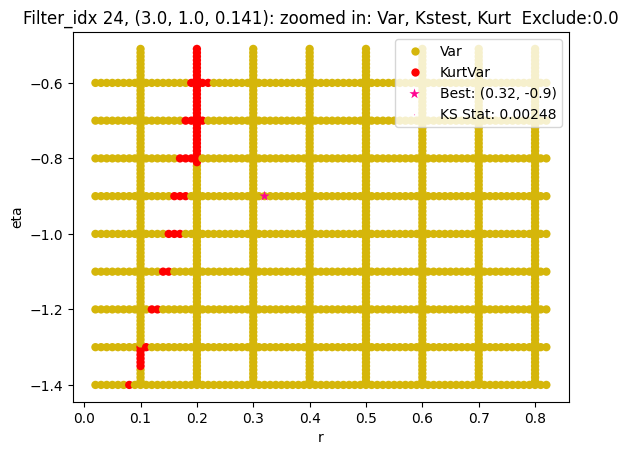

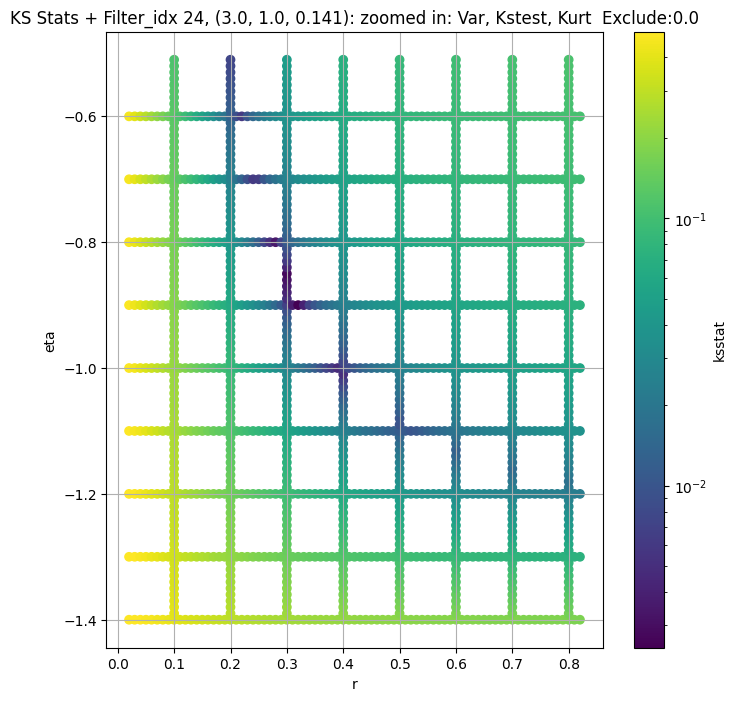

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.003982781514221934, var: 1142.81640625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.0033758545930253625, var: 1170.382080078125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.0037492095541151738, var: 1200.79833984375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.0032010747060846265, var: 1235.1429443359375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.002539220528028796, var: 1275.7452392578125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.0023723293048689698, var: 1326.225830078125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.0023863119818735012, var: 1405.927734375
Number of samples: 100000, Without approximation : 65536000.0


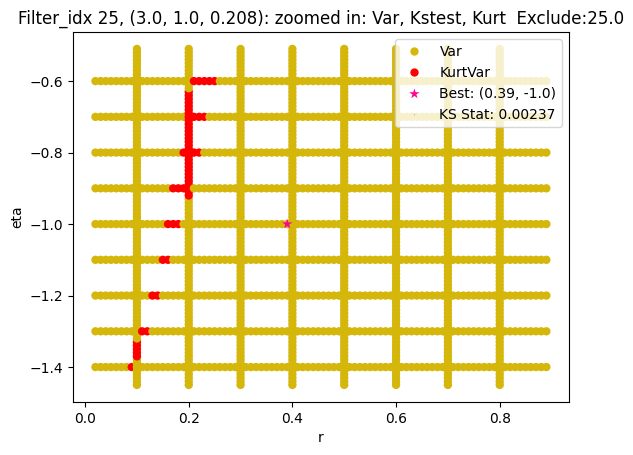

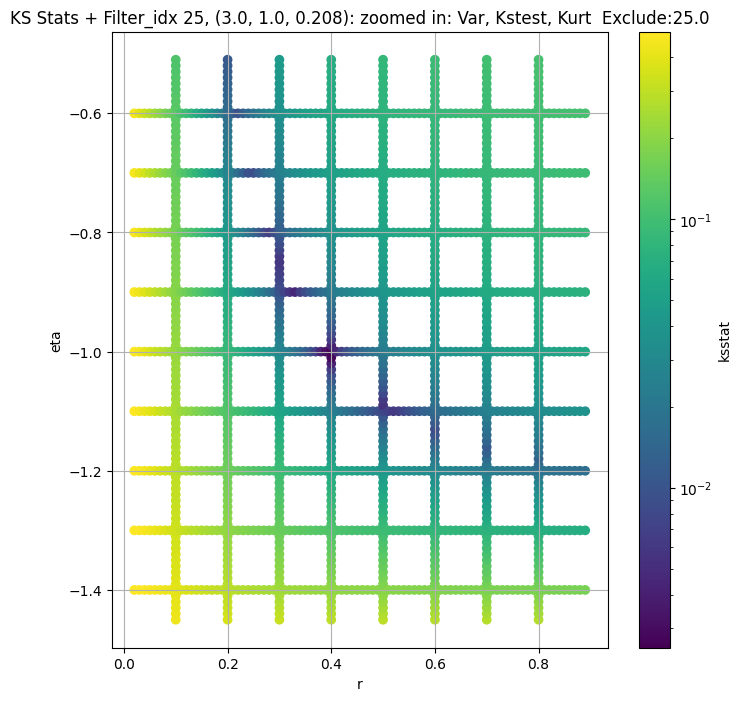

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + 100 = 200, ksstat: 0.004818159846791504, var: 481.7412109375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + 75 = 175, ksstat: 0.004631630330627329, var: 492.2515869140625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + 50 = 150, ksstat: 0.004221837121680939, var: 503.7429504394531


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + 25 = 125, ksstat: 0.0038536749233908374, var: 516.481689453125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + 0 = 100, ksstat: 0.0032732355415951916, var: 530.872802734375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + -25 = 75, ksstat: 0.003126067999950688, var: 547.4315185546875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + -50 = 50, ksstat: 0.0031257532353138884, var: 567.2098388671875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + -75 = 25, ksstat: 0.0031255100920597467, var: 591.8211669921875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 26, 100.0 + -100 = 0, ksstat: 0.0031511879463302916, var: 638.0120239257812
Number of samples: 100000, Without approximation : 65536000.0


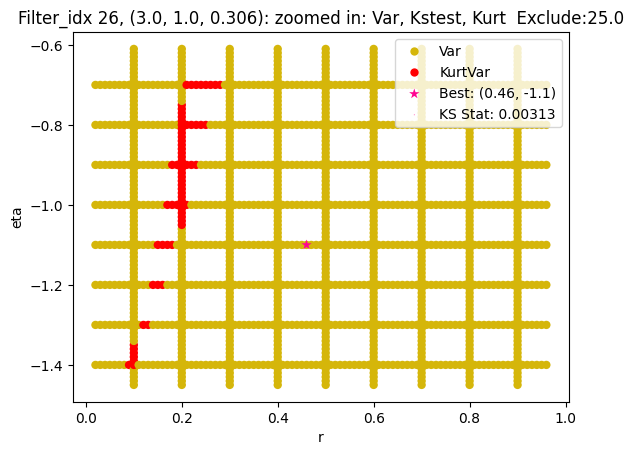

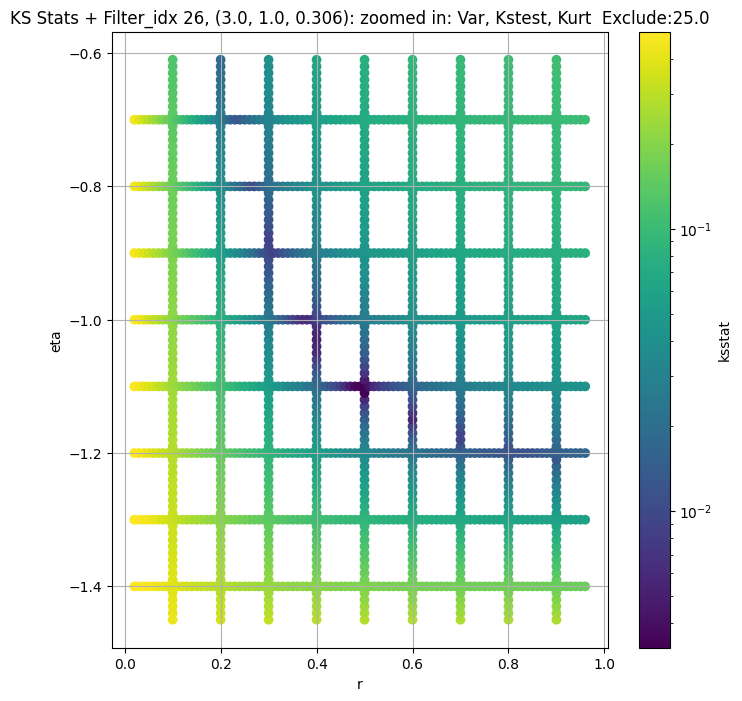

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + 100 = 300, ksstat: 0.008132280100787821, var: 212.88101196289062


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + 75 = 275, ksstat: 0.008719517624334205, var: 216.65321350097656


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + 50 = 250, ksstat: 0.009089416531337657, var: 220.6549530029297


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + 25 = 225, ksstat: 0.008510030592003393, var: 224.9196014404297


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + 0 = 200, ksstat: 0.008309328790334462, var: 229.4939727783203


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + -25 = 175, ksstat: 0.007492279891921673, var: 234.43637084960938


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + -50 = 150, ksstat: 0.0070433318929461475, var: 239.822021484375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + -75 = 125, ksstat: 0.008191884000858463, var: 245.75863647460938


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 27, 200.0 + -100 = 100, ksstat: 0.008171925567341254, var: 252.40562438964844
Number of samples: 100000, Without approximation : 65536000.0


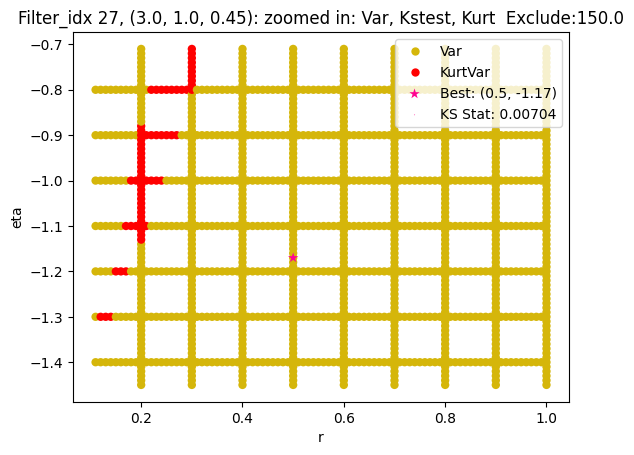

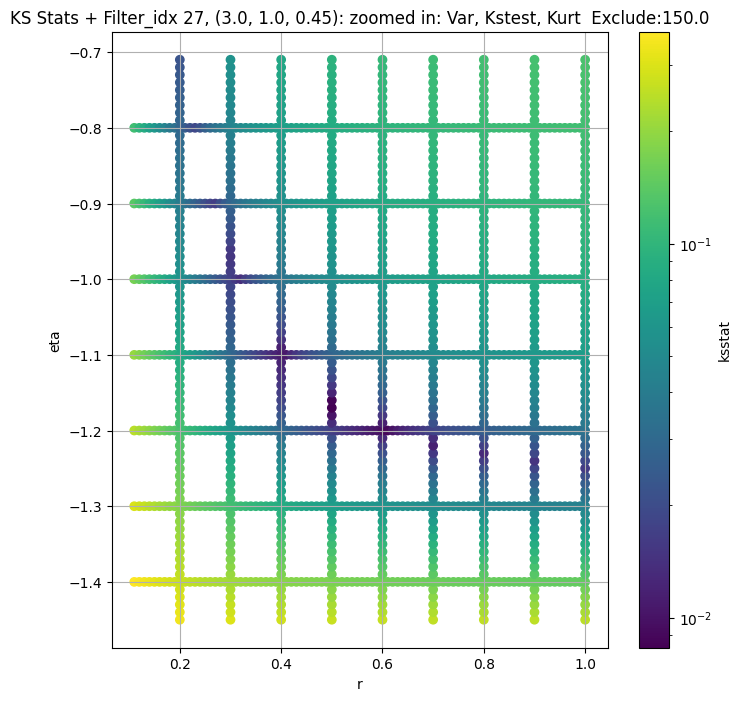

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.004196133064436065, var: 43024.75390625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0036942714427319334, var: 43676.046875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.0038031342416959824, var: 44397.484375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.003287966070773418, var: 45249.66796875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.003116921382348009, var: 46680.421875
Number of samples: 100000, Without approximation : 65536000.0


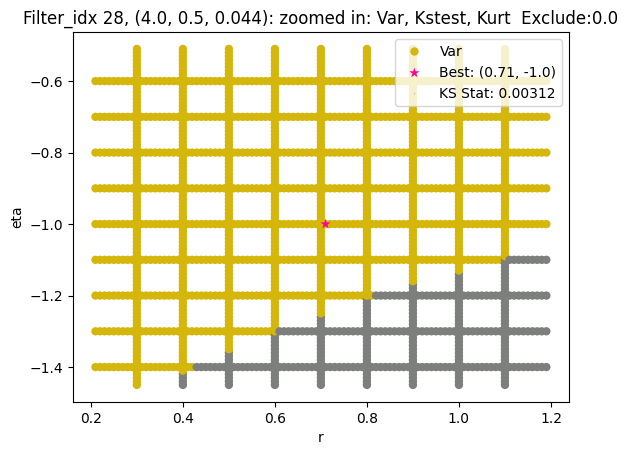

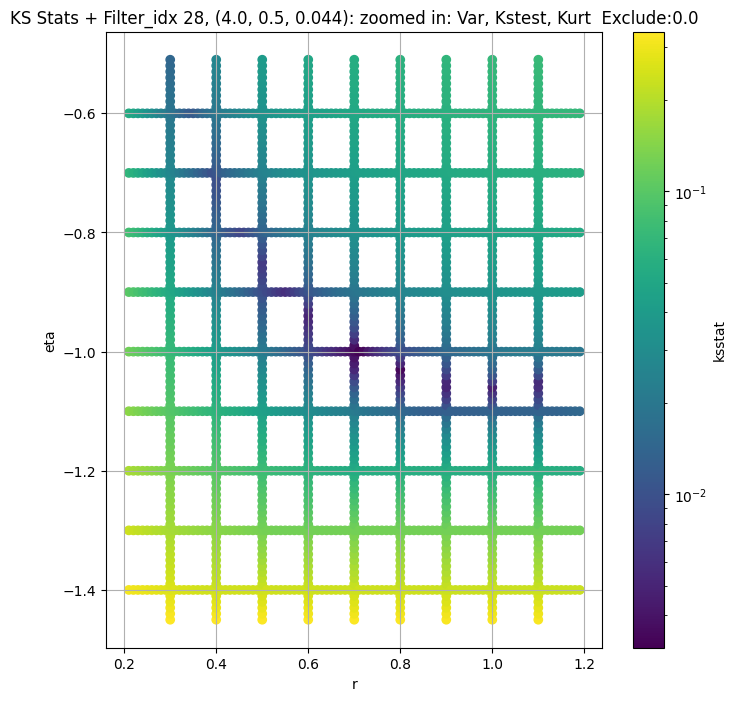

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.0051621551564352, var: 15713.390625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.005012823912388997, var: 15952.5166015625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.004918702672782632, var: 16211.0205078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.004395990493522767, var: 16493.935546875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.004192704643427858, var: 16810.8125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.004180646030003038, var: 17184.359375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.0036556303296345627, var: 17822.119140625
Number of samples: 100000, Without approximation : 65536000.0


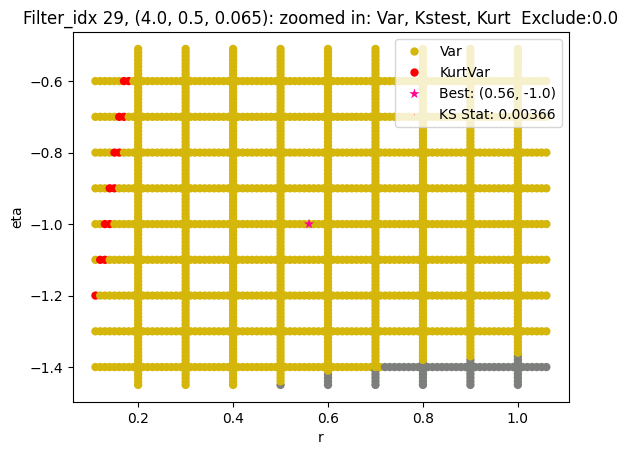

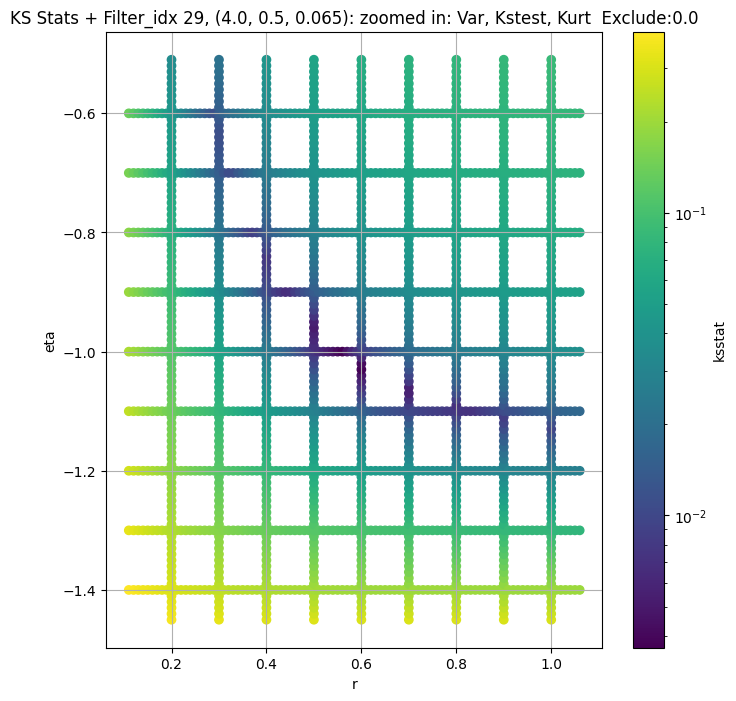

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.005336177312892126, var: 6204.9345703125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.004481481433789791, var: 6323.93017578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.004650891975010563, var: 6458.89990234375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.004481125495323049, var: 6621.07568359375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.0034202601786834097, var: 6923.03564453125
Number of samples: 100000, Without approximation : 65536000.0


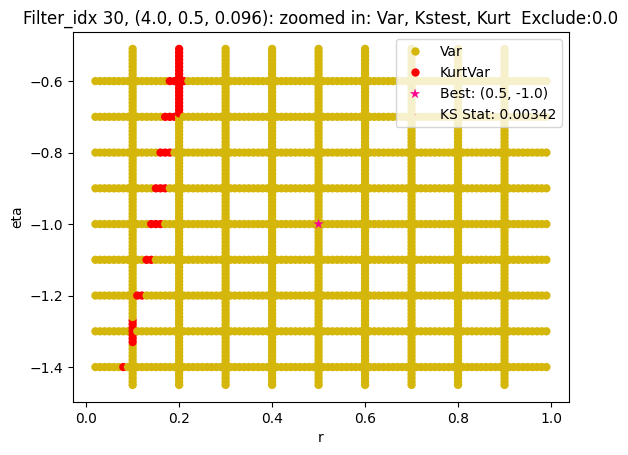

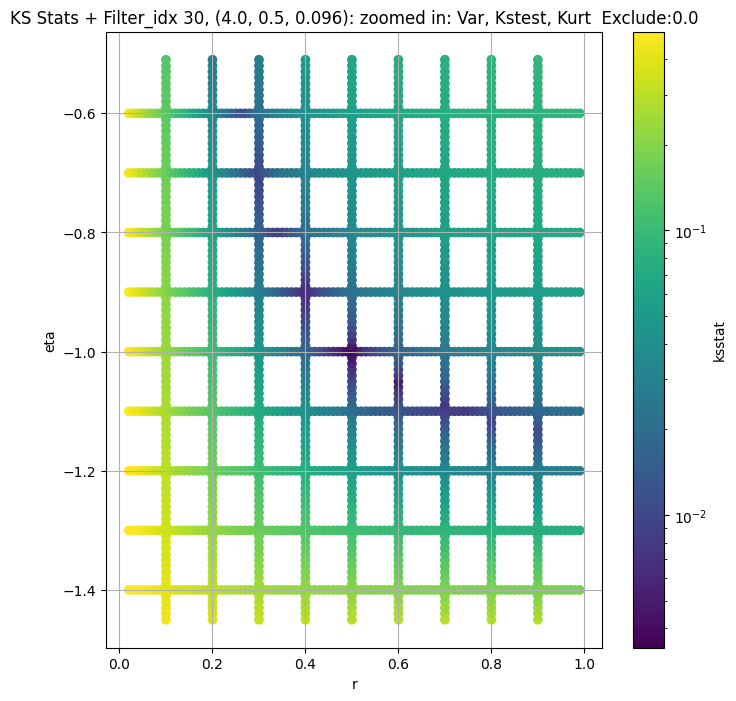

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 31, 0.0 + 100 = 100, ksstat: 0.005953810685608019, var: 2424.19775390625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 31, 0.0 + 75 = 75, ksstat: 0.005692543912001247, var: 2476.64208984375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 31, 0.0 + 50 = 50, ksstat: 0.005179793242341635, var: 2536.174072265625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 31, 0.0 + 25 = 25, ksstat: 0.004524482928709661, var: 2607.696044921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 31, 0.0 + 0 = 0, ksstat: 0.004583666433830236, var: 2739.1923828125
Number of samples: 100000, Without approximation : 65536000.0


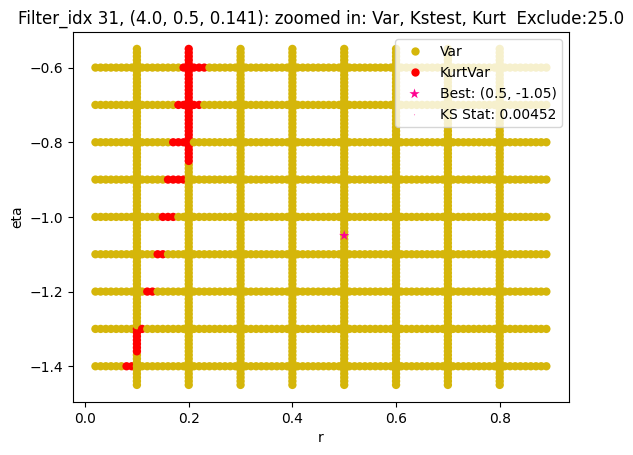

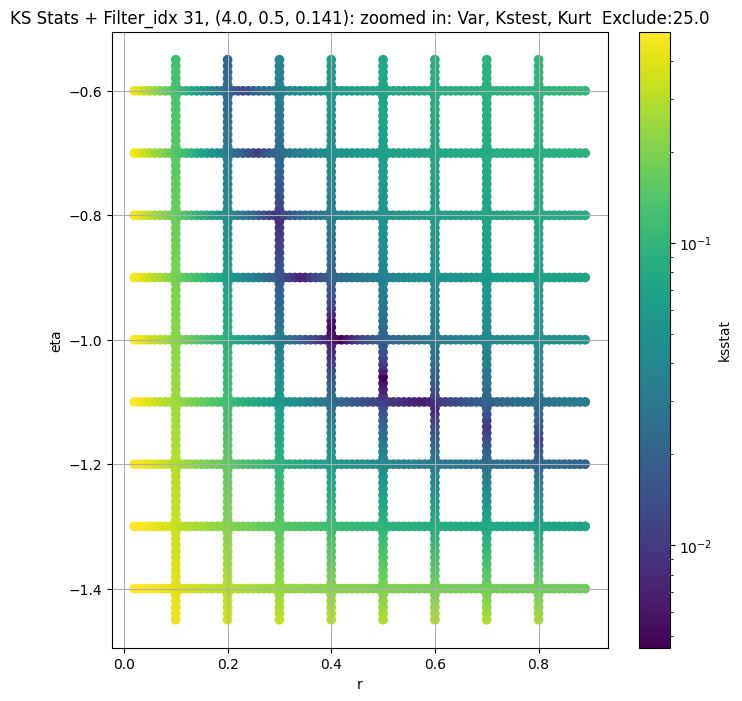

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.004549201335809938, var: 1038.9686279296875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.0040479206771308895, var: 1062.8231201171875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.0036011511699114984, var: 1090.500732421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.0031070570511074758, var: 1124.1796875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.003425710011019767, var: 1188.87451171875
Number of samples: 100000, Without approximation : 65536000.0


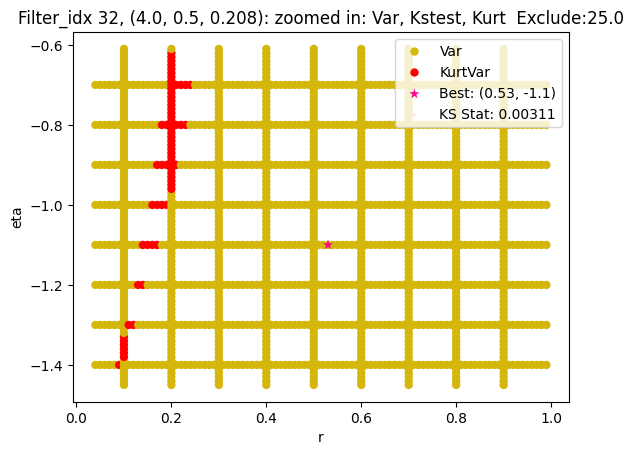

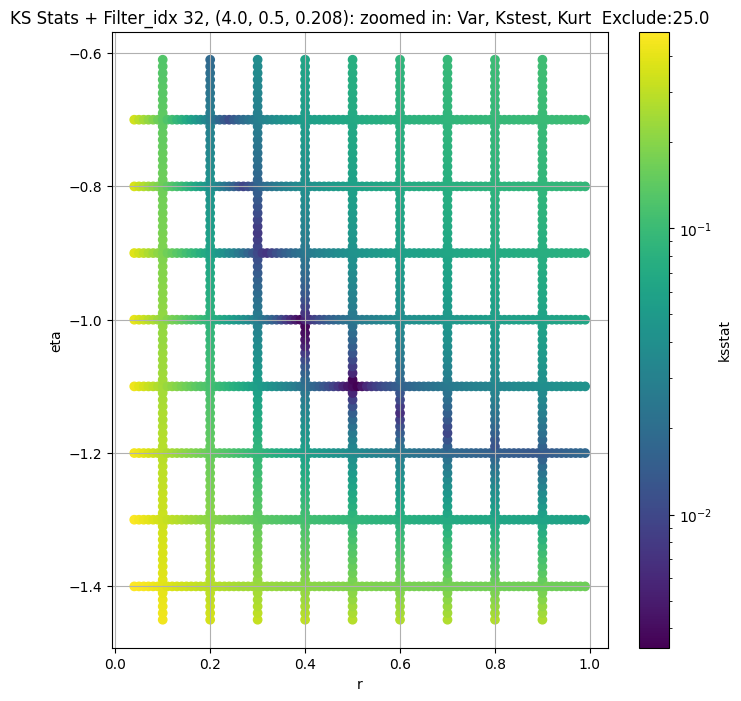

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 100 = 200, ksstat: 0.006291335879800242, var: 447.7275085449219


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 75 = 175, ksstat: 0.005911504343625314, var: 455.7351379394531


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 50 = 150, ksstat: 0.005498533099439484, var: 464.34808349609375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 25 = 125, ksstat: 0.00486346939398119, var: 473.6773986816406


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 0 = 100, ksstat: 0.005012604535419518, var: 483.90716552734375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -25 = 75, ksstat: 0.004981266552359864, var: 495.2983093261719


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -50 = 50, ksstat: 0.004375310685454936, var: 508.3343200683594


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -75 = 25, ksstat: 0.004092070252047386, var: 523.828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -100 = 0, ksstat: 0.003958065106925757, var: 551.6041870117188
Number of samples: 100000, Without approximation : 65536000.0


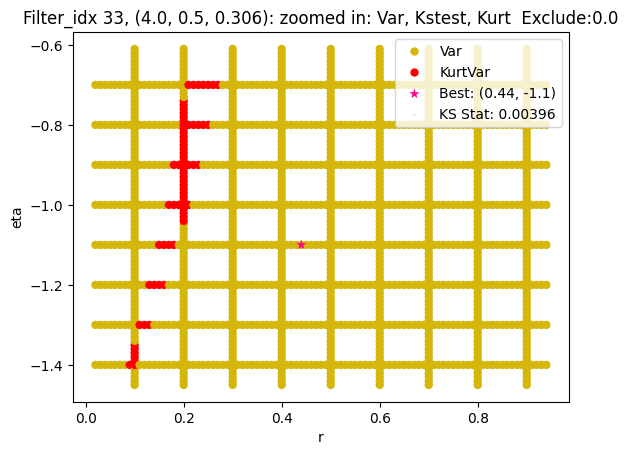

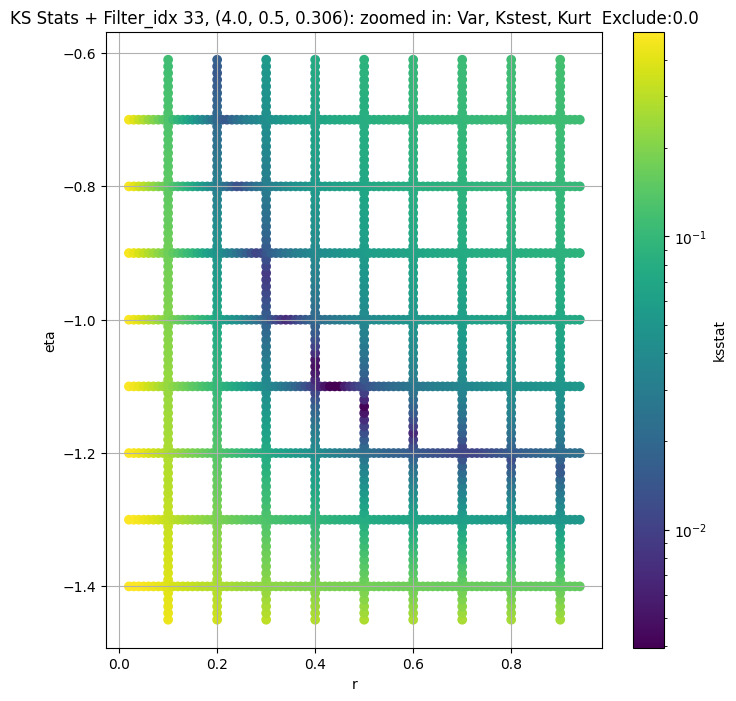

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 100 = 200, ksstat: 0.011170718524772416, var: 211.37164306640625


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 75 = 175, ksstat: 0.010568035129295605, var: 215.3697509765625


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 50 = 150, ksstat: 0.01099577055379386, var: 219.64413452148438


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 25 = 125, ksstat: 0.010729818610540787, var: 224.29653930664062


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 0 = 100, ksstat: 0.011023412866880578, var: 229.43106079101562


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -25 = 75, ksstat: 0.011188688067431118, var: 235.1844024658203


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -50 = 50, ksstat: 0.010925814002528955, var: 241.80160522460938


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -75 = 25, ksstat: 0.011228855905035418, var: 249.80796813964844


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -100 = 0, ksstat: 0.010133504837900875, var: 264.0260009765625
Number of samples: 100000, Without approximation : 65536000.0


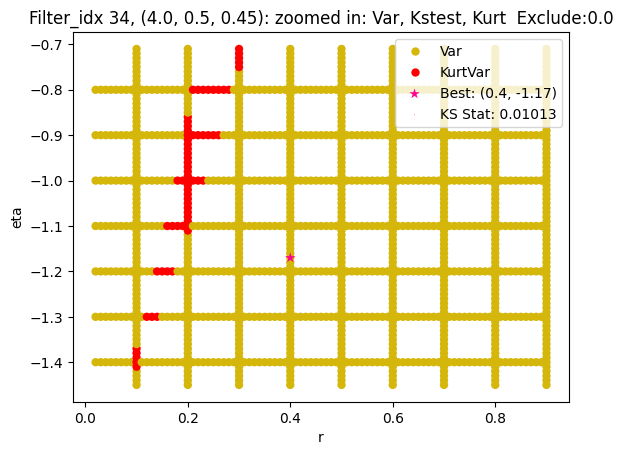

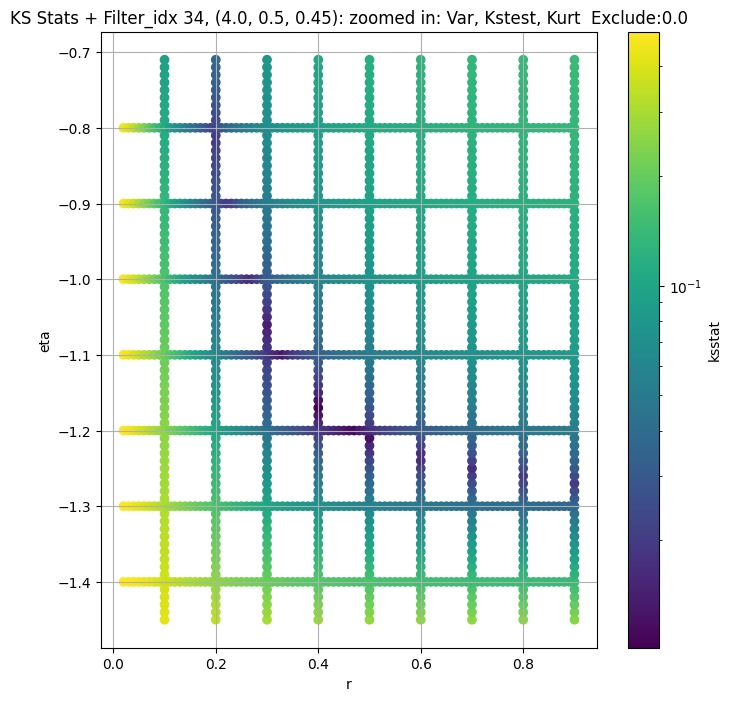

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + 100 = 200, ksstat: 0.004003104348340978, var: 44791.5546875


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + 75 = 175, ksstat: 0.003726685325981305, var: 45539.59375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + 50 = 150, ksstat: 0.0033868119815280047, var: 46339.765625


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + 25 = 125, ksstat: 0.0029436778937314, var: 47202.62109375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + 0 = 100, ksstat: 0.002820799748701086, var: 48141.421875


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + -25 = 75, ksstat: 0.0022976398427534198, var: 49171.95703125


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + -50 = 50, ksstat: 0.0018243835672111866, var: 50316.19140625


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + -75 = 25, ksstat: 0.0016250571058550323, var: 51622.7890625


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 100.0 + -100 = 0, ksstat: 0.0017149704794061638, var: 53505.46484375
Number of samples: 100000, Without approximation : 65536000.0


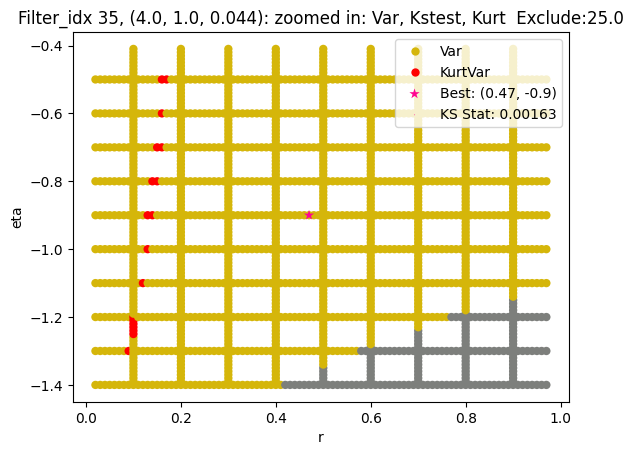

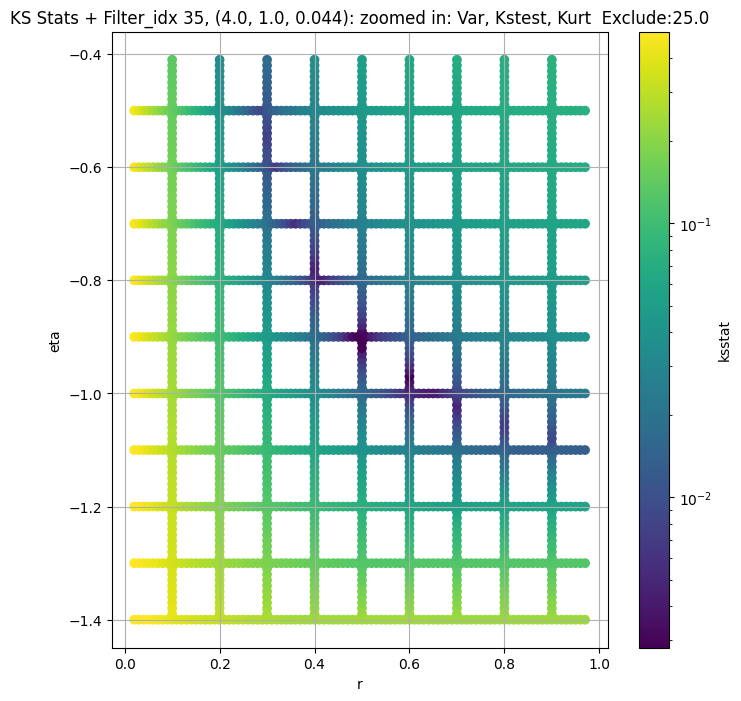

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + 100 = 150, ksstat: 0.0034922309530793783, var: 17420.458984375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + 75 = 125, ksstat: 0.0031242178686084997, var: 17795.57421875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + 50 = 100, ksstat: 0.0031292823157584304, var: 18206.640625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + 25 = 75, ksstat: 0.002711141562409737, var: 18661.6875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + 0 = 50, ksstat: 0.002132254250148402, var: 19174.140625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + -25 = 25, ksstat: 0.0017810664249193753, var: 19773.583984375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 36, 50.0 + -50 = 0, ksstat: 0.0018763933146593859, var: 20815.87109375
Number of samples: 100000, Without approximation : 65536000.0


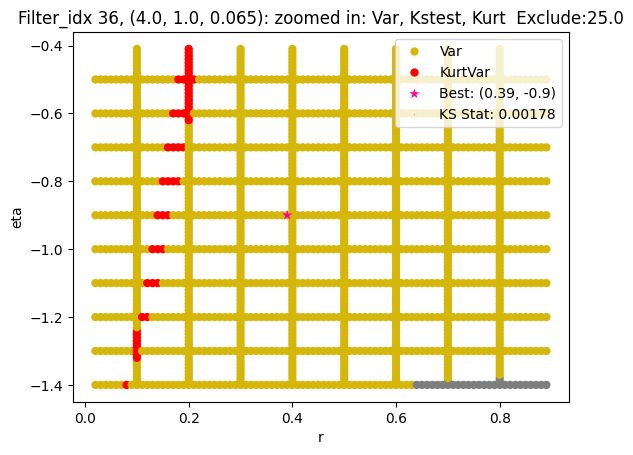

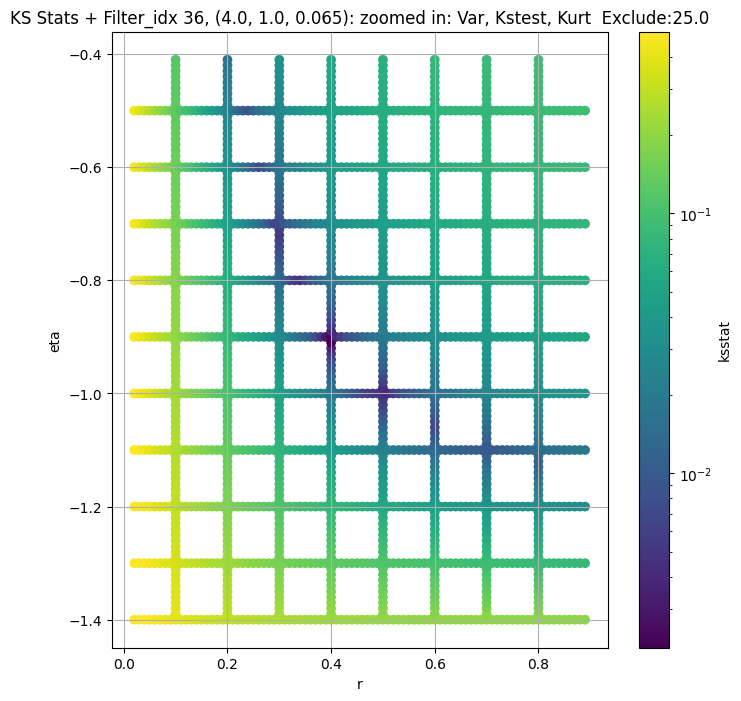

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + 100 = 300, ksstat: 0.005913013508634029, var: 5619.70458984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + 75 = 275, ksstat: 0.005561433036930019, var: 5714.23779296875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + 50 = 250, ksstat: 0.005369151461998234, var: 5814.67333984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + 25 = 225, ksstat: 0.005100576313512791, var: 5921.9208984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + 0 = 200, ksstat: 0.004691921244391516, var: 6037.181640625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + -25 = 175, ksstat: 0.004199484086402583, var: 6161.798828125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + -50 = 150, ksstat: 0.003816882550347289, var: 6297.38623046875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + -75 = 125, ksstat: 0.004042522441072338, var: 6446.1689453125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 37, 200.0 + -100 = 100, ksstat: 0.003444032050818384, var: 6610.97314453125
Number of samples: 100000, Without approximation : 65536000.0


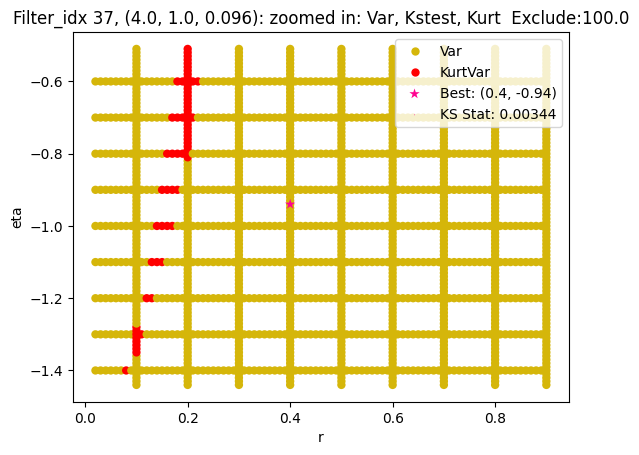

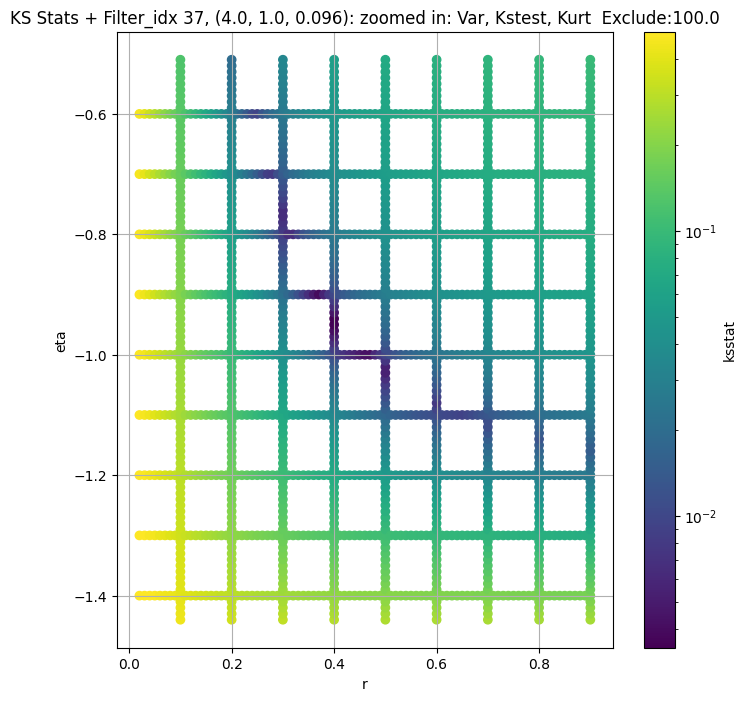

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.0038860898025558574, var: 2476.786376953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.003413264015354356, var: 2540.330322265625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.0029500869479256453, var: 2611.614013671875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.002430978472948375, var: 2692.5498046875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.003027106551321823, var: 2786.4384765625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.0023400174192848566, var: 2899.26220703125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.0017352839639225293, var: 3115.85986328125
Number of samples: 100000, Without approximation : 65536000.0


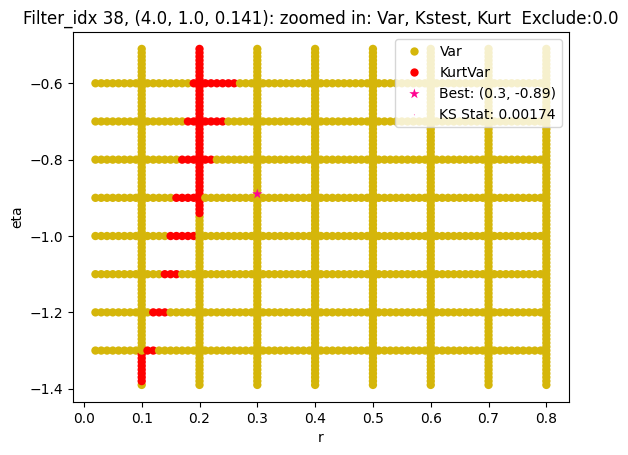

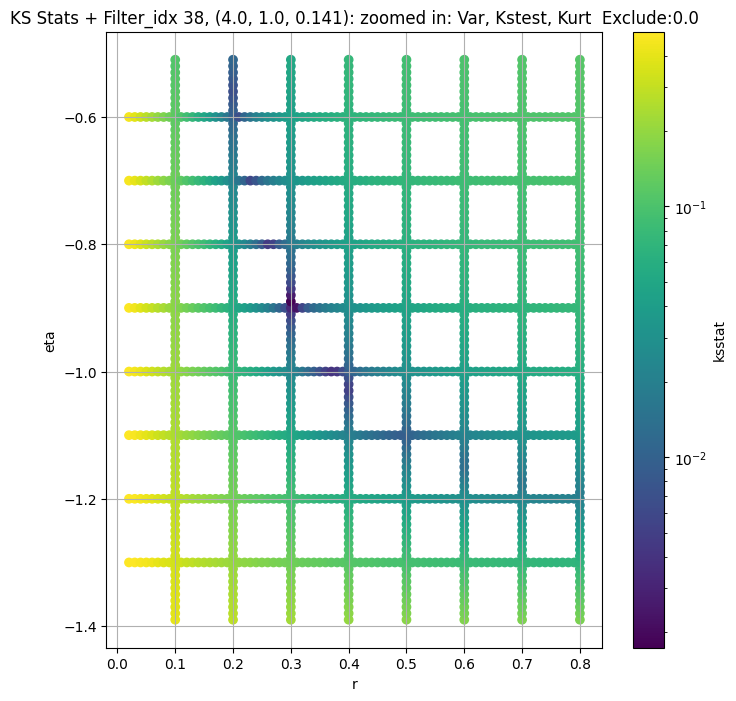

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 100 = 200, ksstat: 0.0040598255782805515, var: 943.1572875976562


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 75 = 175, ksstat: 0.003585969847374363, var: 964.8757934570312


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 50 = 150, ksstat: 0.00311139654464751, var: 988.4100341796875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 25 = 125, ksstat: 0.0031731619632368036, var: 1014.2943725585938


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 0 = 100, ksstat: 0.002687581619757129, var: 1043.1612548828125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -25 = 75, ksstat: 0.002064779990395449, var: 1075.9287109375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -50 = 50, ksstat: 0.0014472520343729034, var: 1114.9027099609375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -75 = 25, ksstat: 0.0015602935229804826, var: 1164.4327392578125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -100 = 0, ksstat: 0.0020085080284509282, var: 1252.18408203125
Number of samples: 100000, Without approximation : 65536000.0


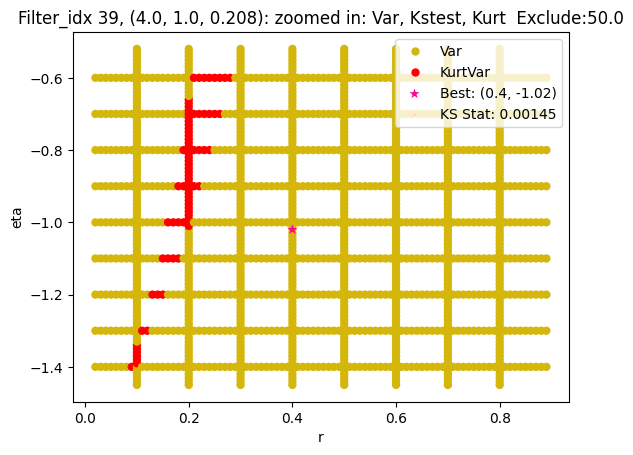

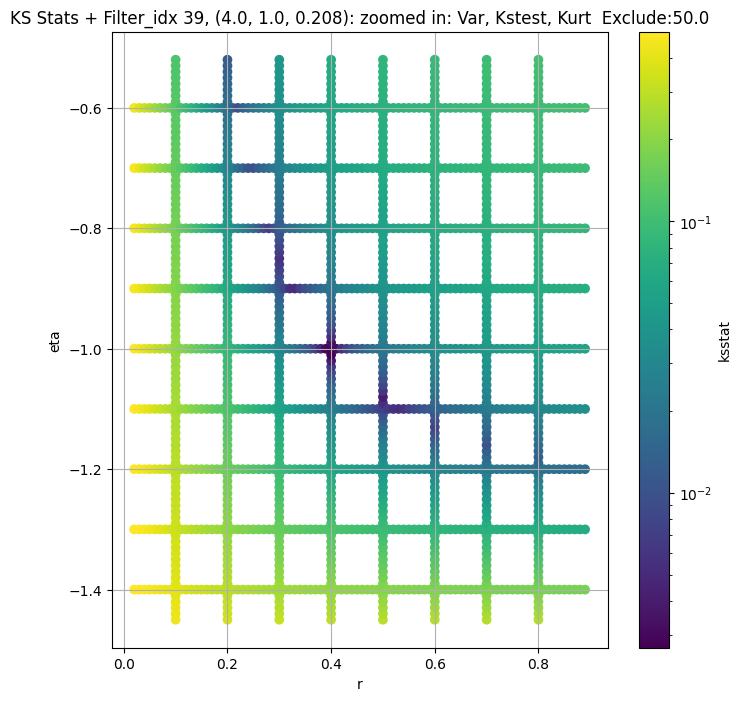

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.0030526715800793802, var: 503.8094177246094


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.003039512707141978, var: 520.4216918945312


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.002995421402625653, var: 540.0801391601562


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.0030838225665119623, var: 564.60888671875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.002971331825110224, var: 610.8795776367188
Number of samples: 100000, Without approximation : 65536000.0


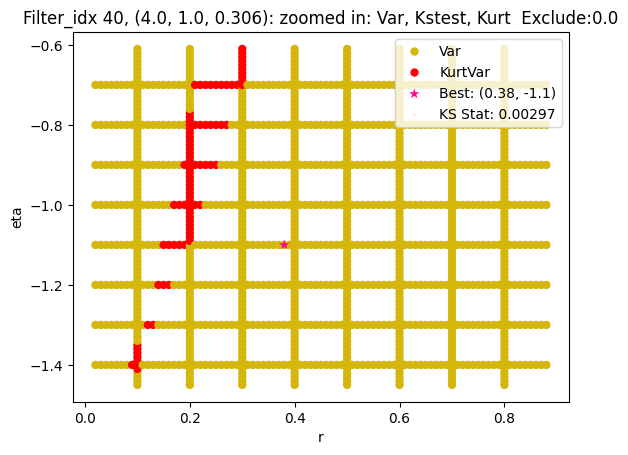

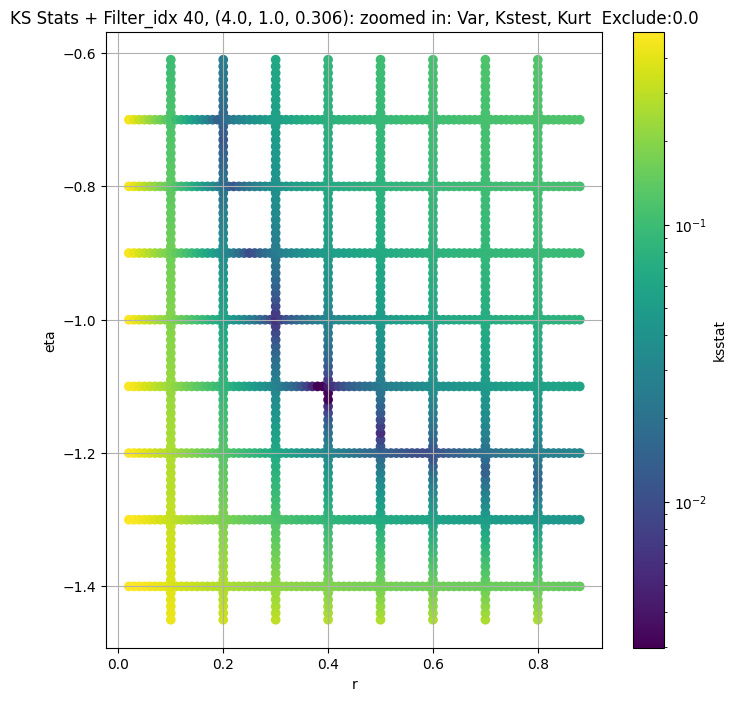

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.008633069898926538, var: 240.50372314453125


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.008102780803690979, var: 248.8896484375


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.008730204054914759, var: 258.91796875


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.008330098252248619, var: 271.55694580078125


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.007879596505848227, var: 292.8568115234375
Number of samples: 100000, Without approximation : 65536000.0


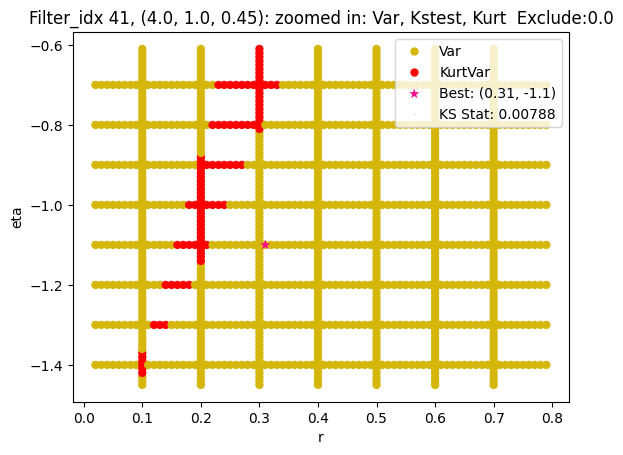

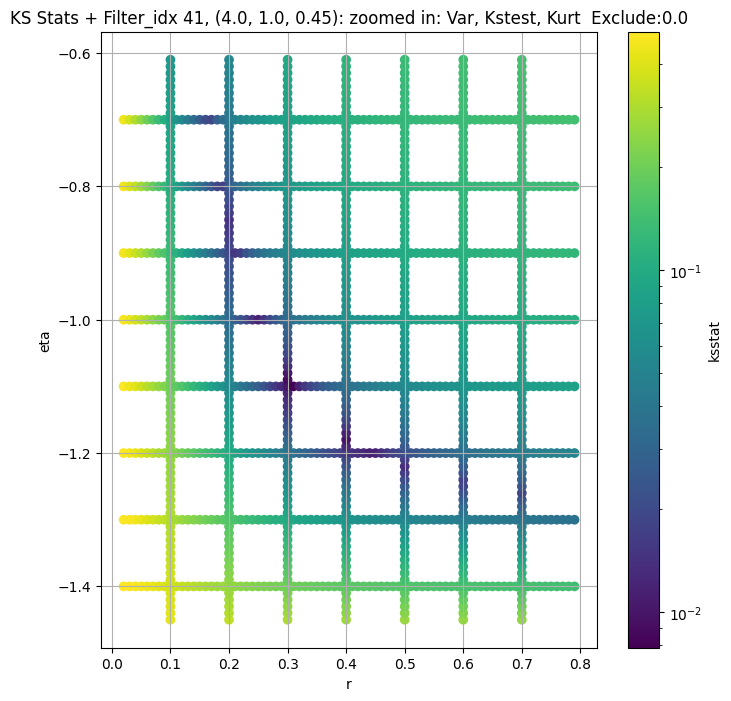

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53297.16400,41834.84000,64967.58000,4.950205,3.020211,9.423482,65536000.0,"(2.0, 0.5, 0.044)",0.007345,...,63612.949124,0.0,53297.164062,0.000168,0.006080,0.80,-1.04,88016.619498,0.0,48000
1,"(2.0, 0.5, 0.065)",19036.11300,14767.14500,24366.29900,6.551415,3.960084,13.359611,65536000.0,"(2.0, 0.5, 0.065)",0.004739,...,36712.009581,0.0,19036.113281,0.000168,0.004115,0.70,-1.07,27227.371874,0.0,108000
2,"(2.0, 0.5, 0.096)",7753.15700,6039.07570,9856.43900,7.599971,4.060136,17.624750,65536000.0,"(2.0, 0.5, 0.096)",0.005868,...,15266.423705,200.0,7181.881836,0.000168,0.004882,0.80,-1.09,13477.354910,100.0,81000
3,"(2.0, 0.5, 0.141)",3045.21600,2303.25980,3915.39140,8.890267,4.886585,21.868956,65536000.0,"(2.0, 0.5, 0.141)",0.004143,...,4513.101591,50.0,3045.216064,0.000168,0.003122,0.60,-1.08,3251.301365,0.0,192000
4,"(2.0, 0.5, 0.208)",1302.08530,960.97577,1655.82240,9.619346,5.580533,23.162615,65536000.0,"(2.0, 0.5, 0.208)",0.004263,...,1403.605408,50.0,1302.085327,0.000168,0.004257,0.56,-1.10,1249.831386,0.0,102514
5,"(2.0, 0.5, 0.306)",512.79870,374.28460,667.93590,11.261219,6.061162,26.931730,65536000.0,"(2.0, 0.5, 0.306)",0.009483,...,301.268556,200.0,427.077515,0.000168,0.009466,0.98,-1.20,1399.421493,225.0,20250
6,"(2.0, 0.5, 0.45)",354.43408,261.12814,466.77124,10.453091,5.964695,24.643680,65536000.0,"(2.0, 0.5, 0.45)",0.010334,...,224.115033,100.0,343.025909,0.000168,0.010303,0.81,-1.20,921.199784,25.0,18000
7,"(2.0, 1.0, 0.044)",72789.00000,58219.42000,91857.51000,6.210428,3.580646,12.645504,65536000.0,"(2.0, 1.0, 0.044)",0.003523,...,86877.473413,0.0,72789.000000,0.000168,0.002443,0.72,-1.00,91635.664949,0.0,324000
8,"(2.0, 1.0, 0.065)",27265.47300,20917.25000,34807.19000,7.633041,4.059375,18.132977,65536000.0,"(2.0, 1.0, 0.065)",0.003025,...,23152.017476,0.0,27265.472656,0.000168,0.002093,0.63,-1.00,26032.286521,0.0,432000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

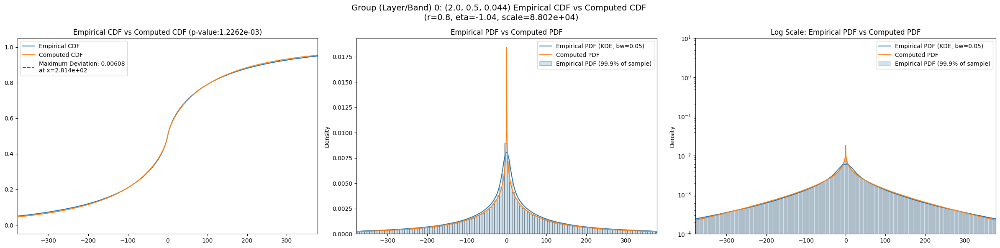

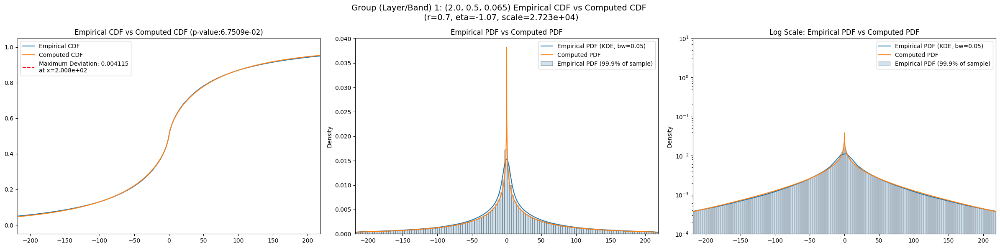

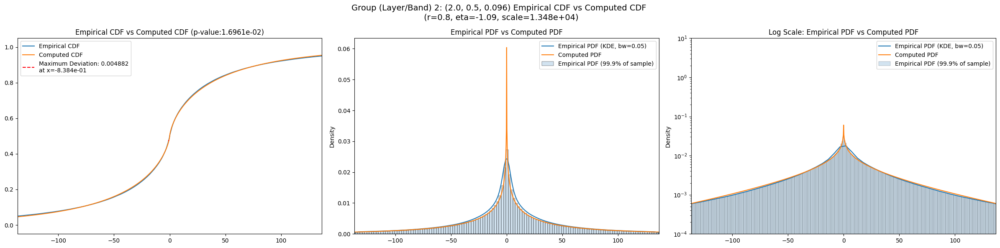

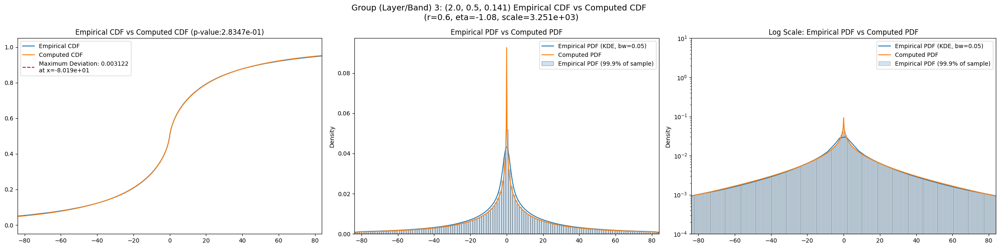

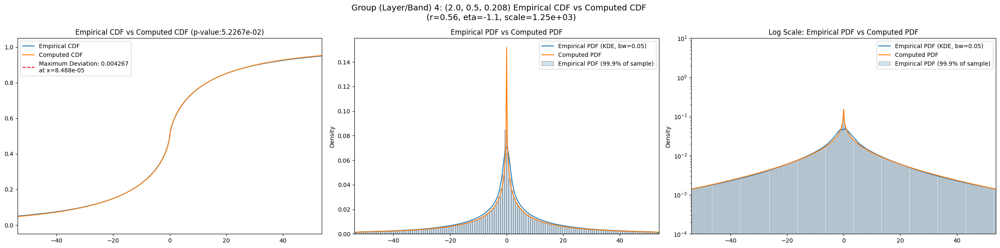

...

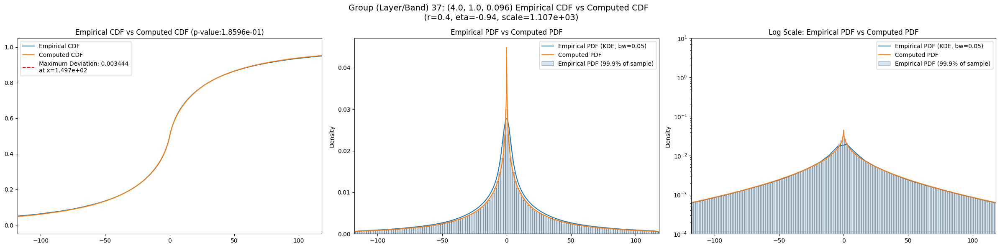

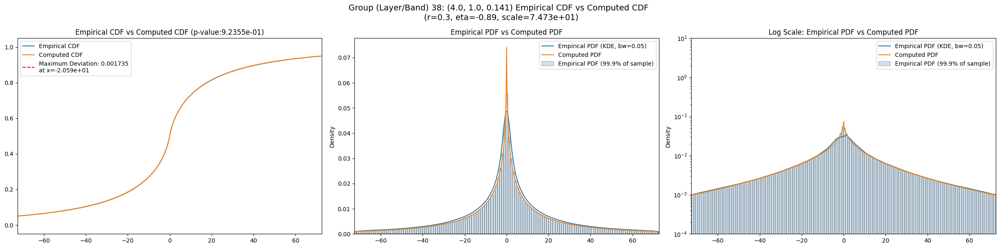

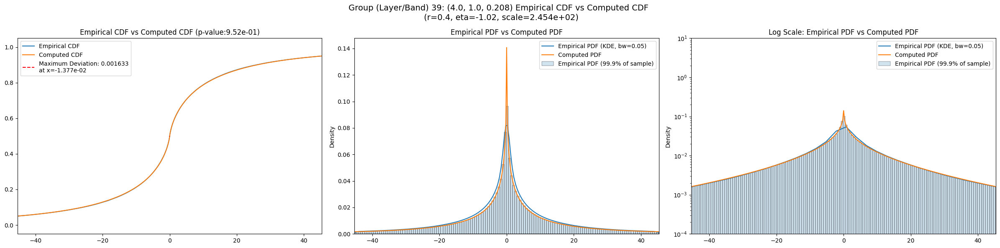

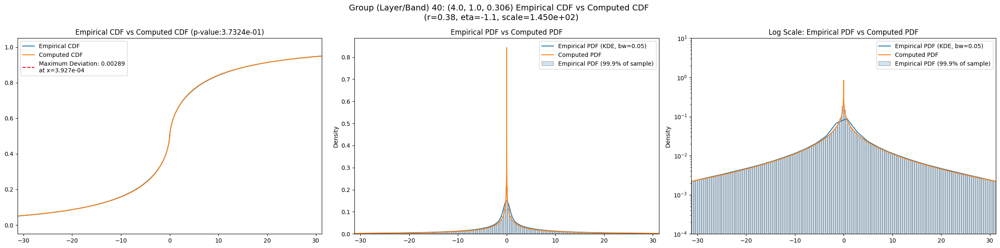

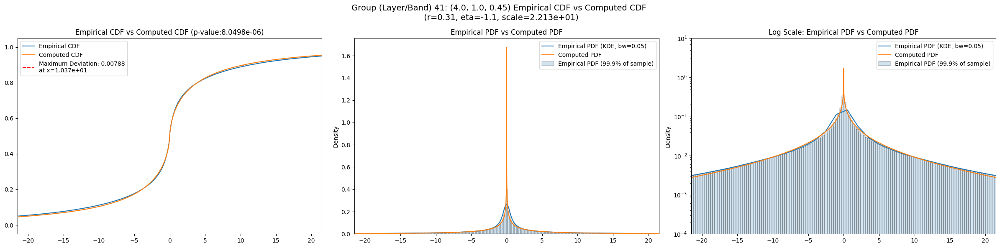

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53297.16400,41834.84000,64967.58000,4.950205,3.020211,9.423482,65536000.0,"(2.0, 0.5, 0.044)",0.007345,...,133.78200,0.062858,0.0,114.47400,0.037306,0.0,90.87800,0.040433,0.0,0.000000e+00
1,"(2.0, 0.5, 0.065)",19036.11300,14767.14500,24366.29900,6.551415,3.960084,13.359611,65536000.0,"(2.0, 0.5, 0.065)",0.004739,...,72.43320,0.066143,0.0,62.07240,0.040724,0.0,48.79980,0.043049,0.0,0.000000e+00
2,"(2.0, 0.5, 0.096)",7753.15700,6039.07570,9856.43900,7.599971,4.060136,17.624750,65536000.0,"(2.0, 0.5, 0.096)",0.005868,...,45.01270,0.066097,0.0,38.65080,0.040640,0.0,30.33350,0.042801,0.0,0.000000e+00
3,"(2.0, 0.5, 0.141)",3045.21600,2303.25980,3915.39140,8.890267,4.886585,21.868956,65536000.0,"(2.0, 0.5, 0.141)",0.004143,...,26.65790,0.068822,0.0,22.83220,0.043675,0.0,17.86740,0.045733,0.0,0.000000e+00
4,"(2.0, 0.5, 0.208)",1302.08530,960.97577,1655.82240,9.619346,5.580533,23.162615,65536000.0,"(2.0, 0.5, 0.208)",0.004263,...,16.59630,0.070331,0.0,14.21640,0.045338,0.0,11.07650,0.047076,0.0,0.000000e+00
5,"(2.0, 0.5, 0.306)",512.79870,374.28460,667.93590,11.261219,6.061162,26.931730,65536000.0,"(2.0, 0.5, 0.306)",0.009483,...,9.11311,0.077718,0.0,7.77885,0.053149,0.0,6.03608,0.054690,0.0,0.000000e+00
6,"(2.0, 0.5, 0.45)",354.43408,261.12814,466.77124,10.453091,5.964695,24.643680,65536000.0,"(2.0, 0.5, 0.45)",0.010334,...,7.53875,0.081092,0.0,6.43559,0.056483,0.0,4.99506,0.058035,0.0,0.000000e+00
7,"(2.0, 1.0, 0.044)",72789.00000,58219.42000,91857.51000,6.210428,3.580646,12.645504,65536000.0,"(2.0, 1.0, 0.044)",0.003523,...,157.51900,0.057236,0.0,134.86200,0.031626,0.0,107.69700,0.035286,0.0,0.000000e+00
8,"(2.0, 1.0, 0.065)",27265.47300,20917.25000,34807.19000,7.633041,4.059375,18.132977,65536000.0,"(2.0, 1.0, 0.065)",0.003025,...,90.80810,0.059388,0.0,77.96950,0.033665,0.0,61.76300,0.036609,0.0,7.112212e-250


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.007345,0.000168,0.006080,0.062858,0.037306,0.040433
1,0.004739,0.000168,0.004115,0.066143,0.040724,0.043049
2,0.005868,0.000168,0.004882,0.066097,0.040640,0.042801
3,0.004143,0.000168,0.003122,0.068822,0.043675,0.045733
4,0.004263,0.000168,0.004257,0.070331,0.045338,0.047076
5,0.009483,0.000168,0.009466,0.077718,0.053149,0.054690
6,0.010334,0.000168,0.010303,0.081092,0.056483,0.058035
7,0.003523,0.000168,0.002443,0.057236,0.031626,0.035286
8,0.003025,0.000168,0.002093,0.059388,0.033665,0.036609


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,53297.164062,0.006080,0.80,-1.04,88016.619498,0.0
1,19036.113281,0.004115,0.70,-1.07,27227.371874,0.0
2,7181.881836,0.004882,0.80,-1.09,13477.354910,100.0
3,3045.216064,0.003122,0.60,-1.08,3251.301365,0.0
4,1302.085327,0.004257,0.56,-1.10,1249.831386,0.0
5,427.077515,0.009466,0.98,-1.20,1399.421493,225.0
6,343.025909,0.010303,0.81,-1.20,921.199784,25.0
7,72789.000000,0.002443,0.72,-1.00,91635.664949,0.0
8,27265.472656,0.002093,0.63,-1.00,26032.286521,0.0
